In [83]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
from datetime import date
import calendar

In [84]:
df=pd.read_csv('energydata_complete.csv',index_col='date',header=0)
df['datetime'] = df.index

In [85]:
df['datetime'] = pd.to_datetime(df['datetime'])
df['day_of_week']=df['datetime'].dt.strftime('%w').astype('int64')
df['month']=df['datetime'].dt.strftime('%m').astype('int64')
df['hour']=df['datetime'].dt.hour
df['day_number']=df['datetime'].dt.day
df['Week_no'] = df['datetime'].dt.strftime('%W').astype('int64')
df['min'] = df['datetime'].dt.minute
df['day_of_week']=df['day_of_week'].apply(str)
df['hour']=df['hour'].apply(str)
df['min']=df['min'].apply(str)
df['period']=df[['day_of_week','hour','min']].apply(lambda x:''.join(x),axis=1)




In [86]:
phase = df.groupby(['date','month','day_of_week','hour','day_number','min','datetime','period']).mean()
phase["Total"]=phase["Appliances"] + phase["lights"]
phase = phase.reset_index()
phase.set_index('date', inplace=True)
#phase['Time'] =  pd.to_datetime(phase['Time'], format='%H:%M:%S')

In [22]:
phase.dtypes

month                   int64
day_of_week            object
hour                   object
day_number              int64
min                    object
datetime       datetime64[ns]
period                  int64
Appliances              int64
lights                  int64
T1                    float64
RH_1                  float64
T2                    float64
RH_2                  float64
T3                    float64
RH_3                  float64
T4                    float64
RH_4                  float64
T5                    float64
RH_5                  float64
T6                    float64
RH_6                  float64
T7                    float64
RH_7                  float64
T8                    float64
RH_8                  float64
T9                    float64
RH_9                  float64
T_out                 float64
Press_mm_hg           float64
RH_out                float64
Windspeed             float64
Visibility            float64
Tdewpoint             float64
rv1       

In [87]:
phase['day_of_week']=phase['day_of_week'].apply(str)

In [88]:
phase['hour']=phase['hour'].apply(str)

In [89]:
phase['min']=phase['min'].apply(str)

In [90]:
phase['period']=phase['period'].apply(int)

In [91]:
phase['period']=phase[['day_of_week','hour','min']].apply(lambda x:''.join(x),axis=1)

In [92]:
phase

,month,day_of_week,hour,day_number,min,datetime,period,Appliances,lights,T1,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Week_no,Total
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,1,1,17,11,0,2016-01-11 17:00:00,1170,60,30,19.890000,...,6.600000,733.500000,92.000000,7.000000,63.000000,5.300000,13.275433,13.275433,2,90
2016-01-11 17:10:00,1,1,17,11,10,2016-01-11 17:10:00,11710,60,30,19.890000,...,6.483333,733.600000,92.000000,6.666667,59.166667,5.200000,18.606195,18.606195,2,90
2016-01-11 17:20:00,1,1,17,11,20,2016-01-11 17:20:00,11720,50,30,19.890000,...,6.366667,733.700000,92.000000,6.333333,55.333333,5.100000,28.642668,28.642668,2,80
2016-01-11 17:30:00,1,1,17,11,30,2016-01-11 17:30:00,11730,50,40,19.890000,...,6.250000,733.800000,92.000000,6.000000,51.500000,5.000000,45.410389,45.410389,2,90
2016-01-11 17:40:00,1,1,17,11,40,2016-01-11 17:40:00,11740,60,40,19.890000,...,6.133333,733.900000,92.000000,5.666667,47.666667,4.900000,10.084097,10.084097,2,100
2016-01-11 17:50:00,1,1,17,11,50,2016-01-11 17:50:00,11750,50,40,19.890000,...,6.016667,734.000000,92.000000,5.333333,43.833333,4.800000,44.919484,44.919484,2,90
2016-01-11 18:00:00,1,1,18,11,0,2016-01-11 18:00:00,1180,60,50,19.890000,...,5.900000,734.100000,92.000000,5.000000,40.000000,4.700000,47.233763,47.233763,2,110
2016-01-11 18:10:00,1,1,18,11,10,2016-01-11 18:10:00,11810,60,50,19.856667,...,5.916667,734.166667,91.833333,5.166667,40.000000,4.683333,33.039890,33.039890,2,110
2016-01-11 18:20:00,1,1,18,11,20,2016-01-11 18:20:00,11820,60,40,19.790000,...,5.933333,734.233333,91.666667,5.333333,40.000000,4.666667,31.455702,31.455702,2,100


In [93]:
phase.index

Index(['2016-01-11 17:00:00', '2016-01-11 17:10:00', '2016-01-11 17:20:00',
       '2016-01-11 17:30:00', '2016-01-11 17:40:00', '2016-01-11 17:50:00',
       '2016-01-11 18:00:00', '2016-01-11 18:10:00', '2016-01-11 18:20:00',
       '2016-01-11 18:30:00',
       ...
       '2016-05-27 16:30:00', '2016-05-27 16:40:00', '2016-05-27 16:50:00',
       '2016-05-27 17:00:00', '2016-05-27 17:10:00', '2016-05-27 17:20:00',
       '2016-05-27 17:30:00', '2016-05-27 17:40:00', '2016-05-27 17:50:00',
       '2016-05-27 18:00:00'],
      dtype='object', name='date', length=19735)

TypeError: unsupported operand type(s) for /: 'str' and 'int'

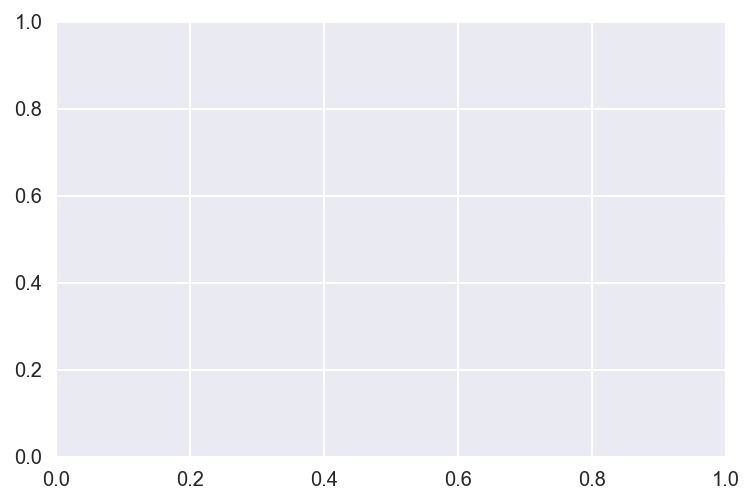

In [94]:
sns.distplot(phase['period'])

In [8]:
import matplotlib.pylab as py
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6
ts = phase['Appliances']
ts['2016-01-11 17:00:00':'2016-02-01 00:00:00']

date
2016-01-11 17:00:00     60
2016-01-11 17:10:00     60
2016-01-11 17:20:00     50
2016-01-11 17:30:00     50
2016-01-11 17:40:00     60
2016-01-11 17:50:00     50
2016-01-11 18:00:00     60
2016-01-11 18:10:00     60
2016-01-11 18:20:00     60
2016-01-11 18:30:00     70
2016-01-11 18:40:00    230
2016-01-11 18:50:00    580
2016-01-11 19:00:00    430
2016-01-11 19:10:00    250
2016-01-11 19:20:00    100
2016-01-11 19:30:00    100
2016-01-11 19:40:00     90
2016-01-11 19:50:00     70
2016-01-11 20:00:00     80
2016-01-11 20:10:00    140
2016-01-11 20:20:00    120
2016-01-11 20:30:00    190
2016-01-11 20:40:00    110
2016-01-11 20:50:00    110
2016-01-11 21:00:00    110
2016-01-11 21:10:00    110
2016-01-11 21:20:00    100
2016-01-11 21:30:00    100
2016-01-11 21:40:00    100
2016-01-11 21:50:00    100
                      ... 
2016-01-31 19:10:00     80
2016-01-31 19:20:00     90
2016-01-31 19:30:00    130
2016-01-31 19:40:00    130
2016-01-31 19:50:00    140
2016-01-31 20:00:00    

In [9]:
phase

,month,day_of_week,hour,day_number,Time,datetime,Appliances,lights,T1,RH_1,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Week_no,Total
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,1,1,17,11,1900-01-01 17:00:00,2016-01-11 17:00:00,60,30,19.890000,47.596667,...,6.600000,733.500000,92.000000,7.000000,63.000000,5.300000,13.275433,13.275433,2,90
2016-01-11 17:10:00,1,1,17,11,1900-01-01 17:10:00,2016-01-11 17:10:00,60,30,19.890000,46.693333,...,6.483333,733.600000,92.000000,6.666667,59.166667,5.200000,18.606195,18.606195,2,90
2016-01-11 17:20:00,1,1,17,11,1900-01-01 17:20:00,2016-01-11 17:20:00,50,30,19.890000,46.300000,...,6.366667,733.700000,92.000000,6.333333,55.333333,5.100000,28.642668,28.642668,2,80
2016-01-11 17:30:00,1,1,17,11,1900-01-01 17:30:00,2016-01-11 17:30:00,50,40,19.890000,46.066667,...,6.250000,733.800000,92.000000,6.000000,51.500000,5.000000,45.410389,45.410389,2,90
2016-01-11 17:40:00,1,1,17,11,1900-01-01 17:40:00,2016-01-11 17:40:00,60,40,19.890000,46.333333,...,6.133333,733.900000,92.000000,5.666667,47.666667,4.900000,10.084097,10.084097,2,100
2016-01-11 17:50:00,1,1,17,11,1900-01-01 17:50:00,2016-01-11 17:50:00,50,40,19.890000,46.026667,...,6.016667,734.000000,92.000000,5.333333,43.833333,4.800000,44.919484,44.919484,2,90
2016-01-11 18:00:00,1,1,18,11,1900-01-01 18:00:00,2016-01-11 18:00:00,60,50,19.890000,45.766667,...,5.900000,734.100000,92.000000,5.000000,40.000000,4.700000,47.233763,47.233763,2,110
2016-01-11 18:10:00,1,1,18,11,1900-01-01 18:10:00,2016-01-11 18:10:00,60,50,19.856667,45.560000,...,5.916667,734.166667,91.833333,5.166667,40.000000,4.683333,33.039890,33.039890,2,110
2016-01-11 18:20:00,1,1,18,11,1900-01-01 18:20:00,2016-01-11 18:20:00,60,40,19.790000,45.597500,...,5.933333,734.233333,91.666667,5.333333,40.000000,4.666667,31.455702,31.455702,2,100


# Univariate Analysis

## Appliances

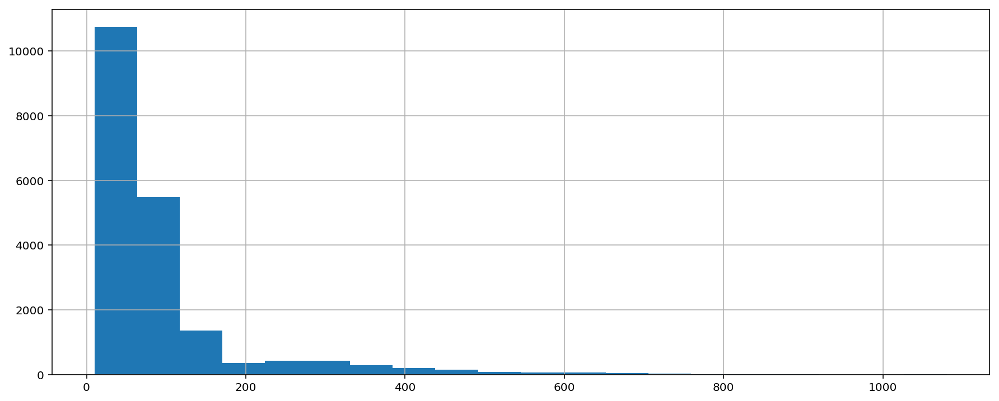

In [10]:
phase['Appliances'].hist(bins=20)

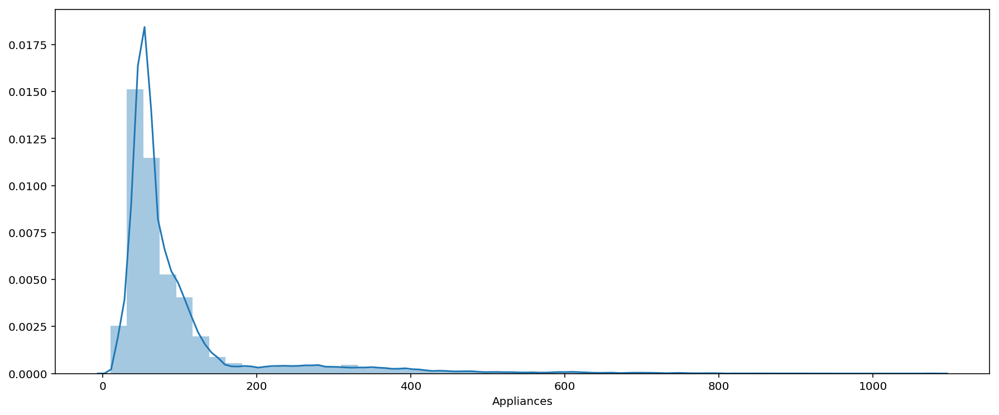

In [11]:
sns.distplot(phase['Appliances'])

## lights

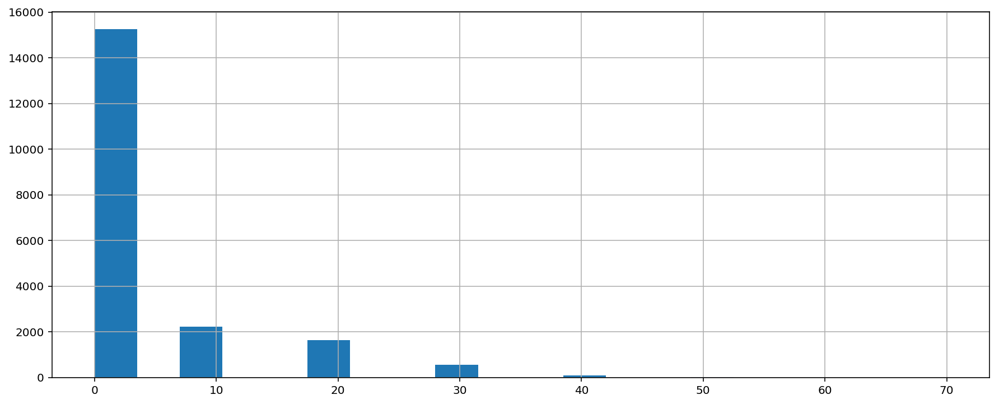

In [12]:
phase['lights'].hist(bins=20)


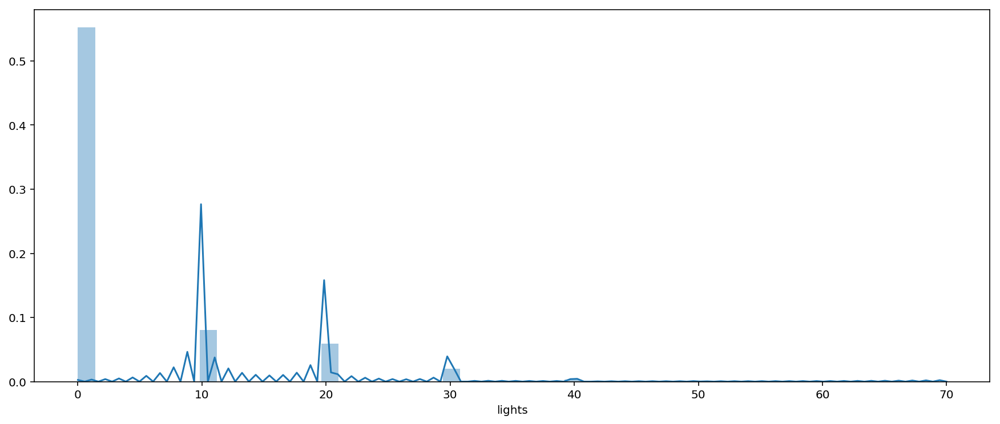

In [13]:
sns.distplot(phase['lights'])

## Total

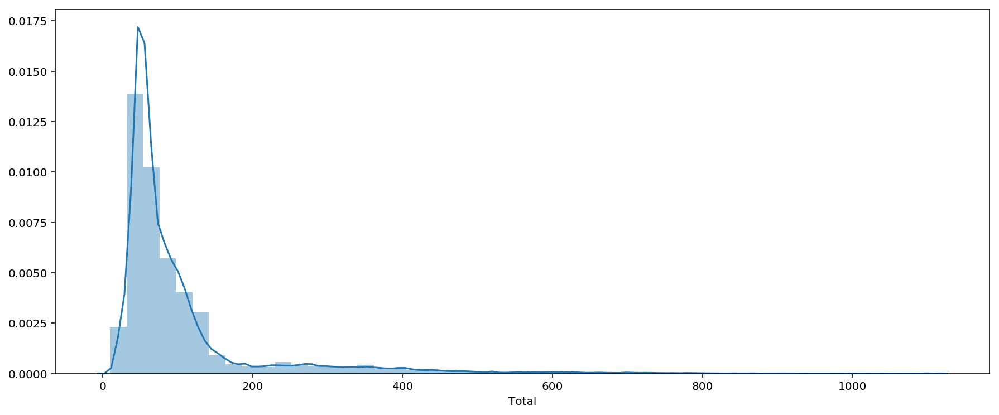

In [14]:
sns.distplot(phase['Total'])

# Period 

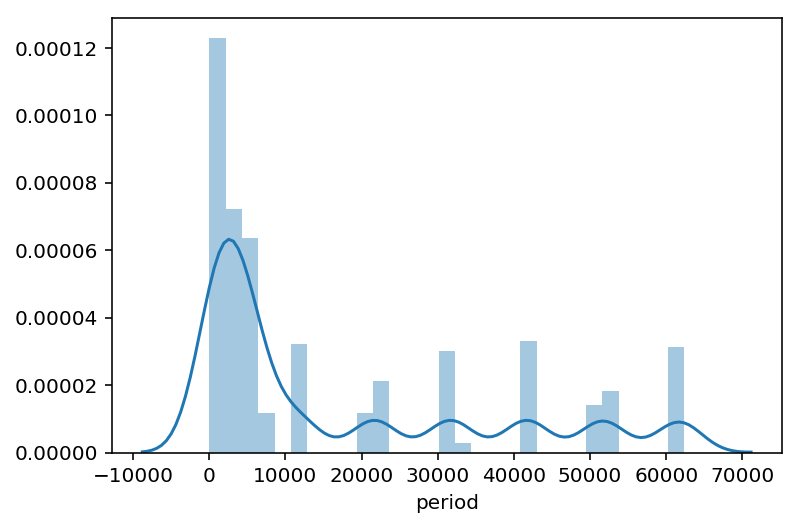

In [72]:
sns.distplot(phase['period'])

## T1 RH_1

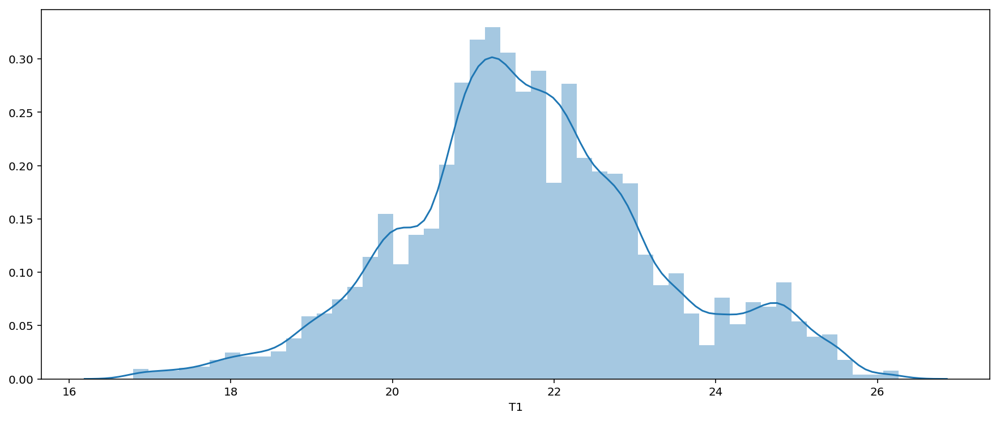

In [15]:
sns.distplot(phase['T1'])

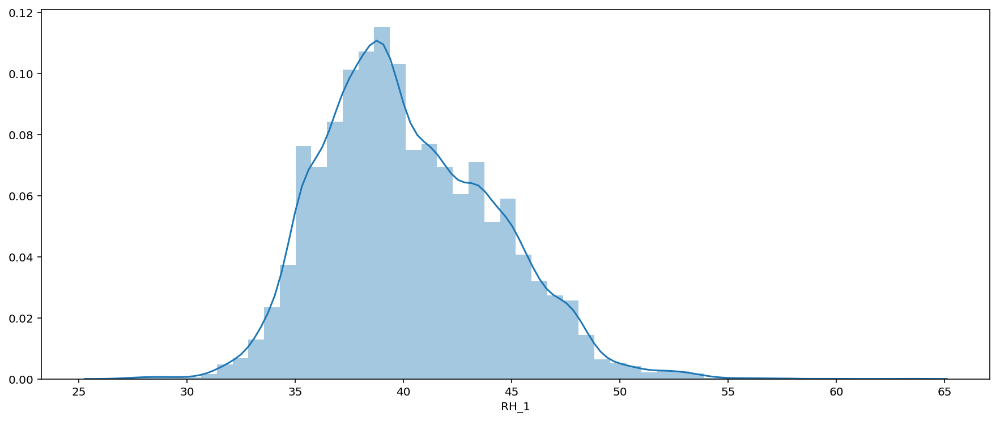

In [16]:
sns.distplot(phase['RH_1'])

## T2 RH_2

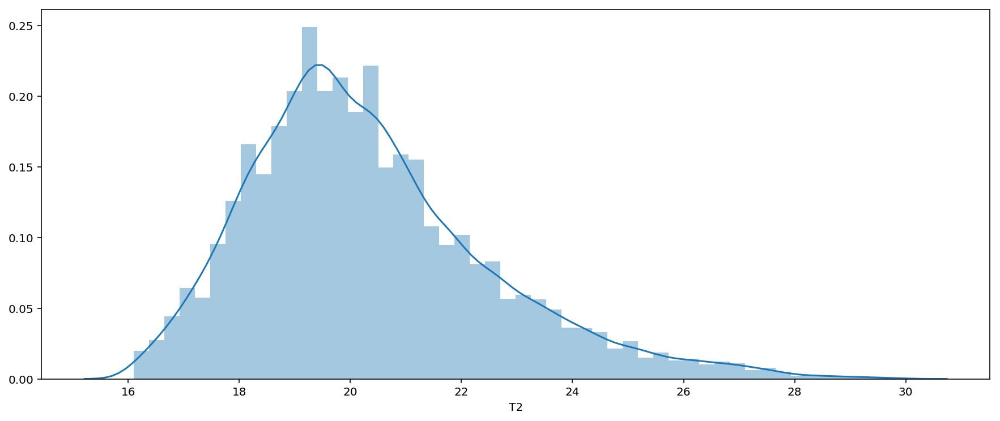

In [17]:
sns.distplot(phase['T2'])

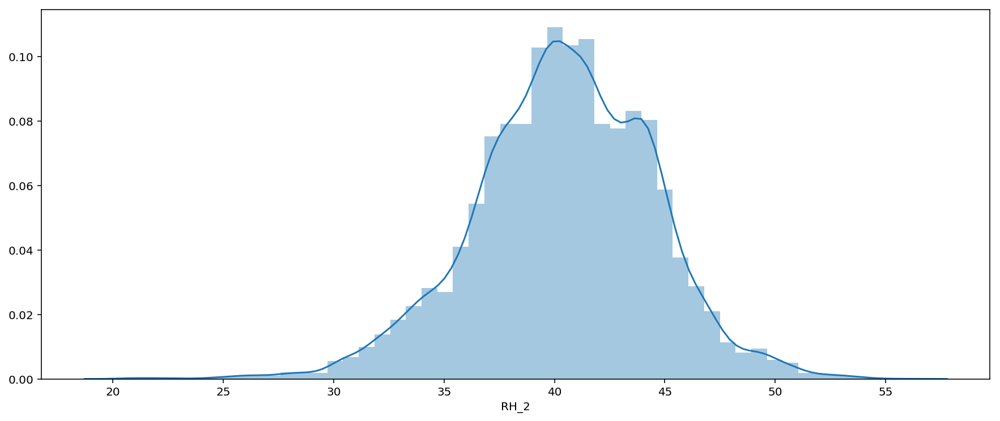

In [18]:
sns.distplot(phase['RH_2'])

## T3 RH_3

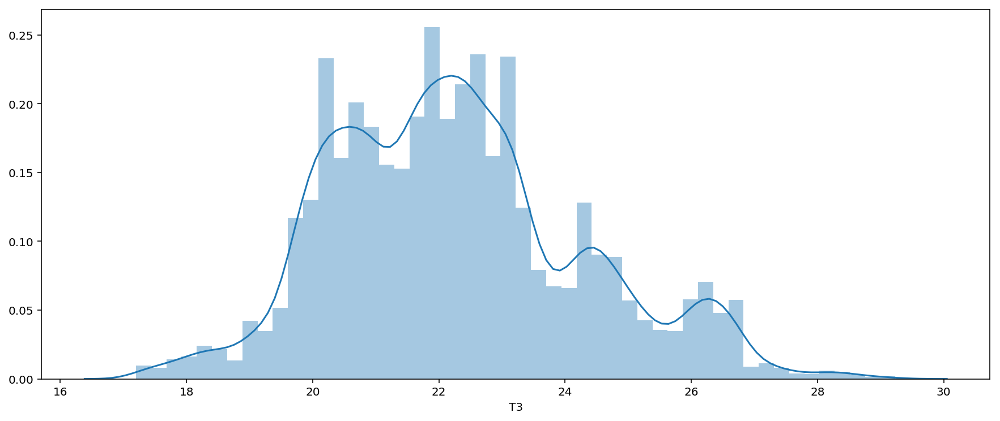

In [19]:
sns.distplot(phase['T3'])

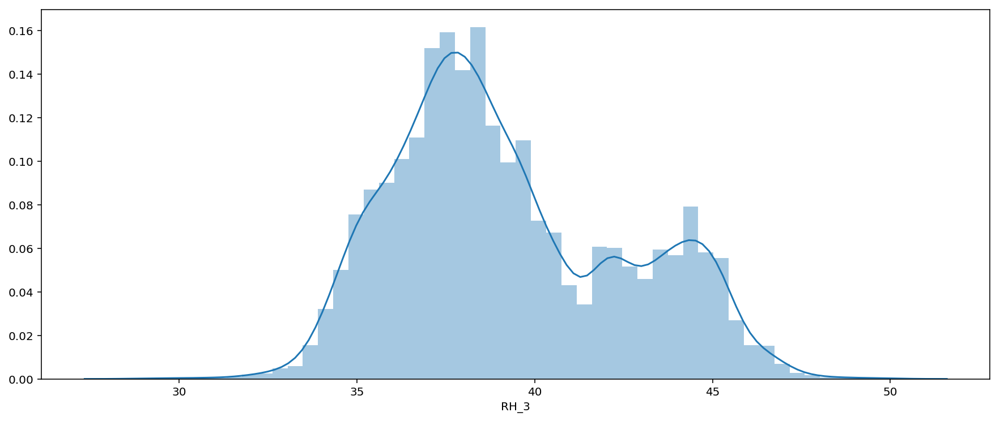

In [20]:
sns.distplot(phase['RH_3'])

## T4 RH_4

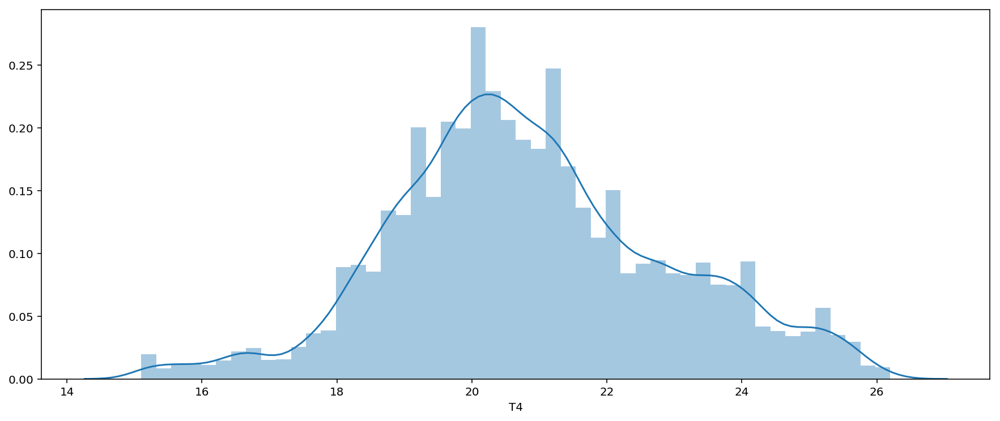

In [21]:
sns.distplot(phase['T4'])

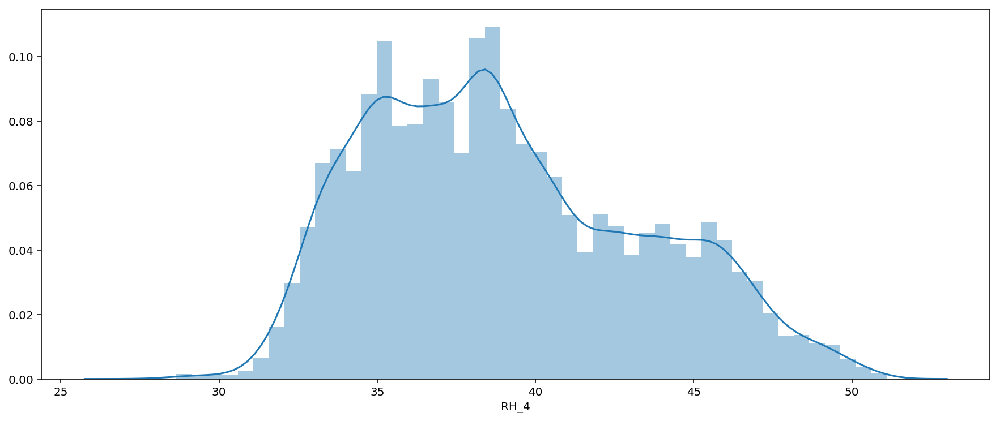

In [22]:
sns.distplot(phase['RH_4'])

## T5 RH_5

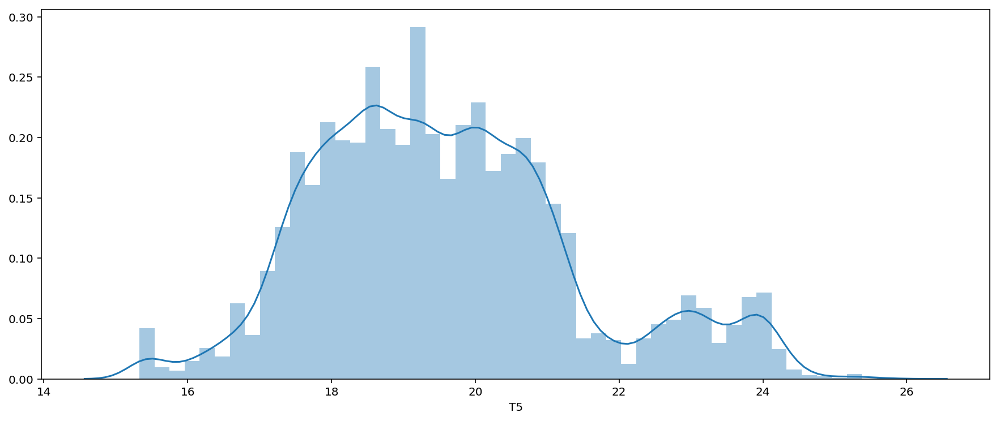

In [23]:
sns.distplot(phase['T5'])

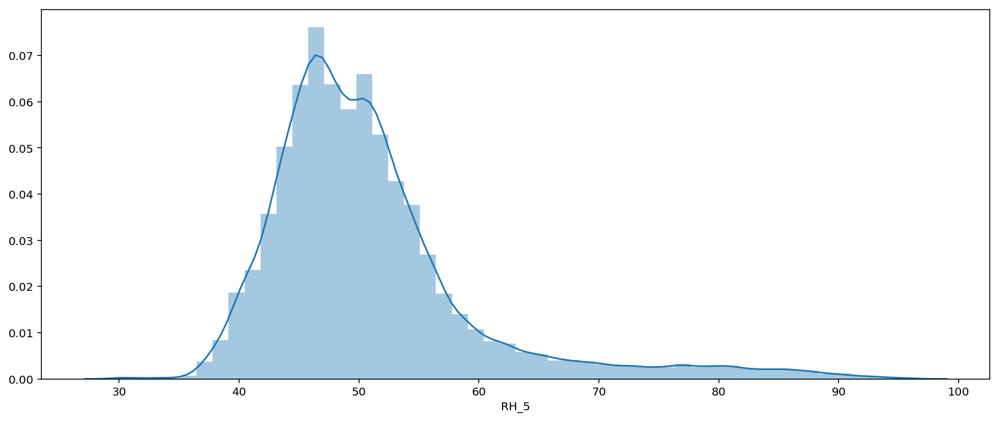

In [24]:
sns.distplot(phase['RH_5'])

## T6 RH_6

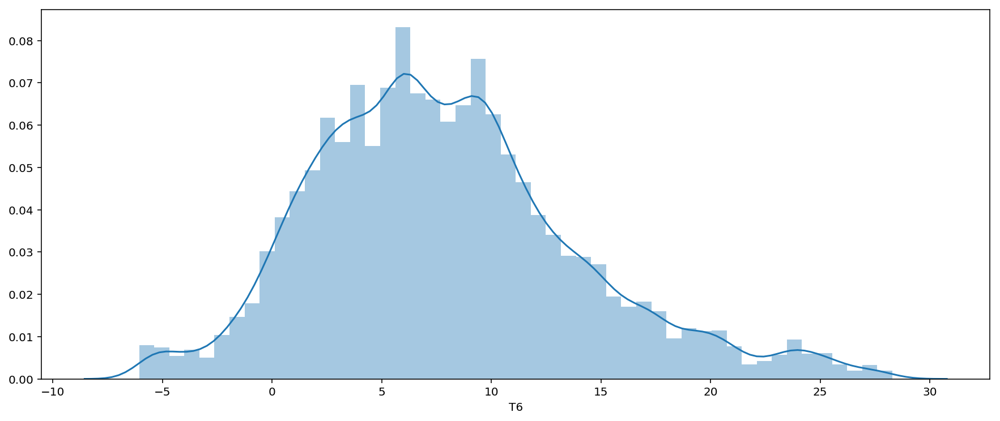

In [25]:
sns.distplot(phase['T6'])

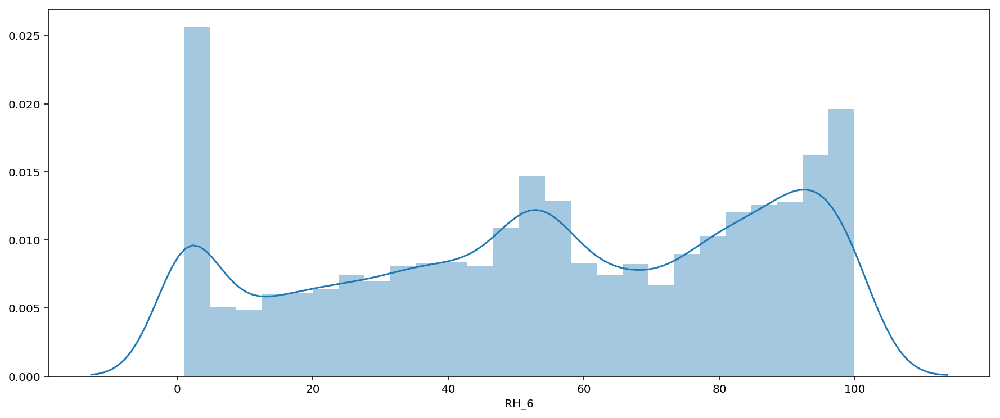

In [26]:
sns.distplot(phase['RH_6'])

## T7 RH_7

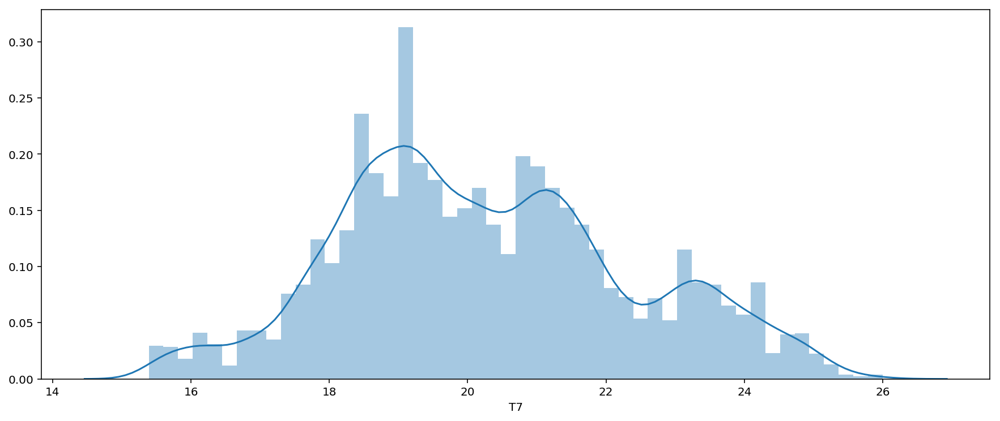

In [27]:
sns.distplot(phase['T7'])

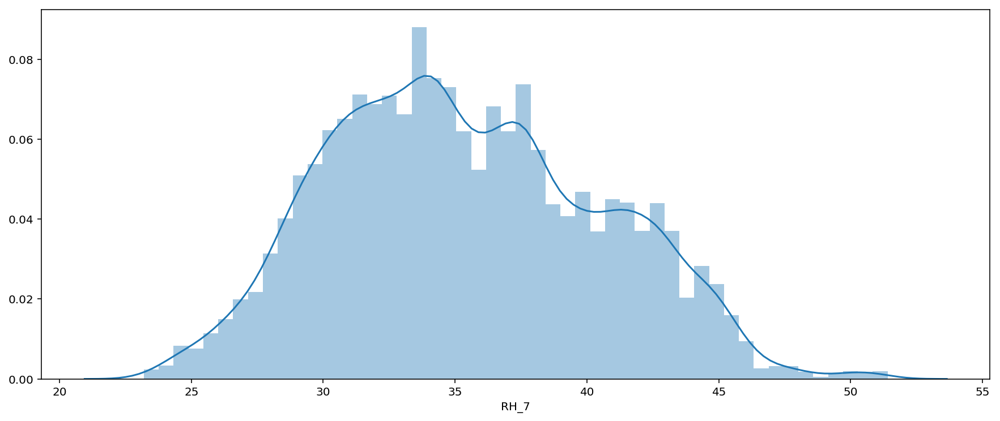

In [28]:
sns.distplot(phase['RH_7'])

## T8 RH_8

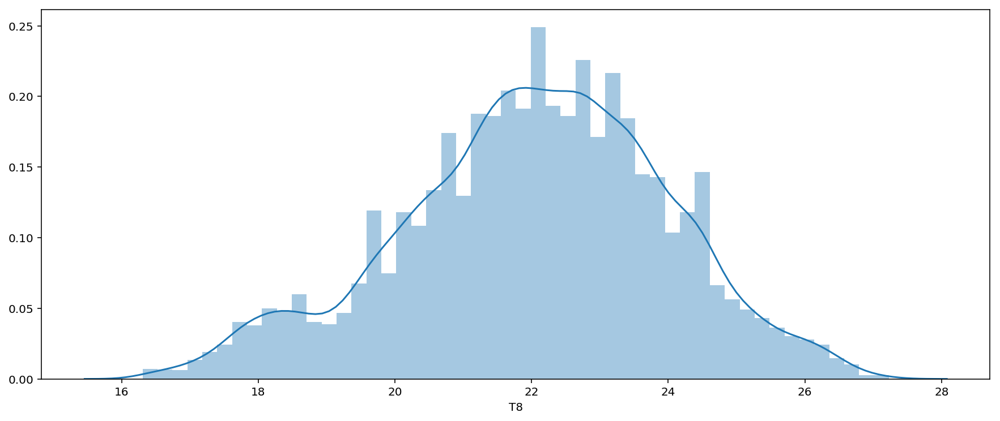

In [29]:
sns.distplot(phase['T8'])

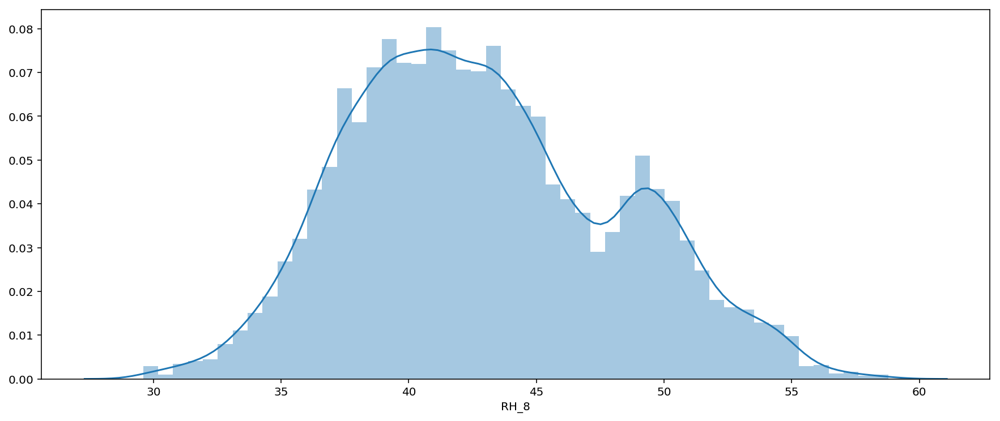

In [30]:
sns.distplot(phase['RH_8'])

## T9 RH_9

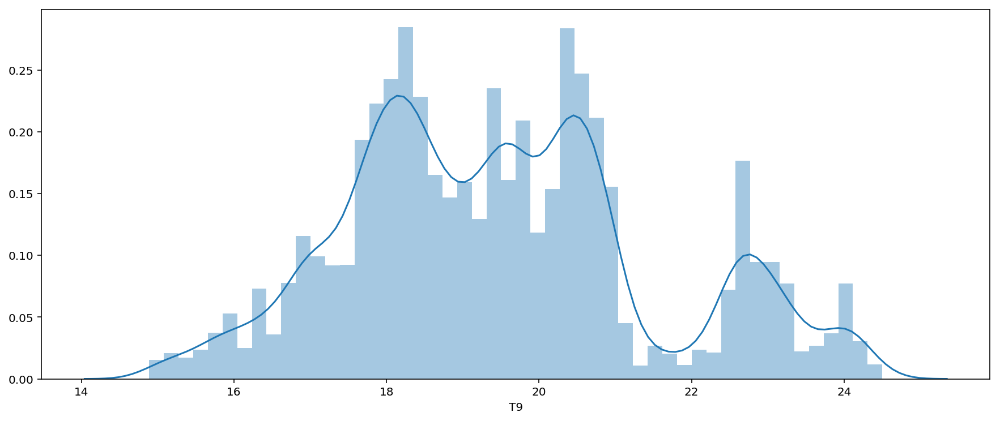

In [31]:
sns.distplot(phase['T9'])

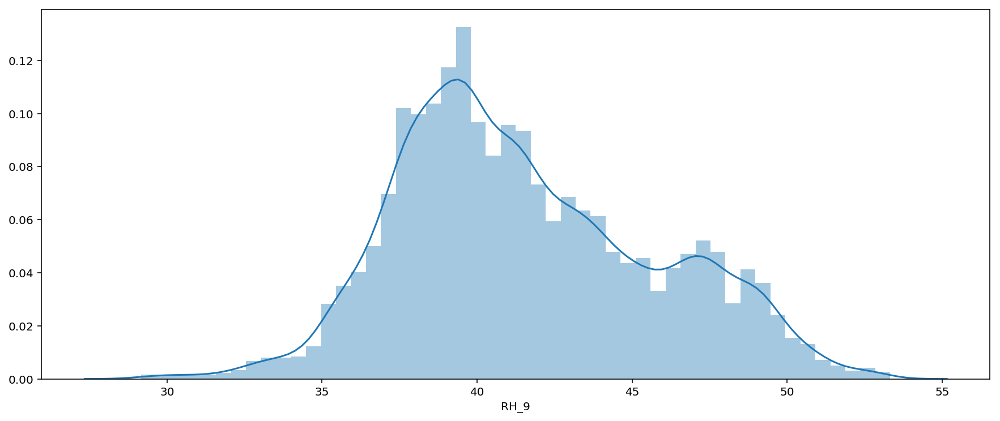

In [32]:
sns.distplot(phase['RH_9'])

## T_out RH_out

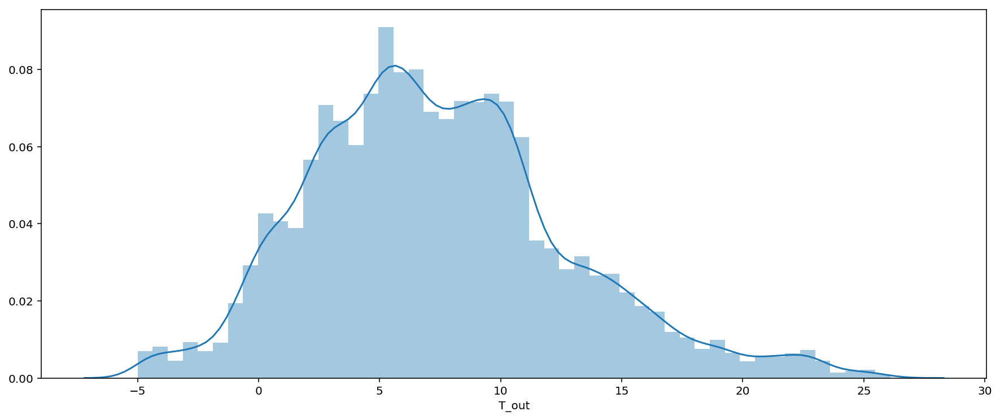

In [33]:
sns.distplot(phase['T_out'])

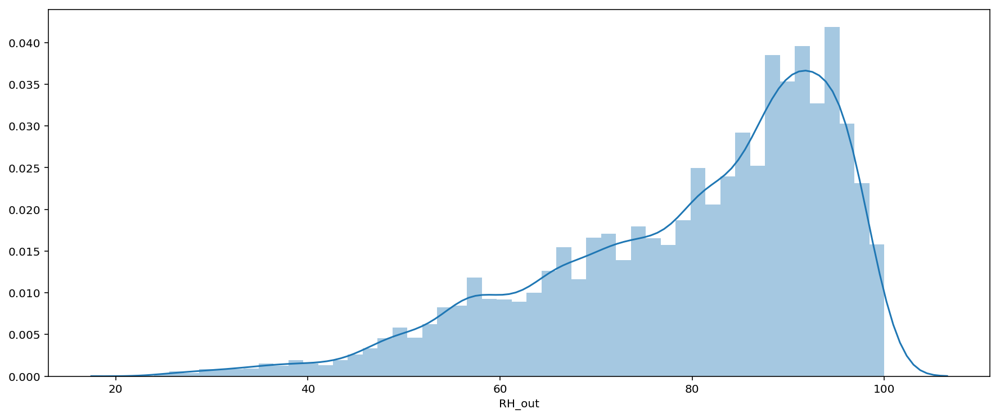

In [34]:
sns.distplot(phase['RH_out'])

## Press_mm_hg

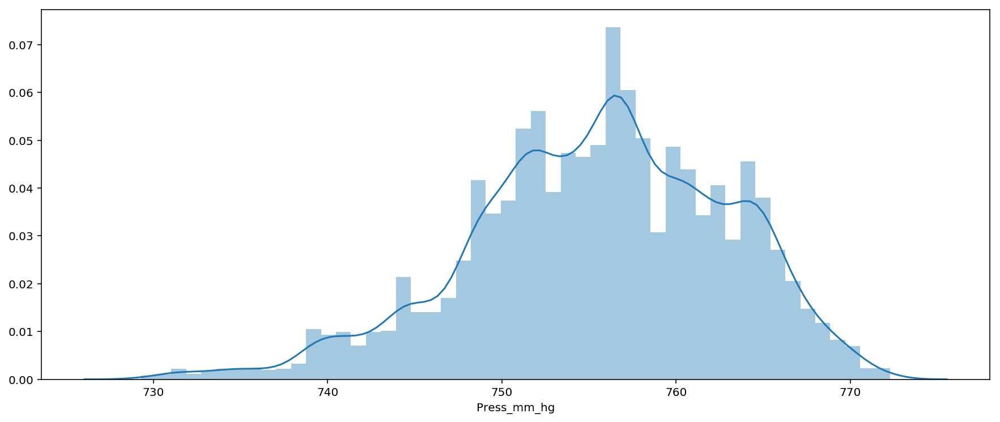

In [35]:
sns.distplot(phase['Press_mm_hg'])

##  Visibility

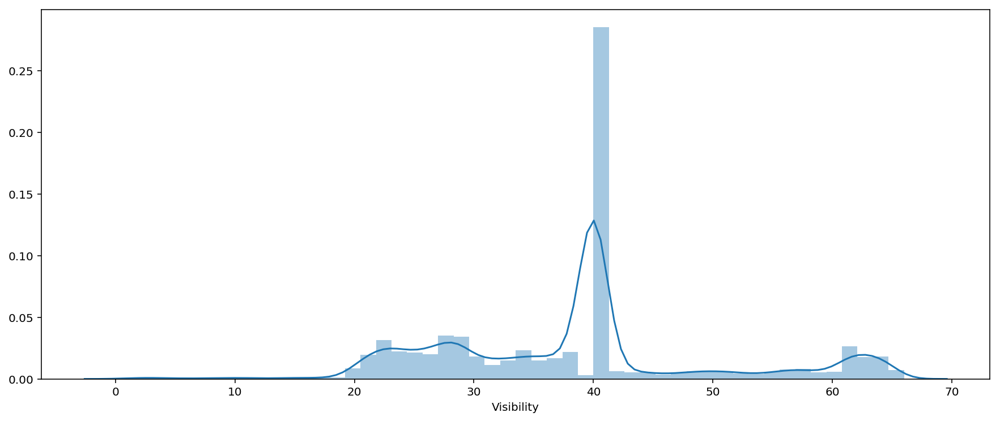

In [36]:
sns.distplot(phase['Visibility'])

## Windspeed

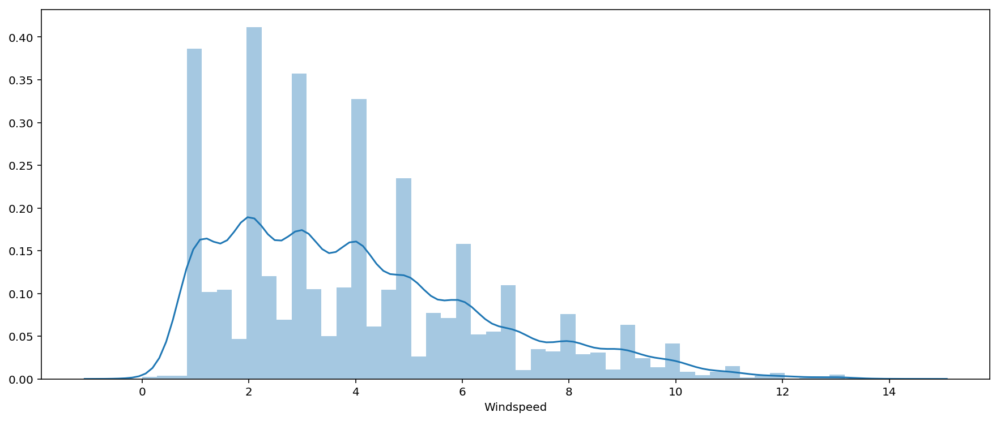

In [37]:
sns.distplot(phase['Windspeed'])

## Tdewpoint

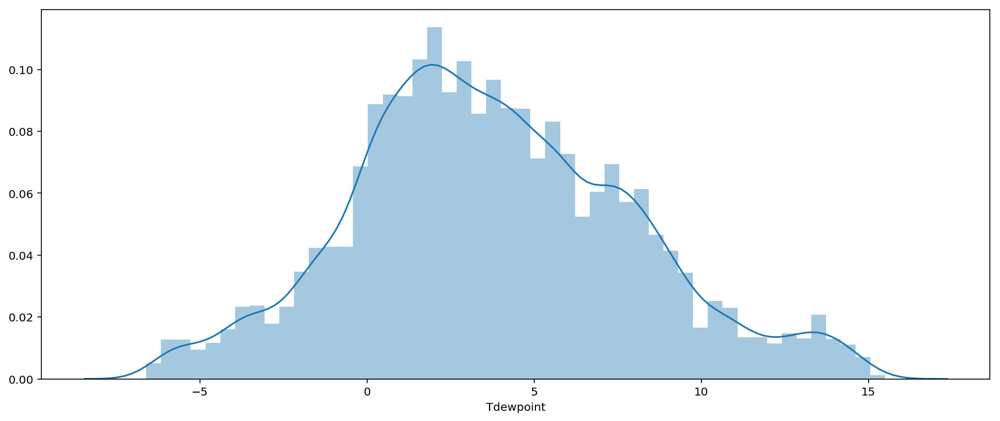

In [38]:
sns.distplot(phase['Tdewpoint'])

## month

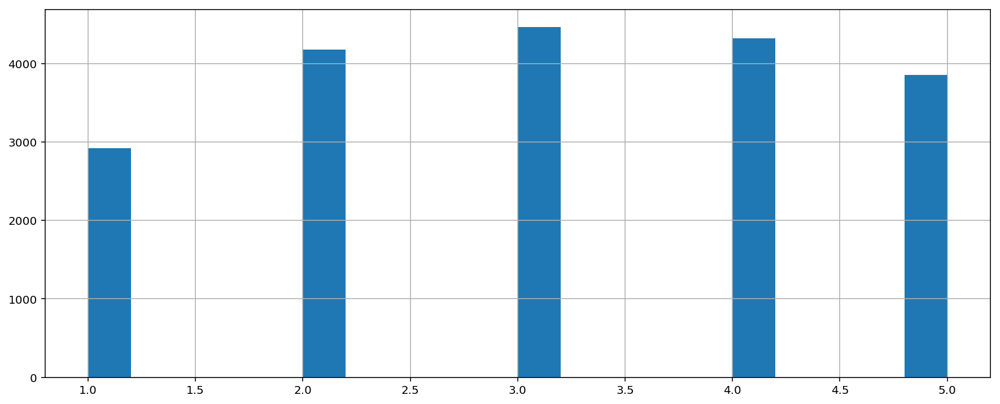

In [39]:
phase['month'].hist(bins=20)

## day_of_week

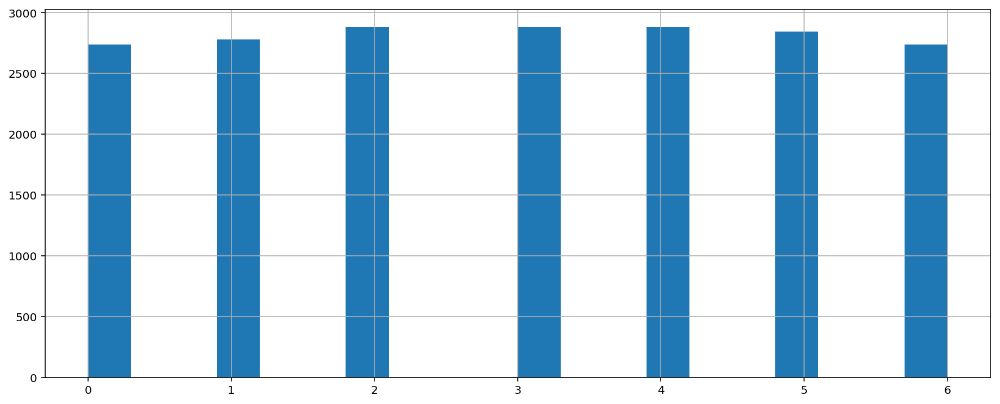

In [40]:
phase['day_of_week'].hist(bins=20)

## hour

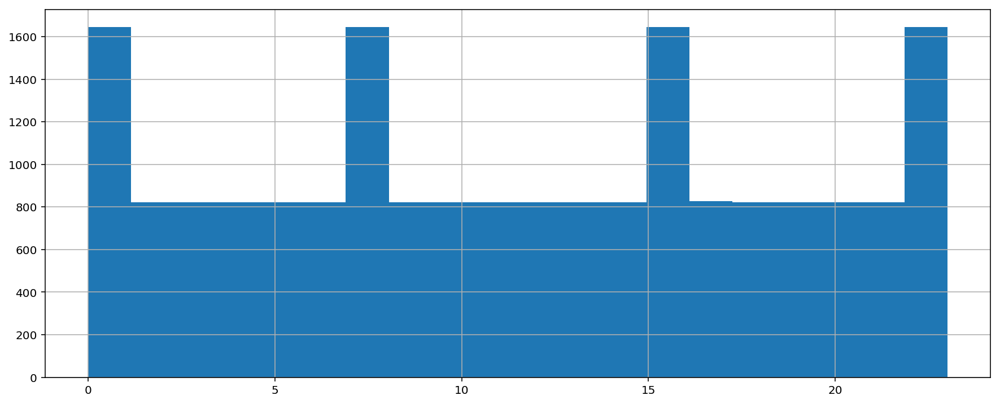

In [41]:
phase['hour'].hist(bins=20)

## daynumber

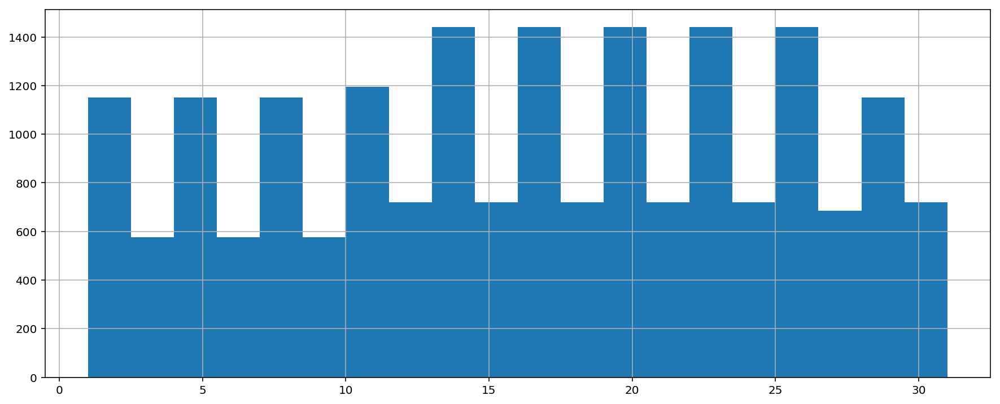

In [42]:
phase['day_number'].hist(bins=20)

## Time

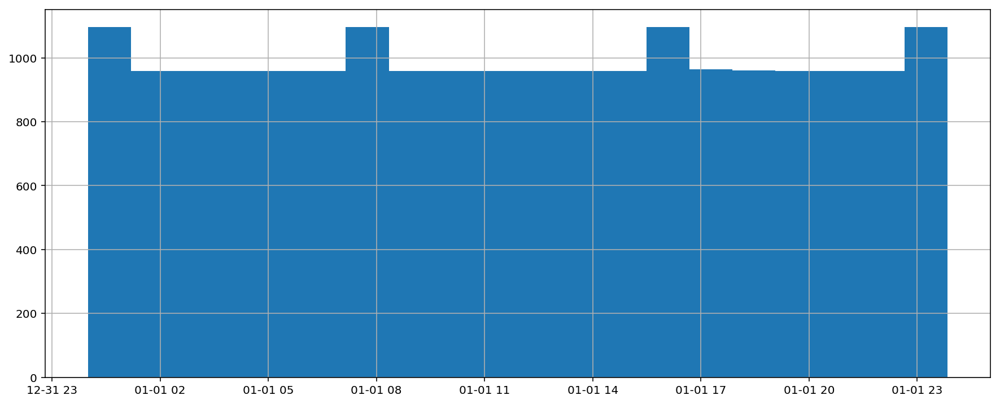

In [43]:
phase['Time'].hist(bins=20)

## datetime

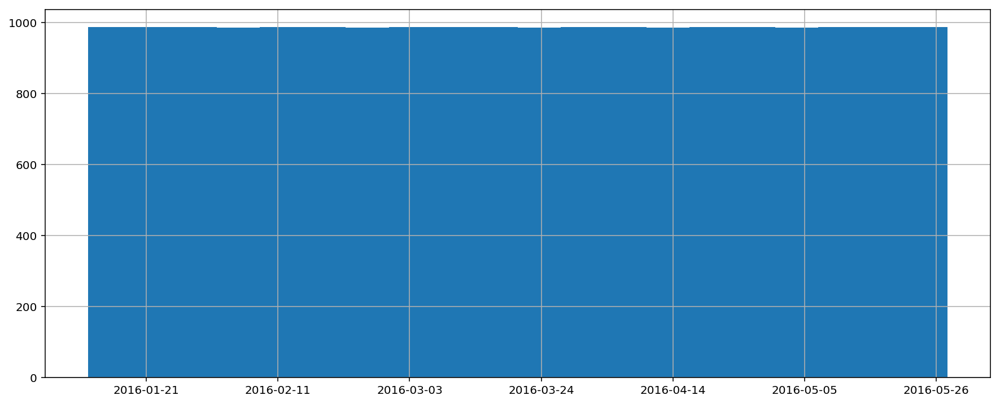

In [44]:
phase['datetime'].hist(bins=20)

## RV1

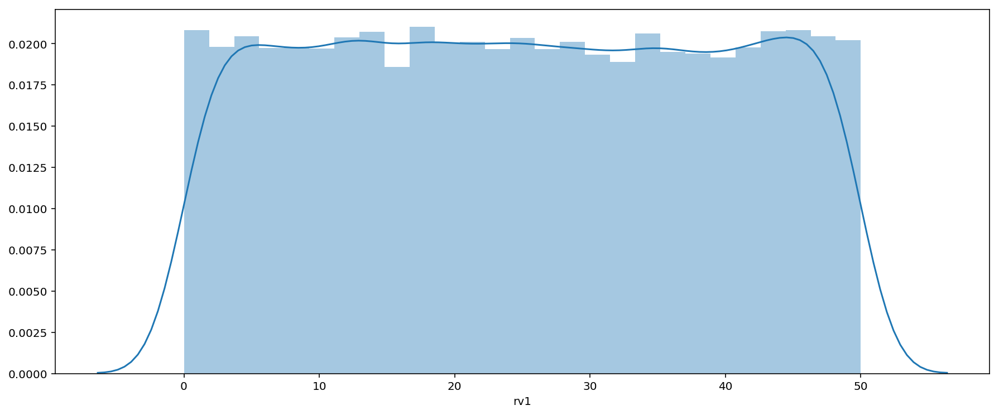

In [45]:
sns.distplot(phase['rv1'])

## RV2

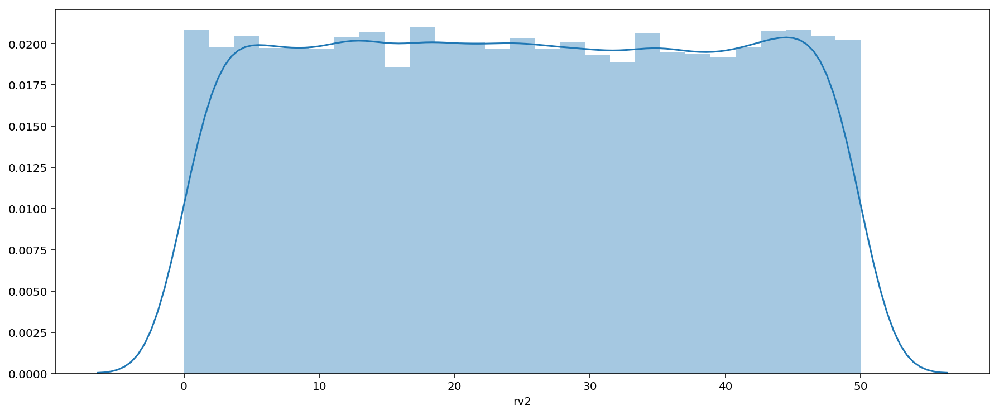

In [46]:
sns.distplot(phase['rv2'])

In [47]:
phase.dtypes

month                   int64
day_of_week             int64
hour                    int64
day_number              int64
Time           datetime64[ns]
datetime       datetime64[ns]
Appliances              int64
lights                  int64
T1                    float64
RH_1                  float64
T2                    float64
RH_2                  float64
T3                    float64
RH_3                  float64
T4                    float64
RH_4                  float64
T5                    float64
RH_5                  float64
T6                    float64
RH_6                  float64
T7                    float64
RH_7                  float64
T8                    float64
RH_8                  float64
T9                    float64
RH_9                  float64
T_out                 float64
Press_mm_hg           float64
RH_out                float64
Windspeed             float64
Visibility            float64
Tdewpoint             float64
rv1                   float64
rv2       

# Bi-variate Analysis

## Continous-Continous
### See Heatmap for corelation between them

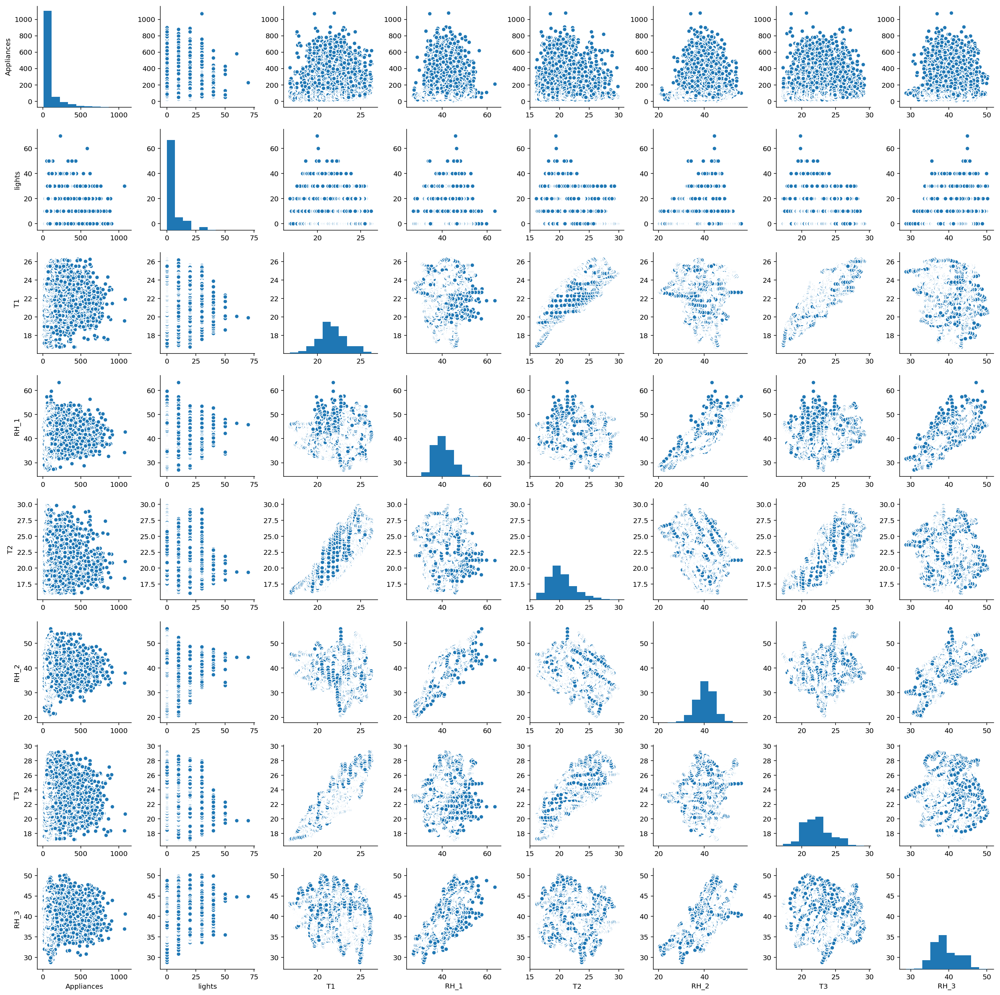

In [48]:
g1 = sns.pairplot(phase, vars=["Appliances", "lights", "T1", "RH_1", "T2", "RH_2", "T3", "RH_3"])

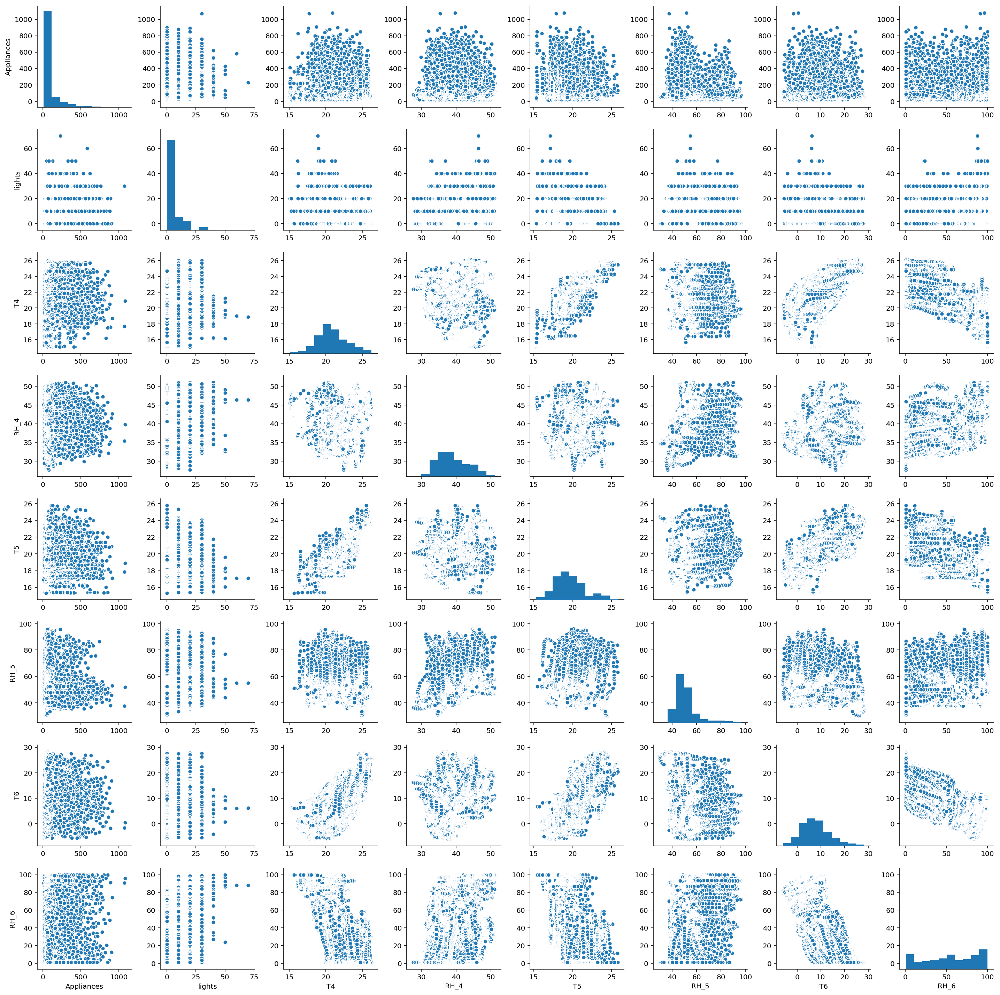

In [49]:
g2 = sns.pairplot(phase, vars=["Appliances", "lights", "T4", "RH_4", "T5", "RH_5", "T6", "RH_6"])

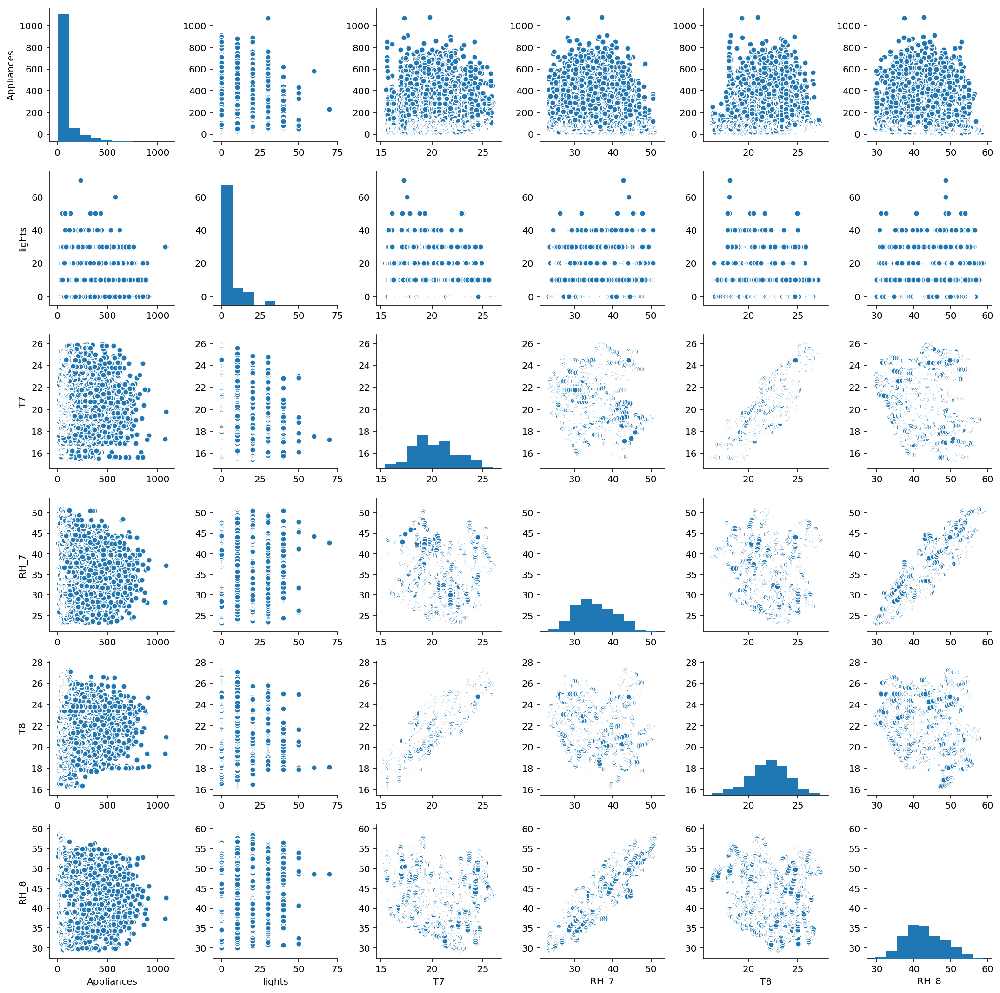

In [50]:
g3 = sns.pairplot(phase, vars=["Appliances", "lights", "T7", "RH_7", "T8","RH_8"])

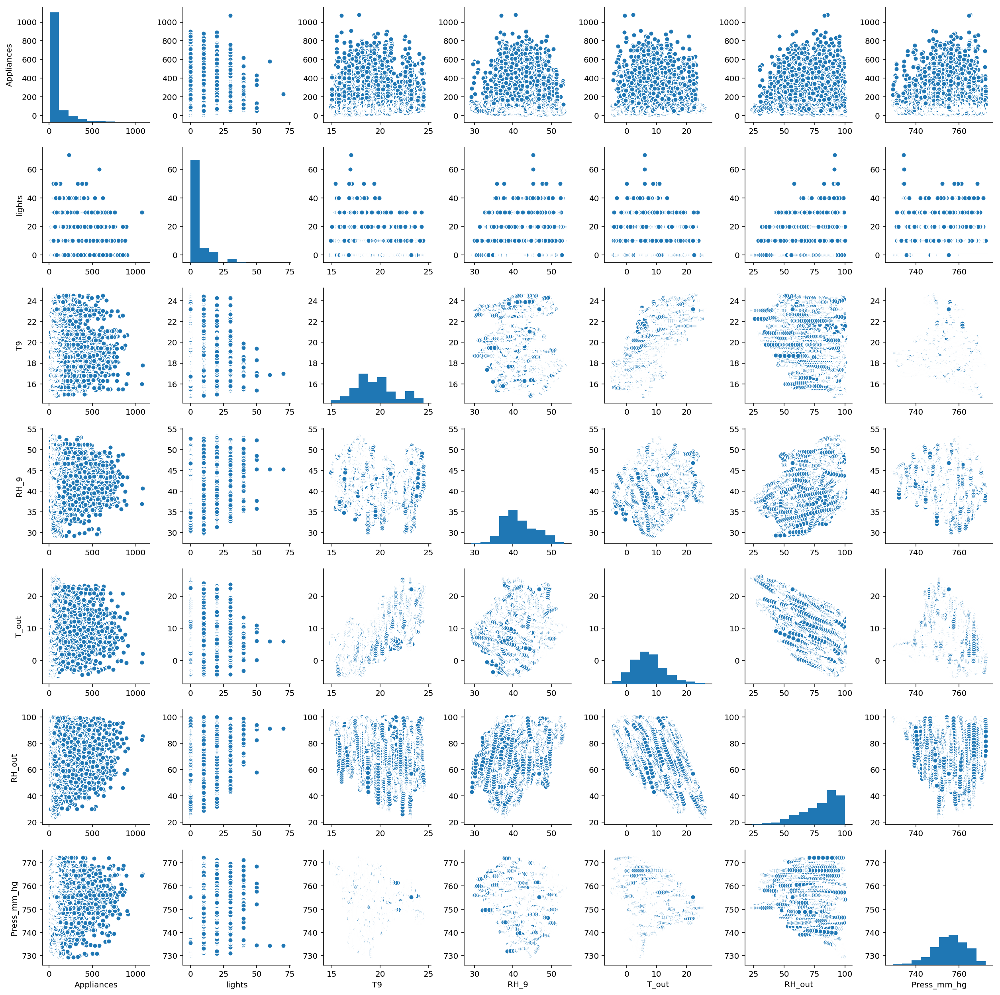

In [51]:
g4 = sns.pairplot(phase, vars=["Appliances", "lights", "T9", "RH_9", "T_out", "RH_out", "Press_mm_hg"])

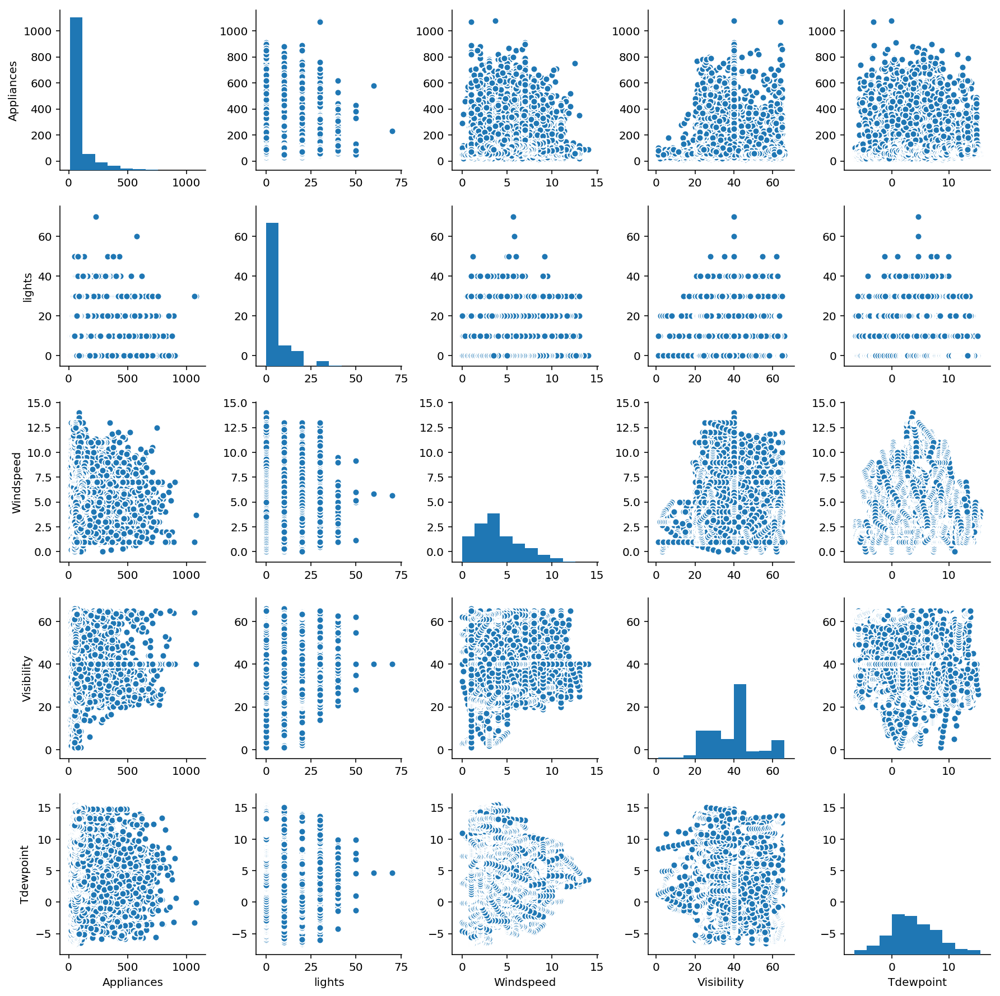

In [52]:
g5 = sns.pairplot(phase, vars=["Appliances", "lights", "Windspeed", "Visibility", "Tdewpoint"])

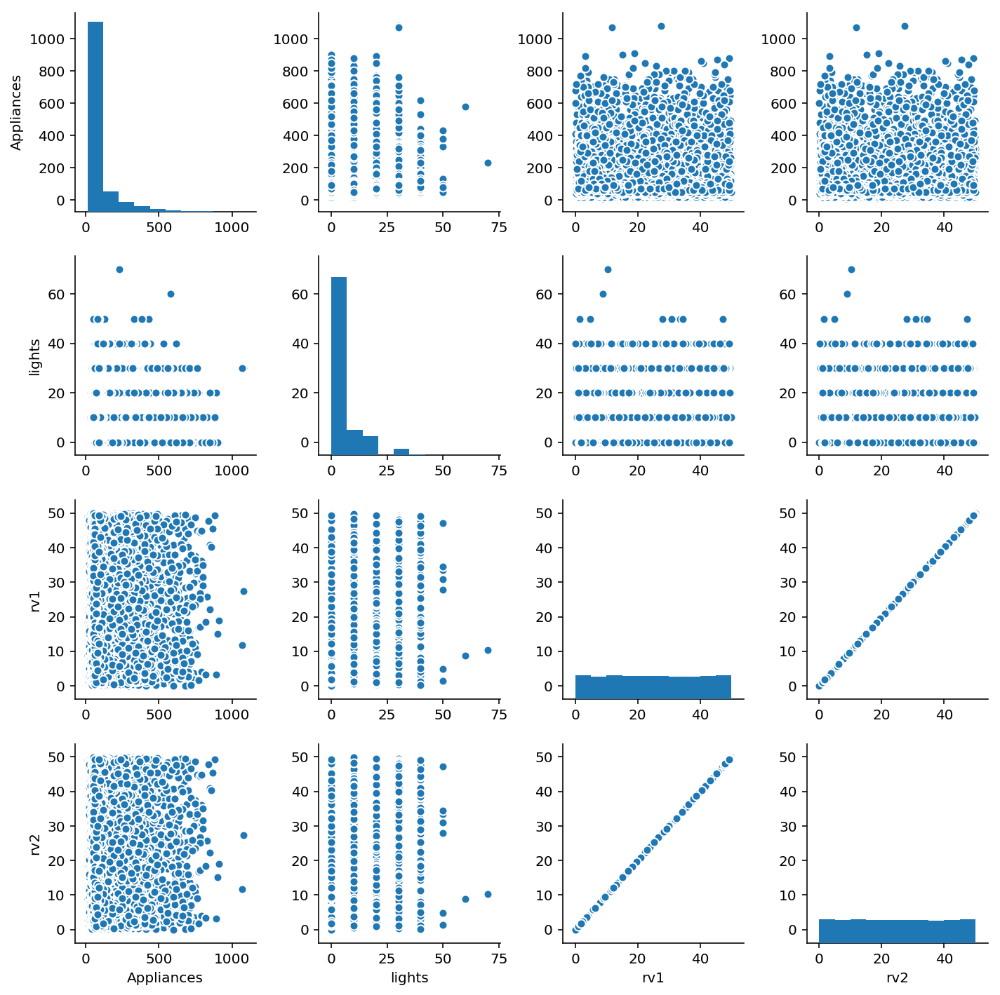

In [53]:
g6 = sns.pairplot(phase, vars=["Appliances", "lights", "rv1","rv2"])

## Categorical-Categorical
## Two-way table, Stacked Column Chart, Chi-Square Test methods

### No need to of scatter plot. 
#### Categorical-Categorical should be done only when car has subtypes and so on dataset

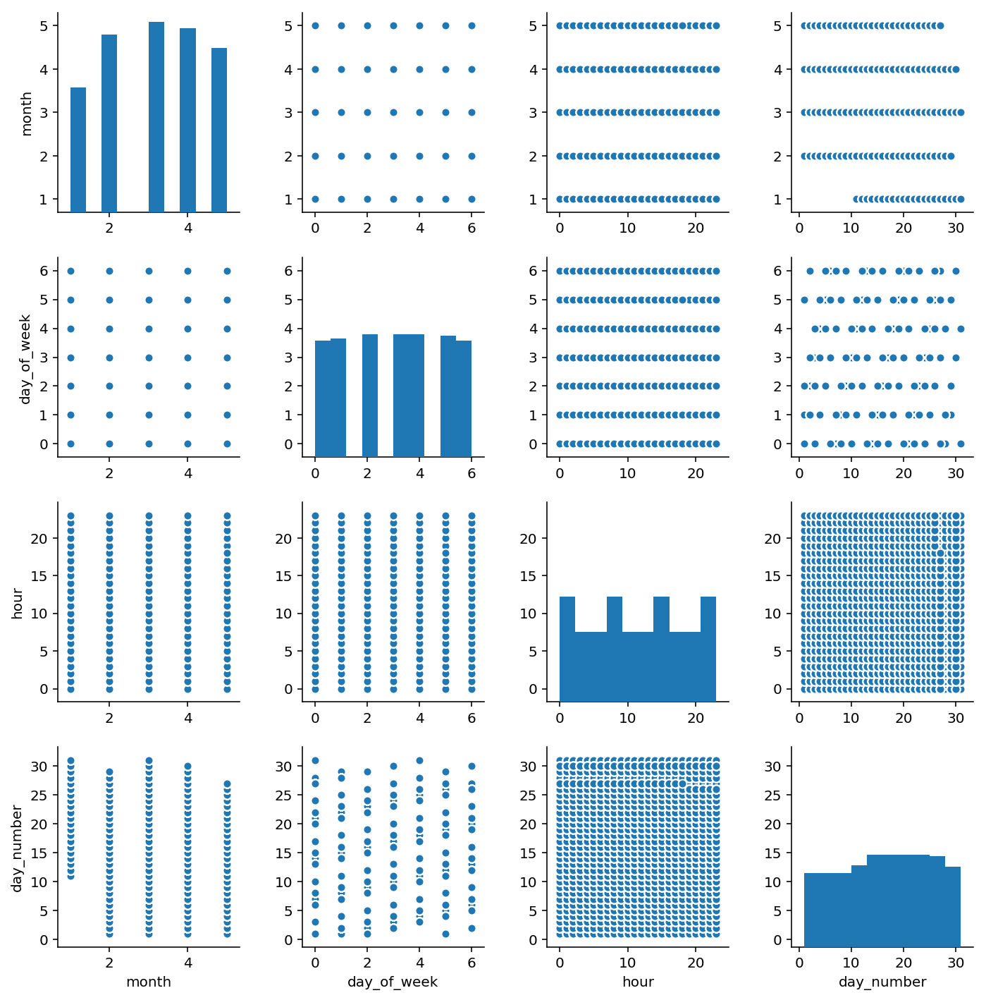

In [54]:
cc12 = sns.pairplot(phase, vars=["month", "day_of_week","hour","day_number"])

## Categorical and Continous
### Box-plot
### For Statistical significance perform Z-test, T-test or ANOVA

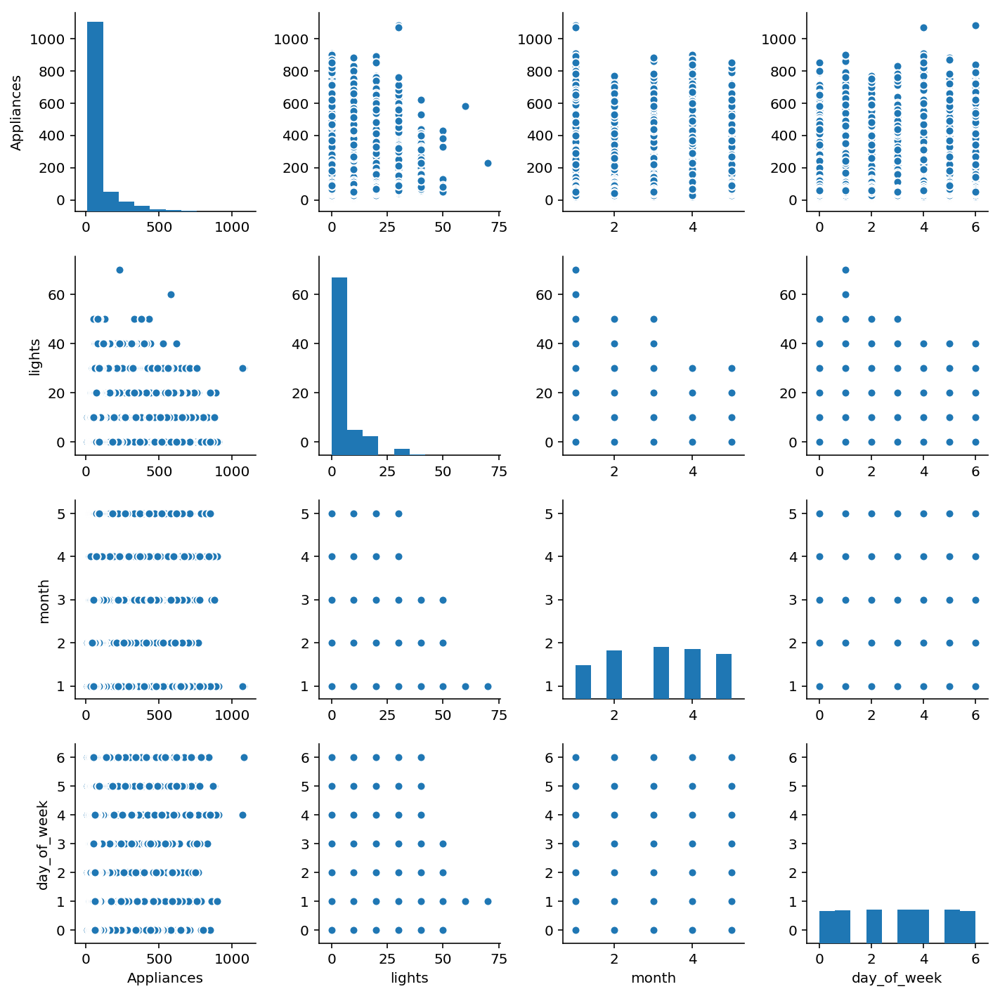

In [55]:
cc1 = sns.pairplot(phase, vars=["Appliances", "lights", "month", "day_of_week"])

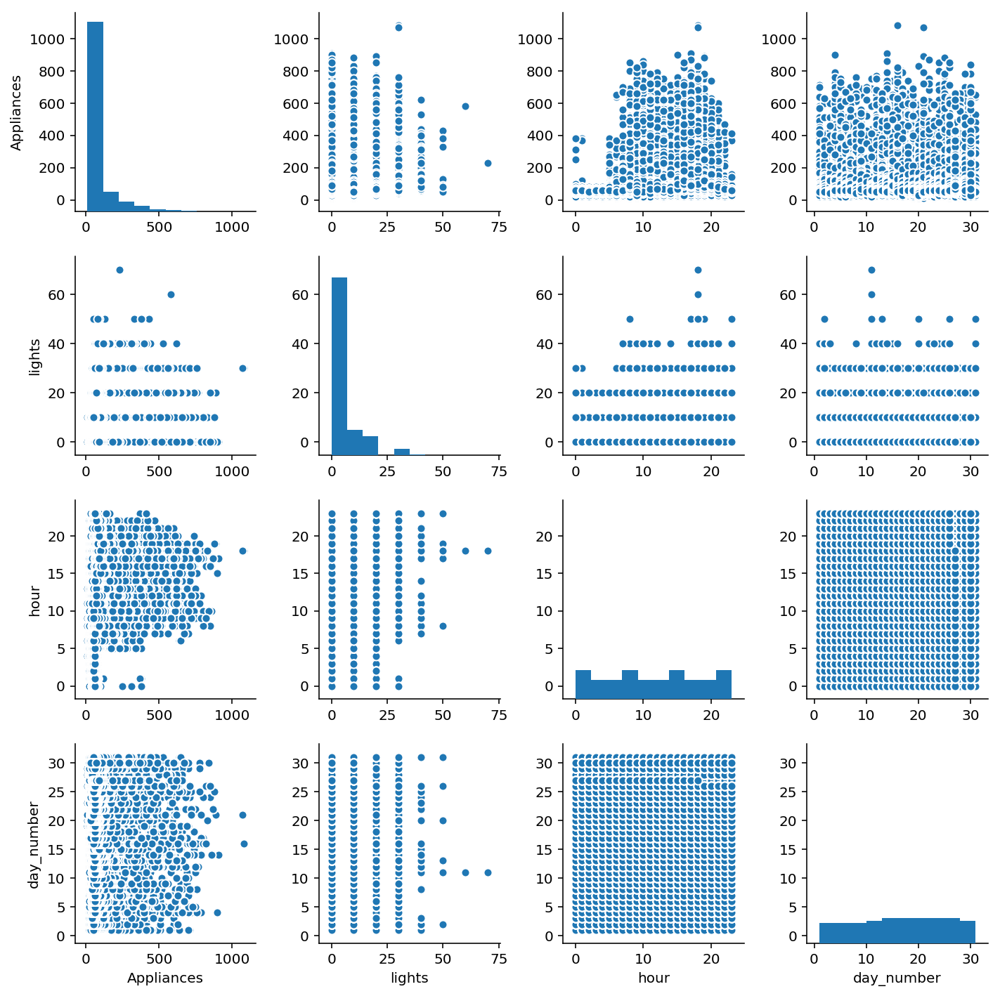

In [56]:
cc2 = sns.pairplot(phase, vars=["Appliances","lights","hour", "day_number"])

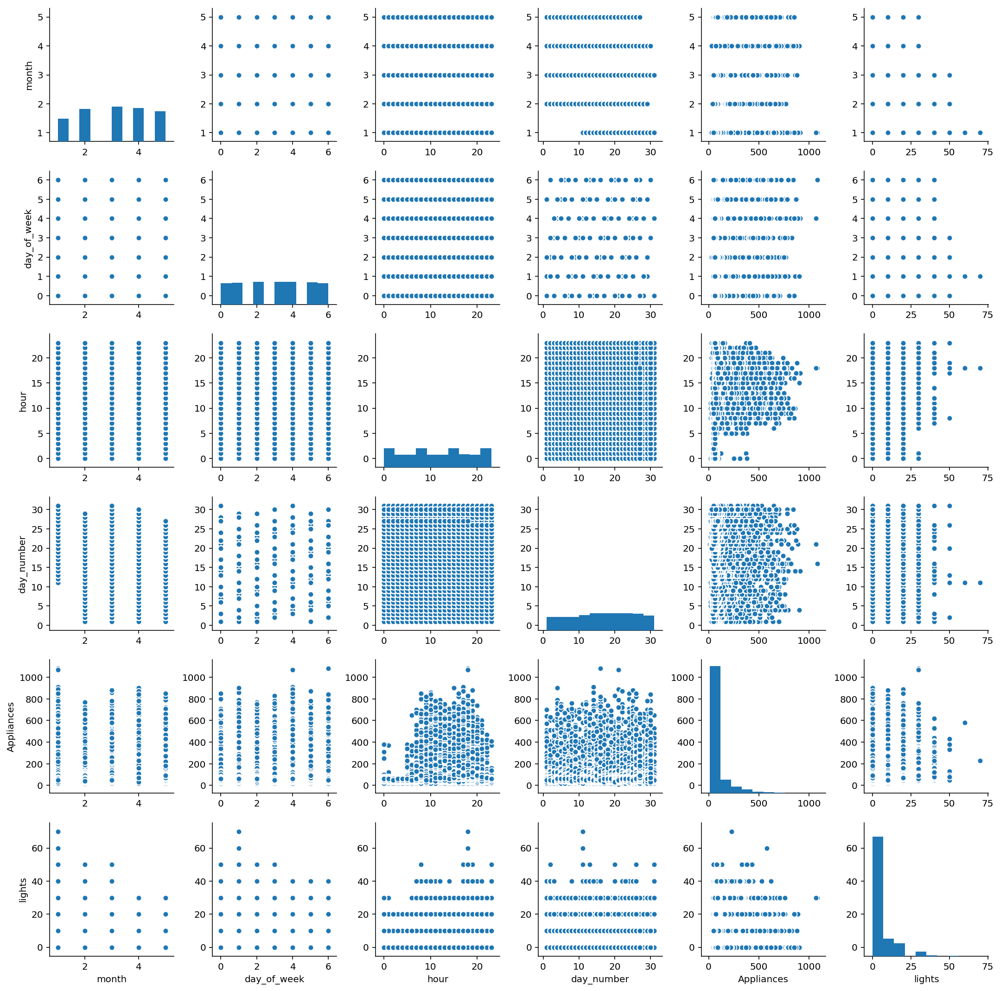

In [57]:
caco1 = sns.pairplot(phase, vars=["month","day_of_week","hour","day_number","Appliances", "lights", ])

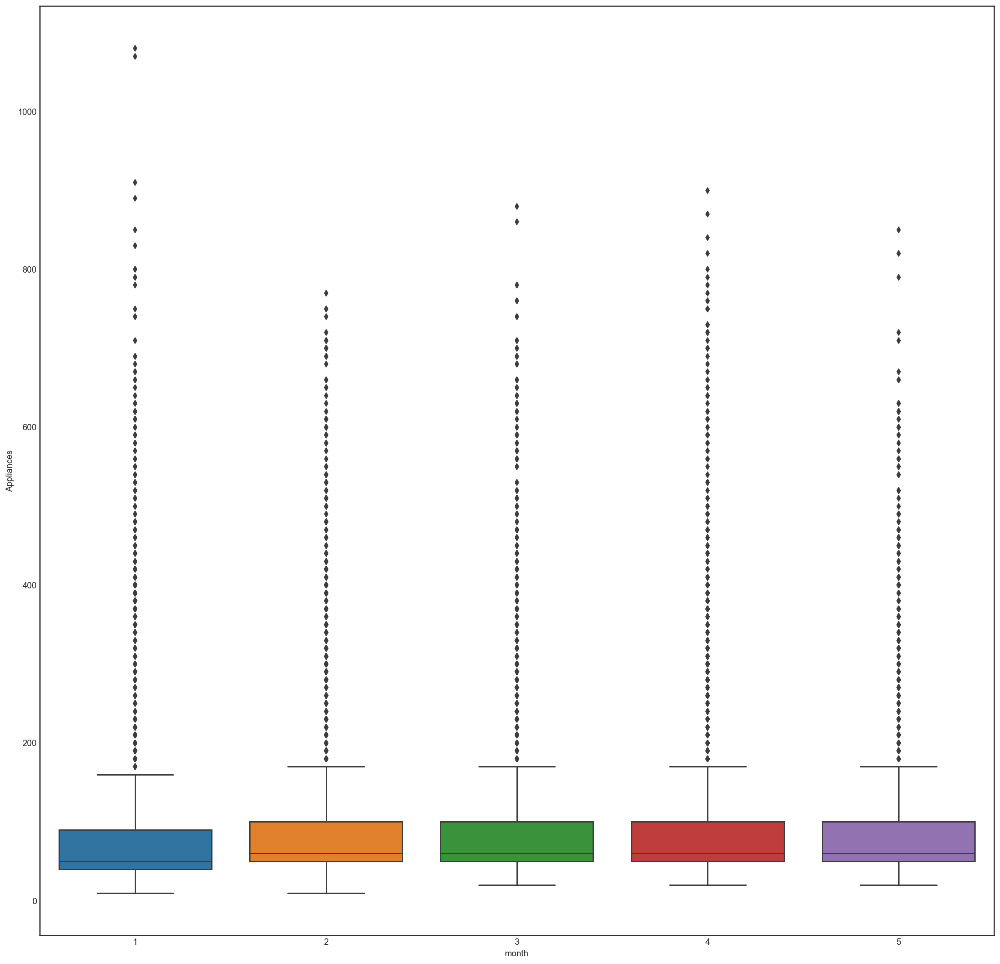

In [58]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax = sns.boxplot(x="month", y="Appliances", data=phase)

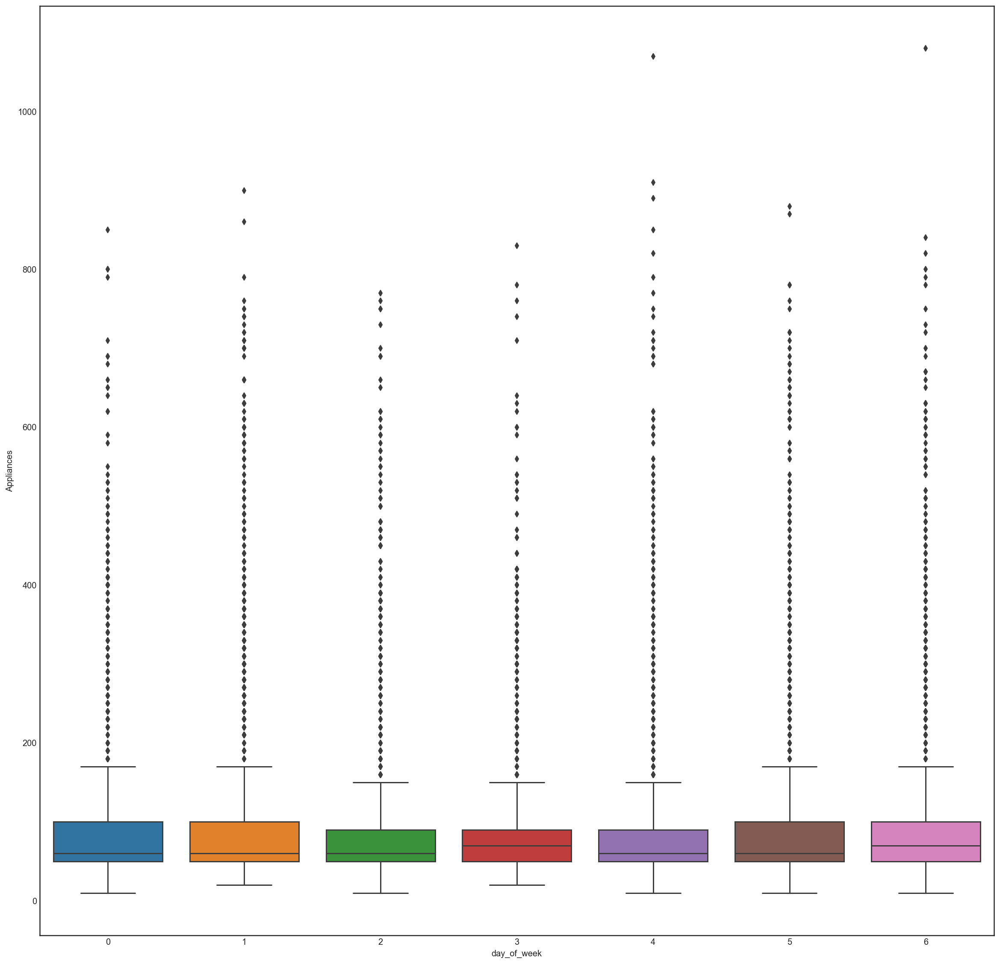

In [59]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax1 = sns.boxplot(x="day_of_week", y="Appliances", data=phase)

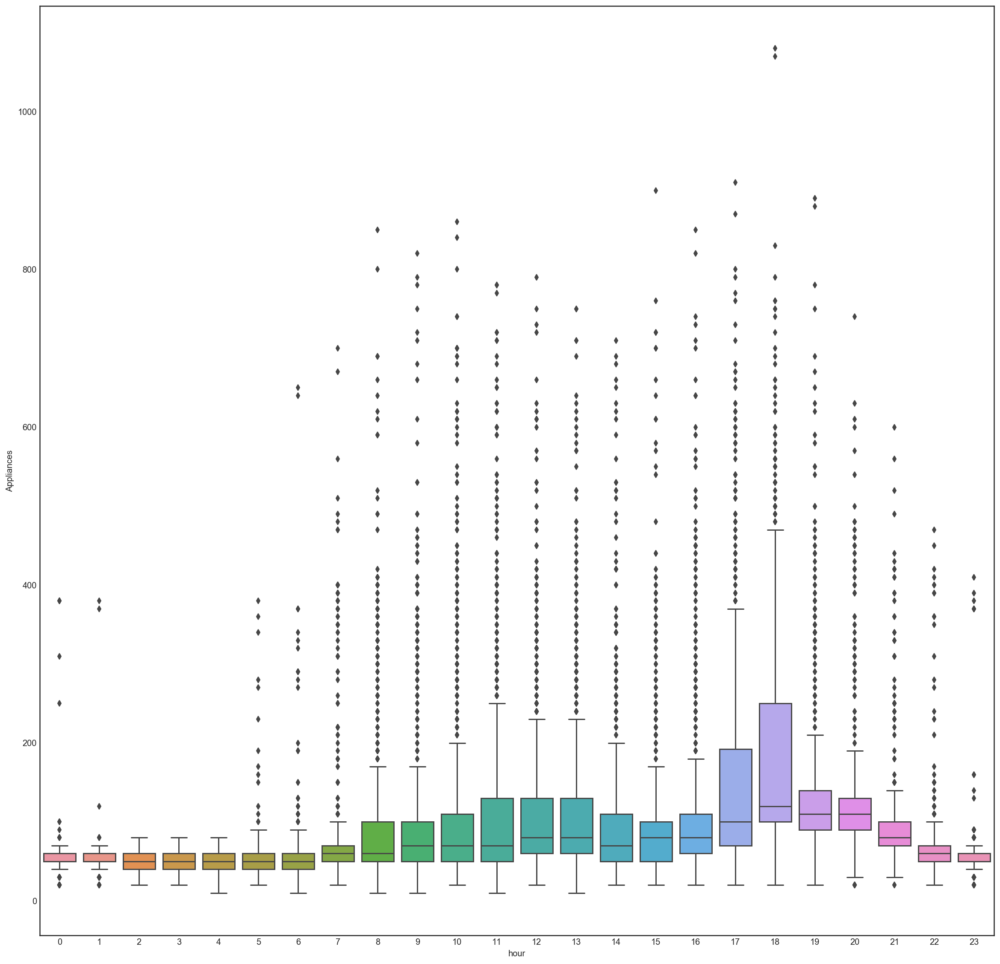

In [60]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax = sns.boxplot(x="hour", y="Appliances", data=phase)

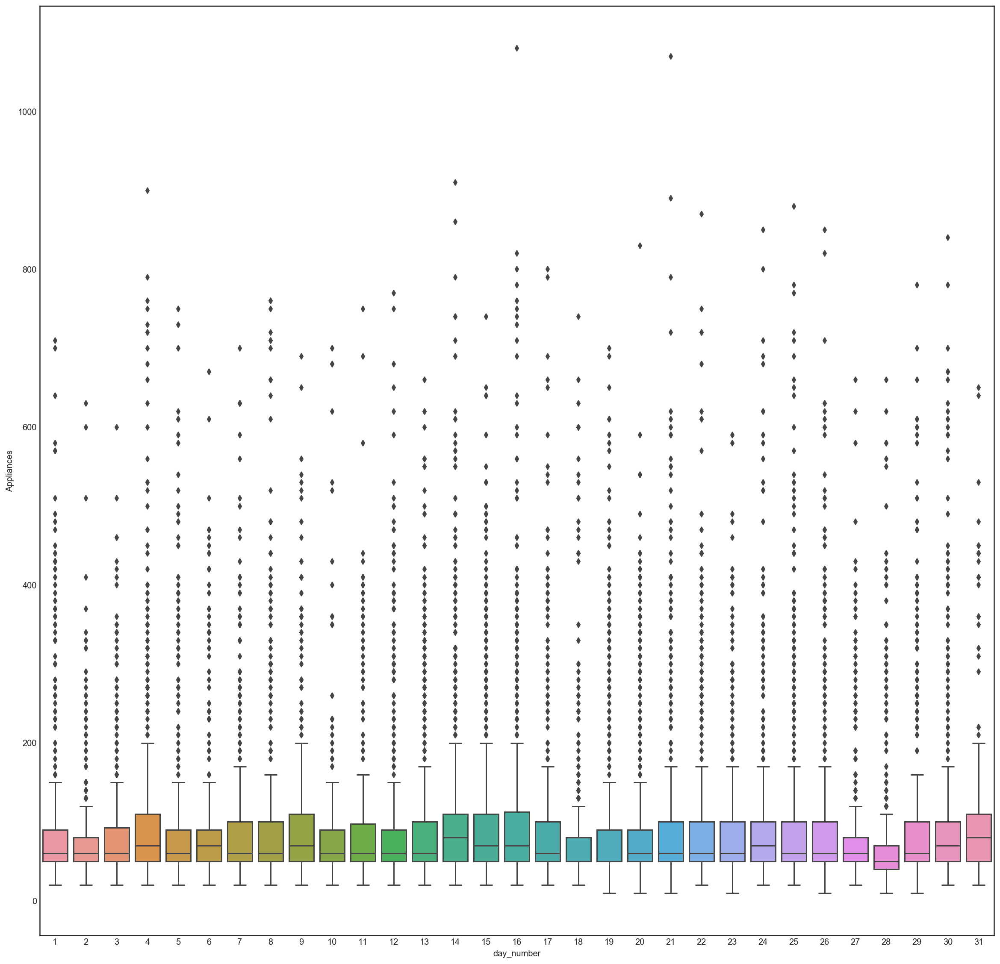

In [61]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax = sns.boxplot(x="day_number", y="Appliances", data=phase)

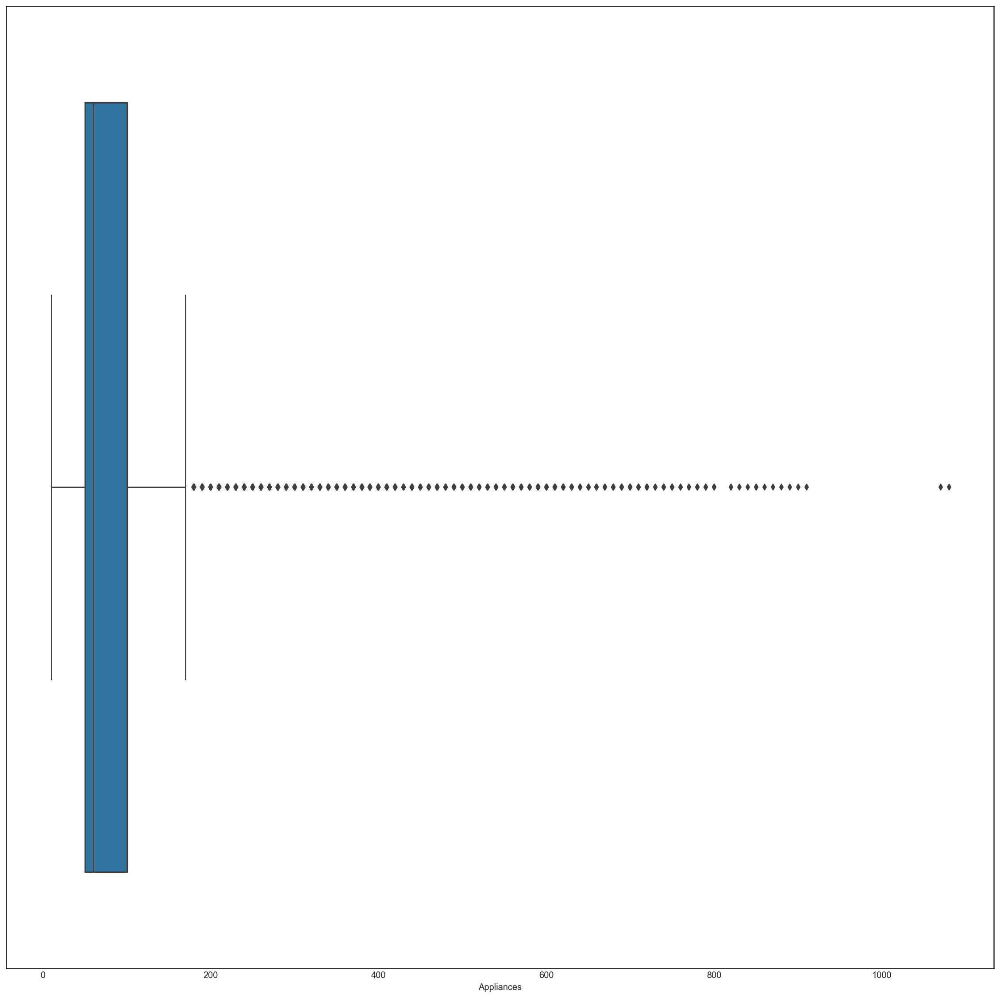

In [62]:
import seaborn as sns
#%matplotlib inline
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax = sns.boxplot(x="Appliances", data=phase)

{'boxes': [<matplotlib.lines.Line2D at 0x14e2de0b8>],
 'caps': [<matplotlib.lines.Line2D at 0x14e2dec50>,
 'fliers': [<matplotlib.lines.Line2D at 0x14e2e5a58>],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x14e2e55c0>],
 'whiskers': [<matplotlib.lines.Line2D at 0x14e2de240>,
  <matplotlib.lines.Line2D at 0x14e2de7b8>]}

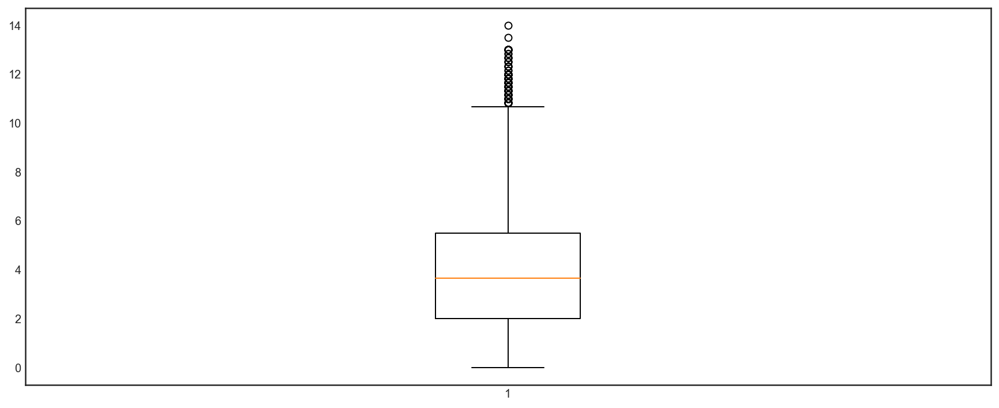

In [63]:
plt.boxplot(phase.Windspeed)

## No correlation between datetime and time with appliances and lights

## Even check correlation with other parameters

# Correlation with heatmap with values for better understanding

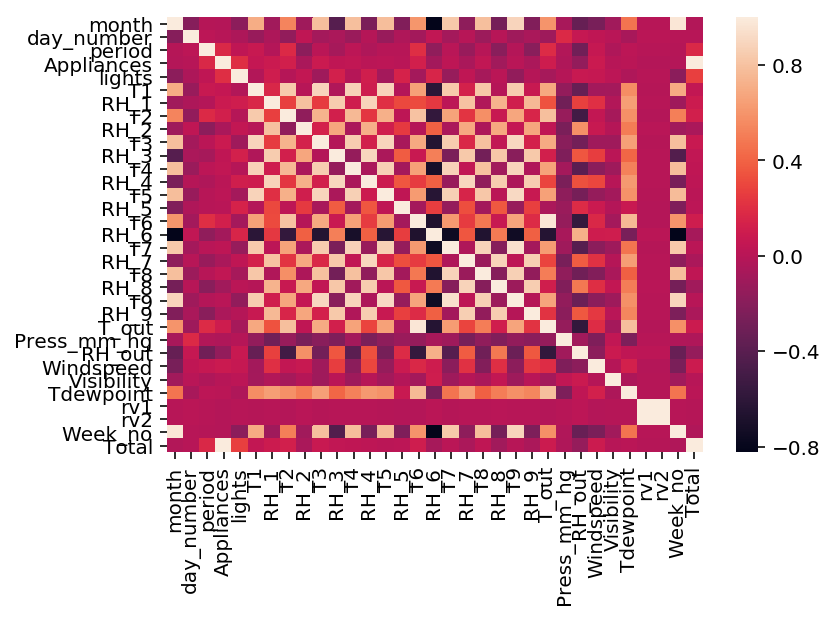

In [25]:
corr = phase.corr()
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns)
cmap=sns.diverging_palette(5, 250, as_cmap=True)

def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Hover to magify")\
    .set_precision(2)\
    .set_table_styles(magnify())

# MISSING VALUES ANALYSIS
## Methods to treat missing values
### Deletion
### Mean/Mode/Median Imputation
### Prediction Model Used are ANOVA, Logistic regression
### kNN Imputation

In [65]:
phase.isnull().sum()

month          0
day_of_week    0
hour           0
day_number     0
Time           0
datetime       0
Appliances     0
lights         0
T1             0
RH_1           0
T2             0
RH_2           0
T3             0
RH_3           0
T4             0
RH_4           0
T5             0
RH_5           0
T6             0
RH_6           0
T7             0
RH_7           0
T8             0
RH_8           0
T9             0
RH_9           0
T_out          0
Press_mm_hg    0
RH_out         0
Windspeed      0
Visibility     0
Tdewpoint      0
rv1            0
rv2            0
Week_no        0
Total          0
dtype: int64

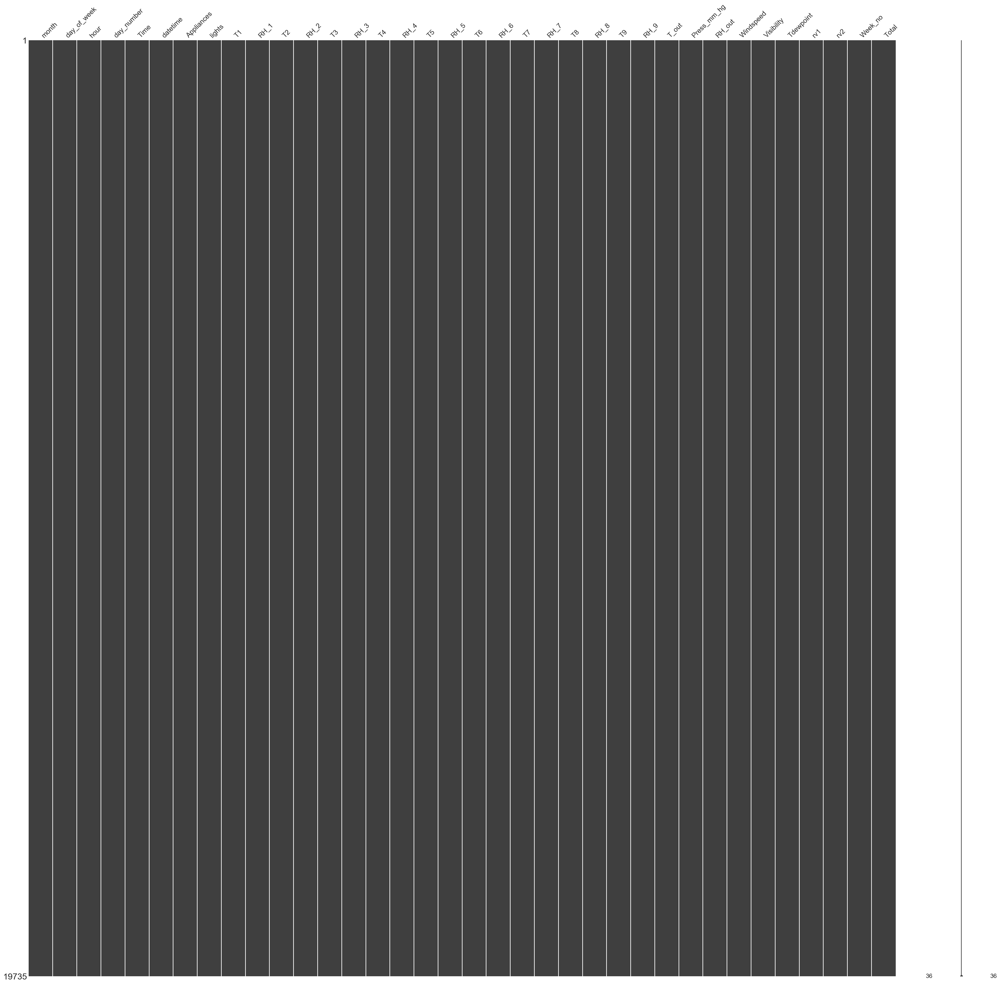

In [66]:
import missingno as msno
msno.matrix(phase.sample(19735),
            figsize=(40,40),
            width_ratios=(15, 1))
plt.show()

# Outlier Detection and Treatment
## Types of outliers-
### Data Entry Error    X
### Measurement Error X
### Experimental Error   X
### Intentional Outlier   X
### Data Processing Error  X
### Sampling Error 
### Natural Outlier

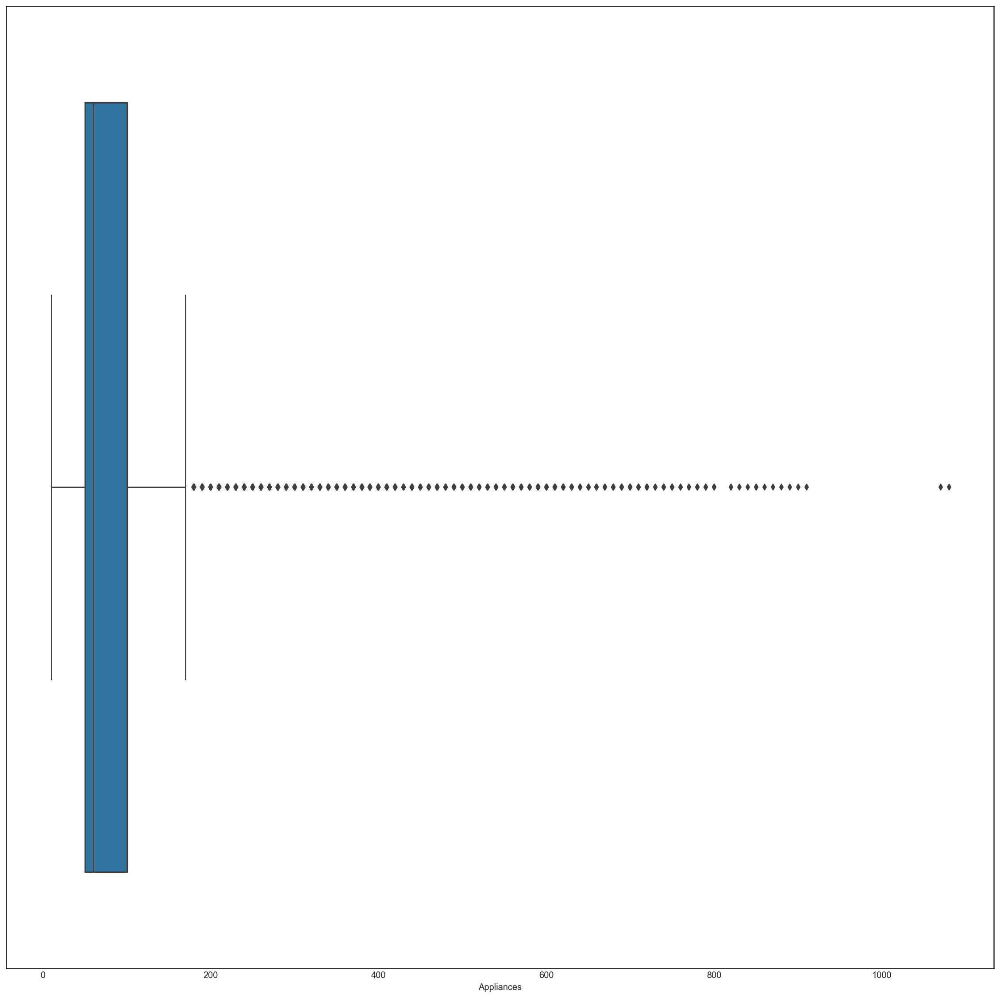

In [67]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax1 = sns.boxplot(x="Appliances", data=phase)

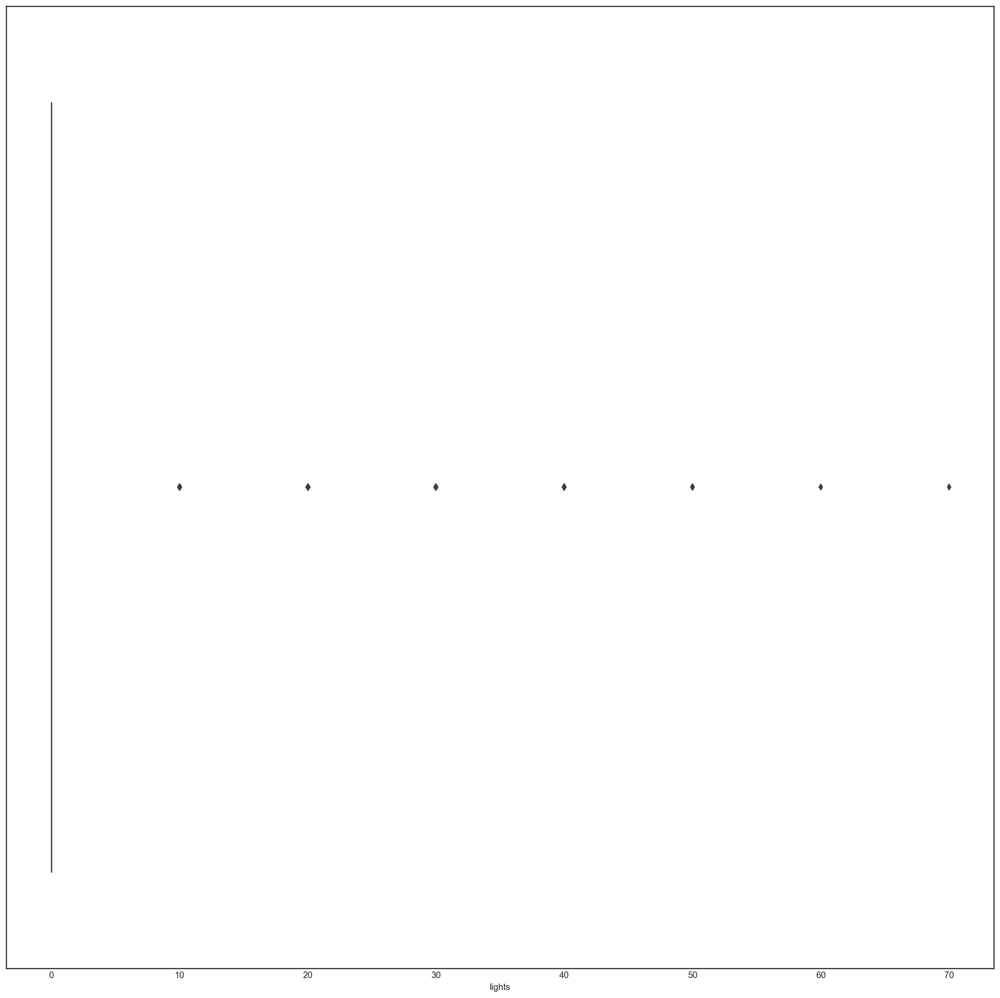

In [68]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax2 = sns.boxplot(x="lights", data=phase)

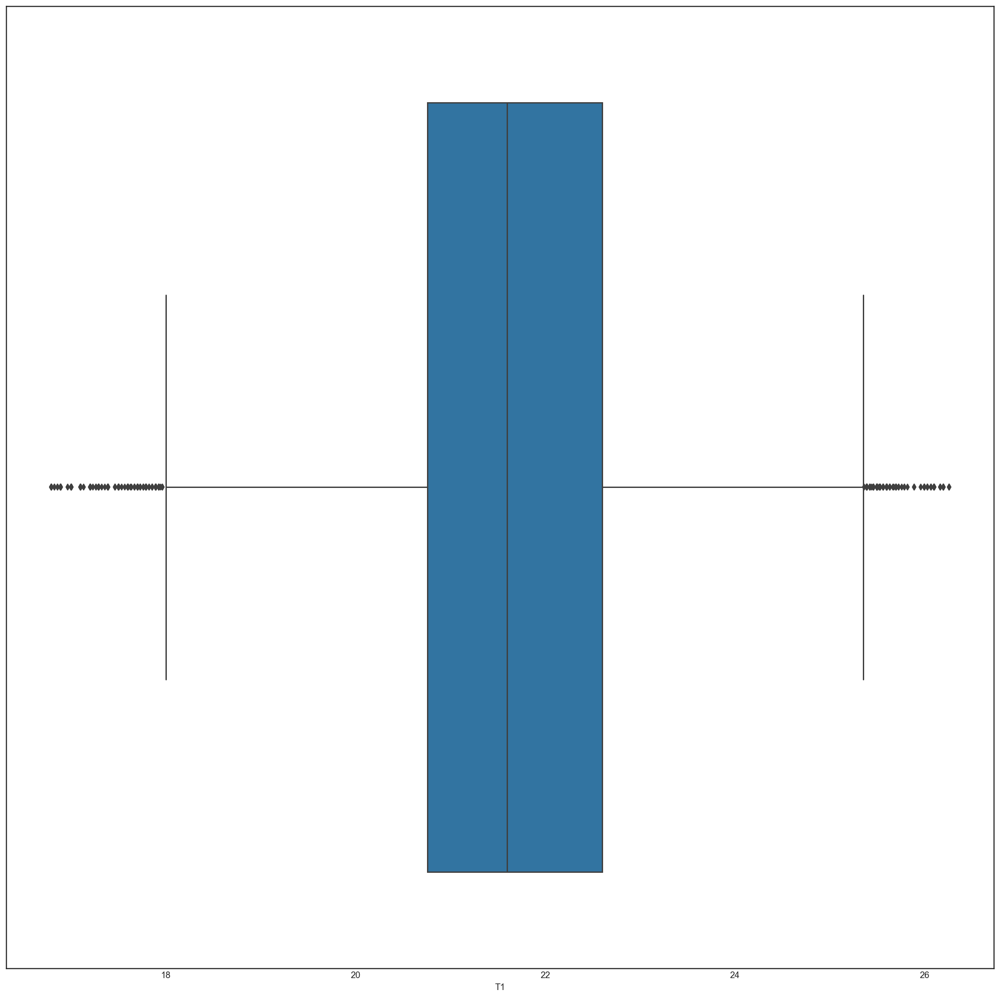

In [69]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax3 = sns.boxplot(x="T1", data=phase)

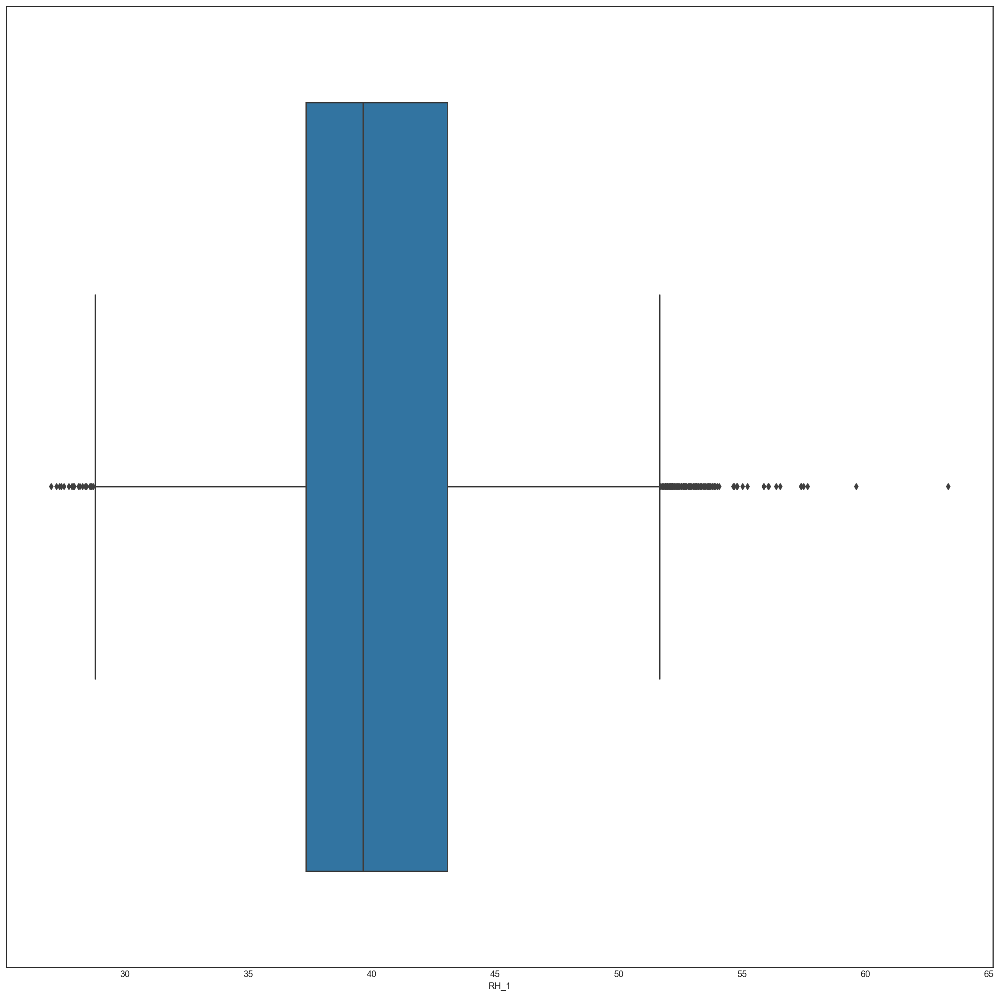

In [70]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax3 = sns.boxplot(x="RH_1", data=phase)

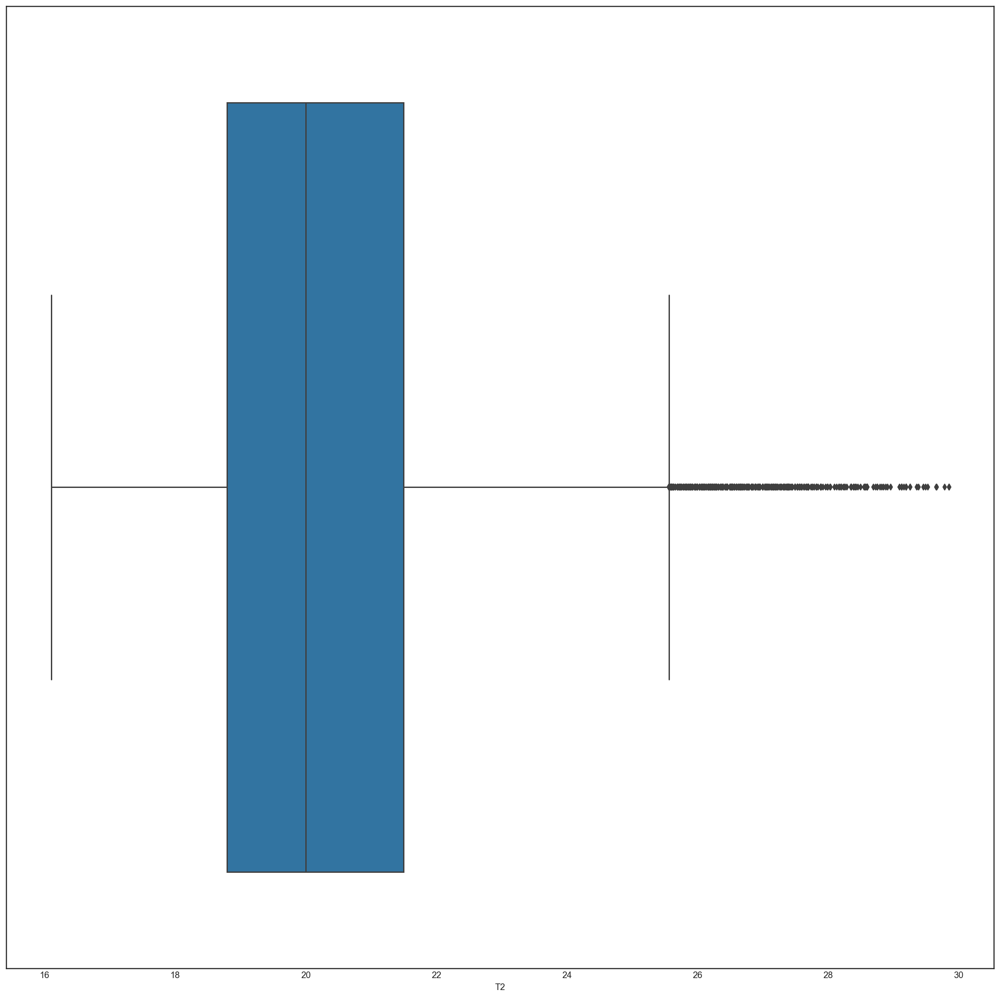

In [71]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax4 = sns.boxplot(x="T2", data=phase)

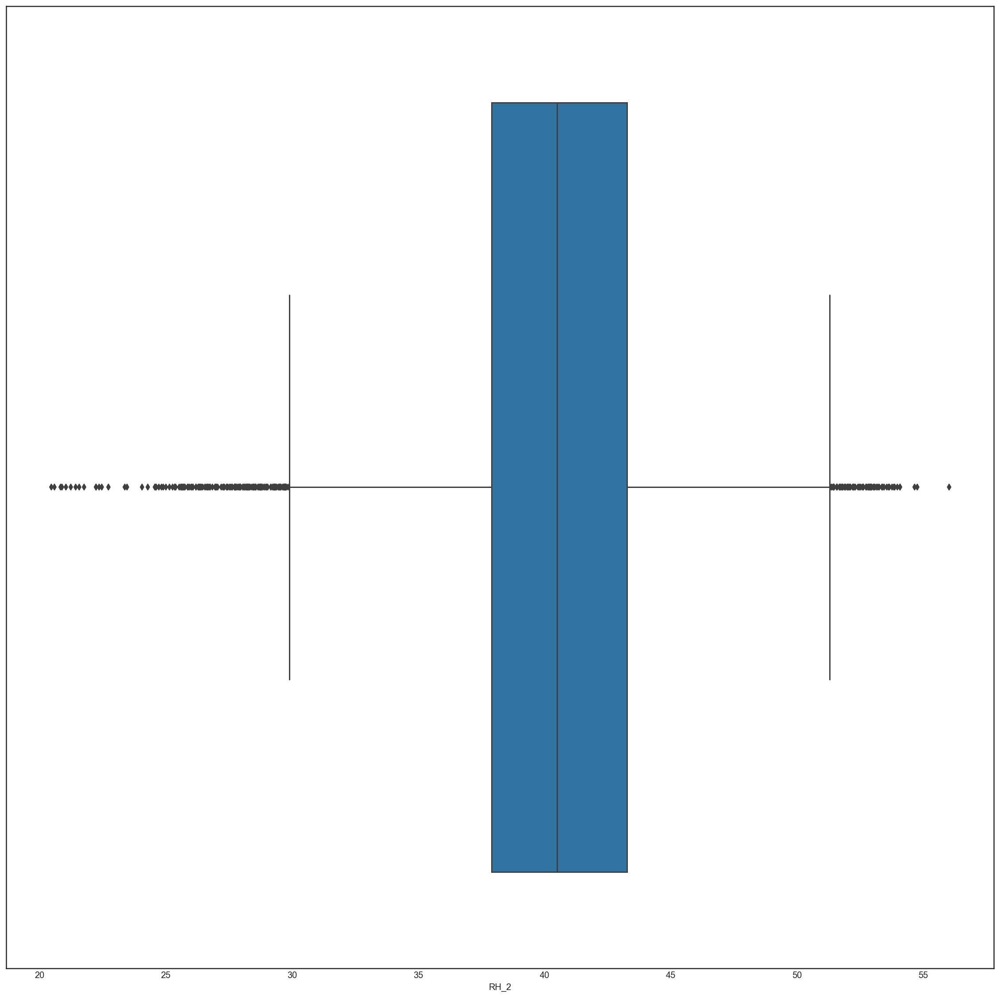

In [72]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax3 = sns.boxplot(x="RH_2", data=phase)

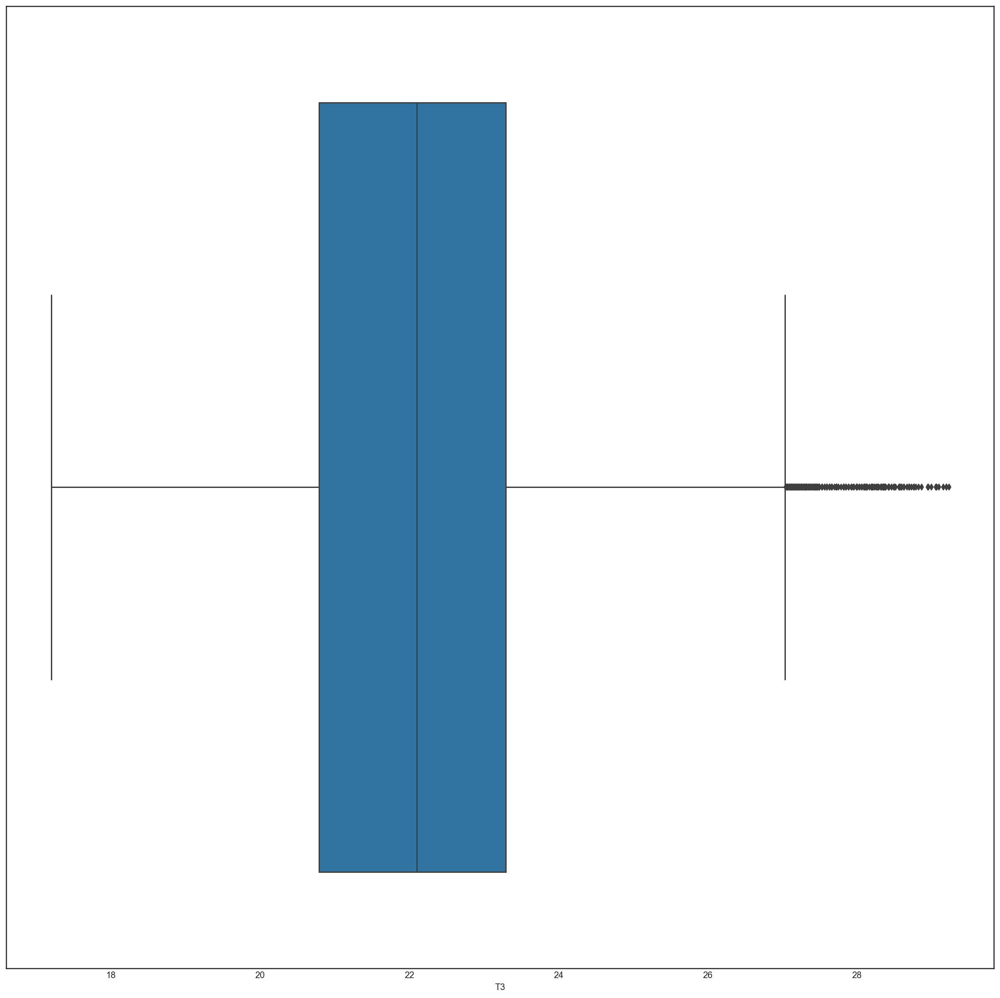

In [73]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax3 = sns.boxplot(x="T3", data=phase)

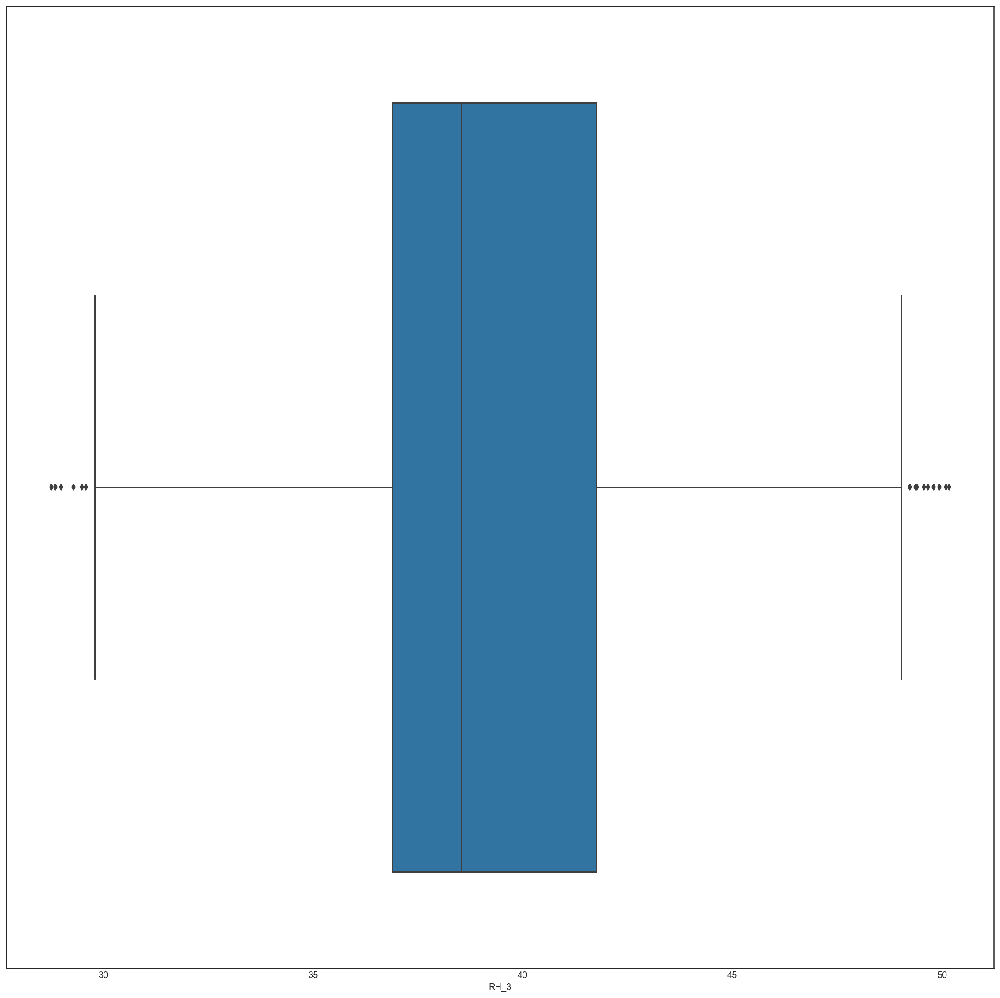

In [74]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax4 = sns.boxplot(x="RH_3", data=phase)

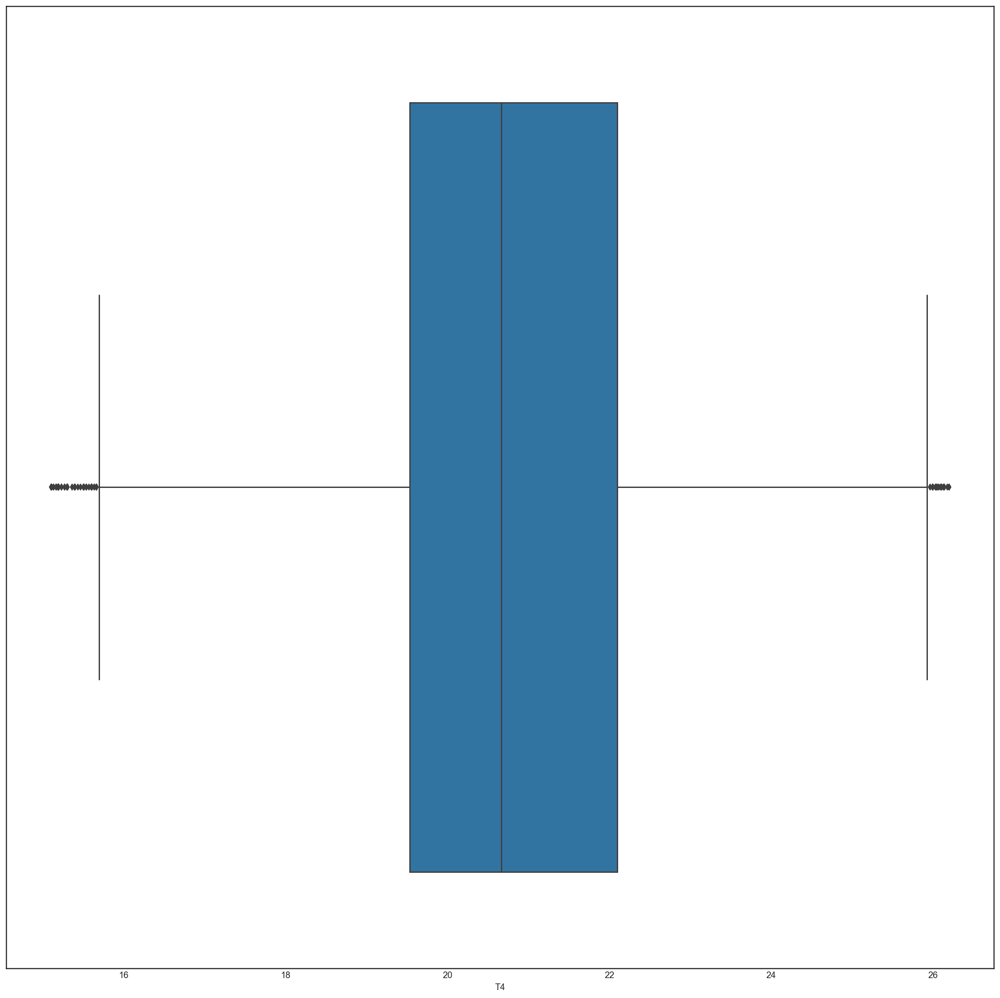

In [75]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax5 = sns.boxplot(x="T4", data=phase)

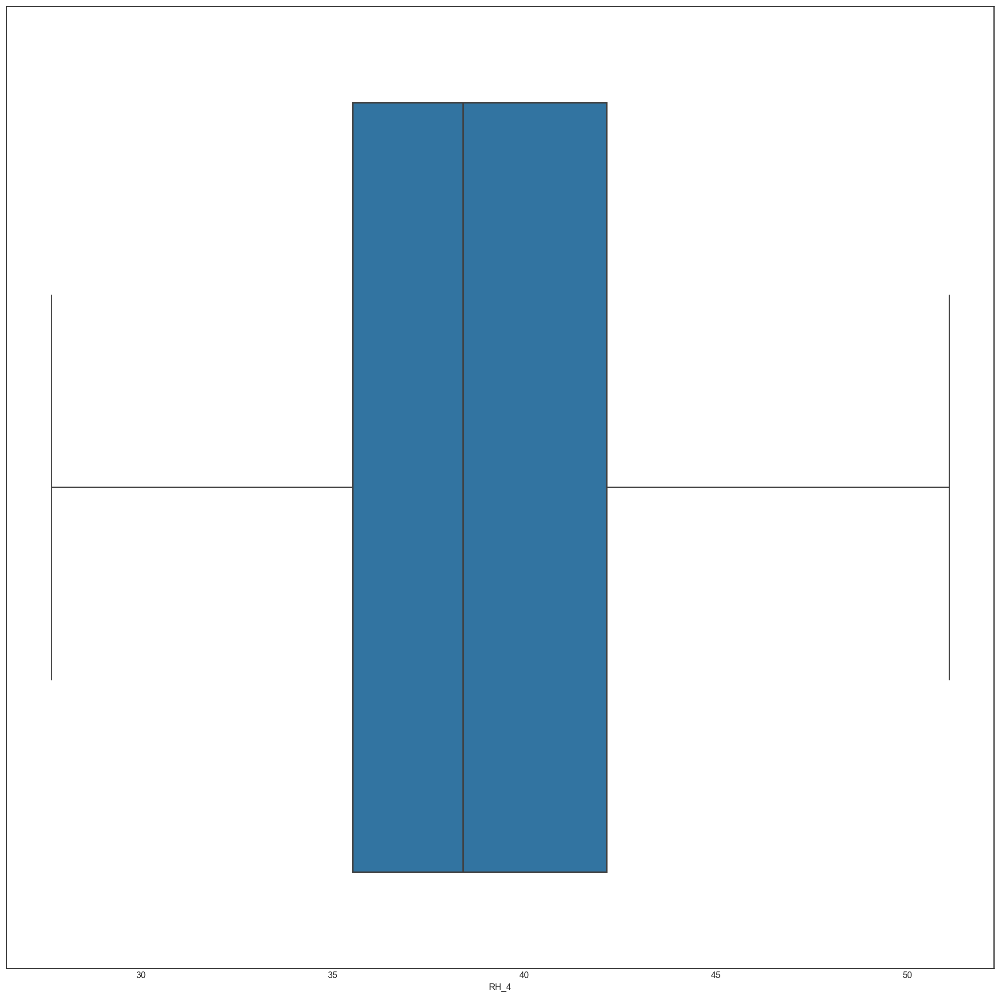

In [76]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax6 = sns.boxplot(x="RH_4", data=phase)

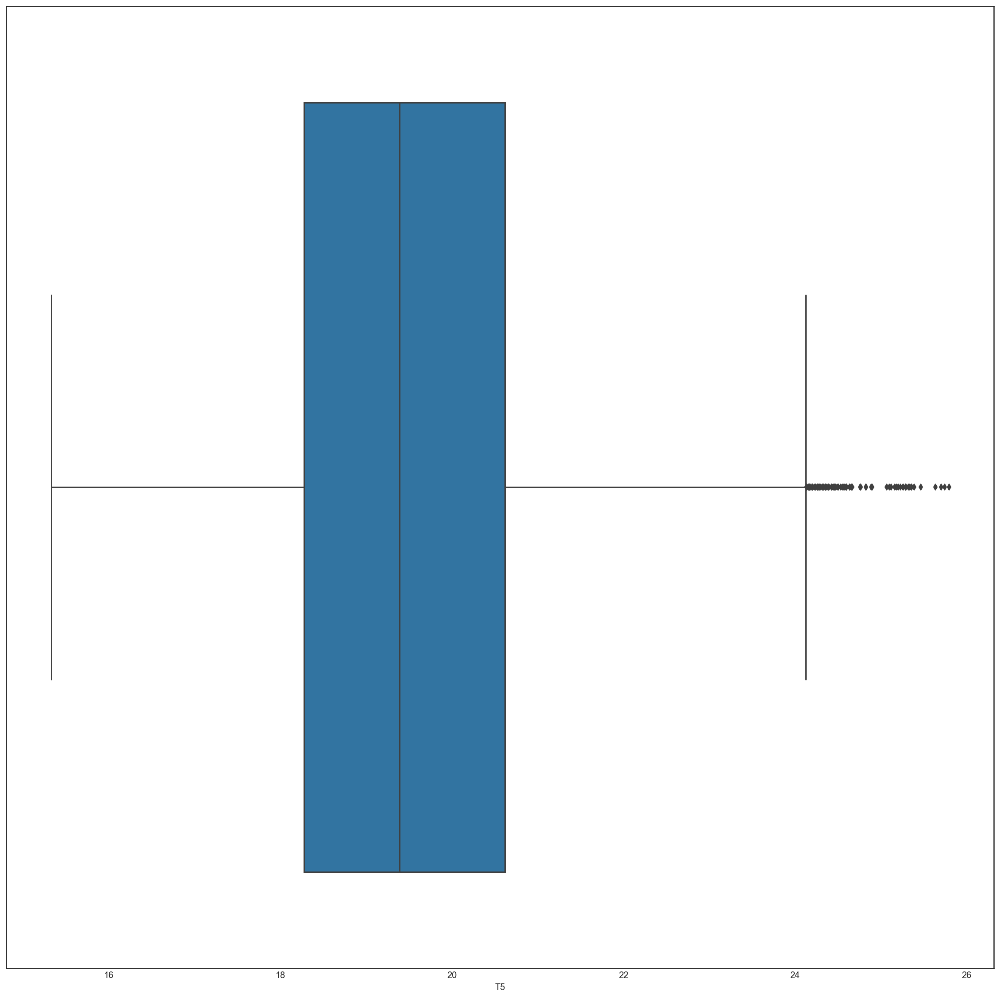

In [77]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax7 = sns.boxplot(x="T5", data=phase)

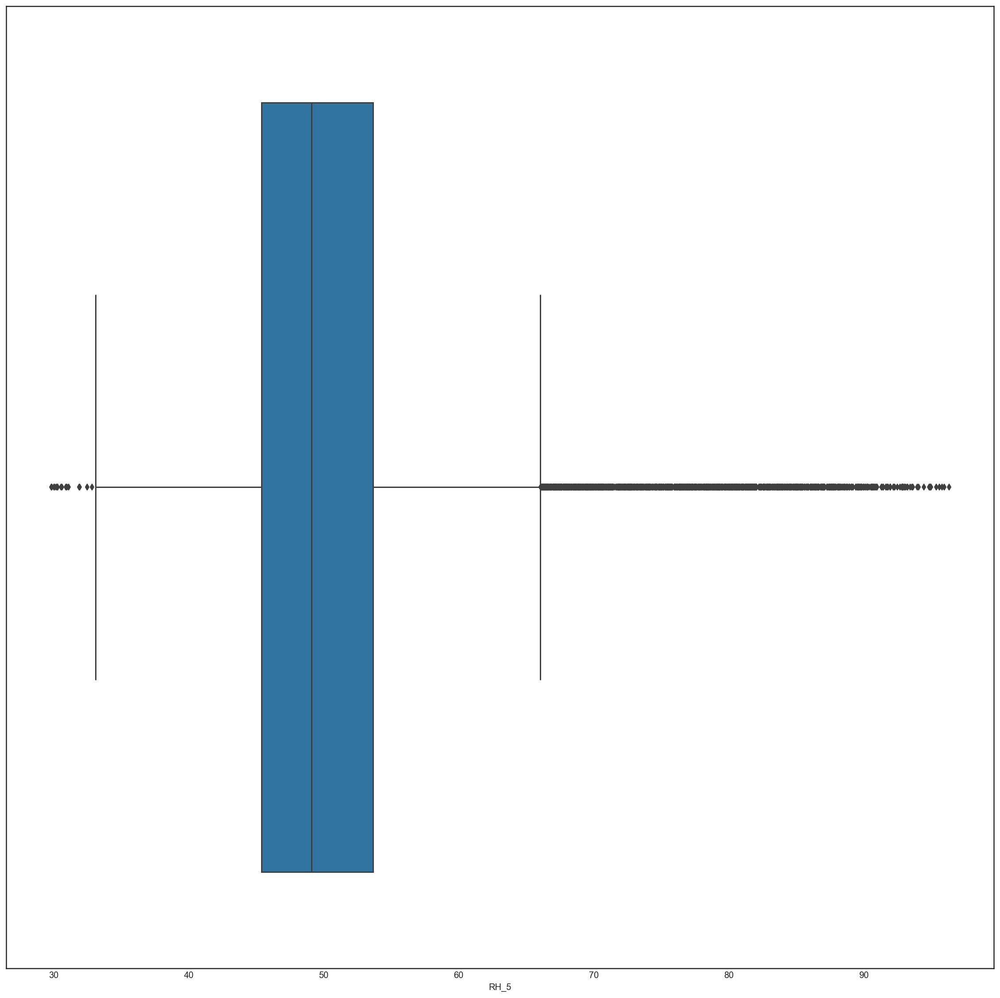

In [78]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax8 = sns.boxplot(x="RH_5", data=phase)

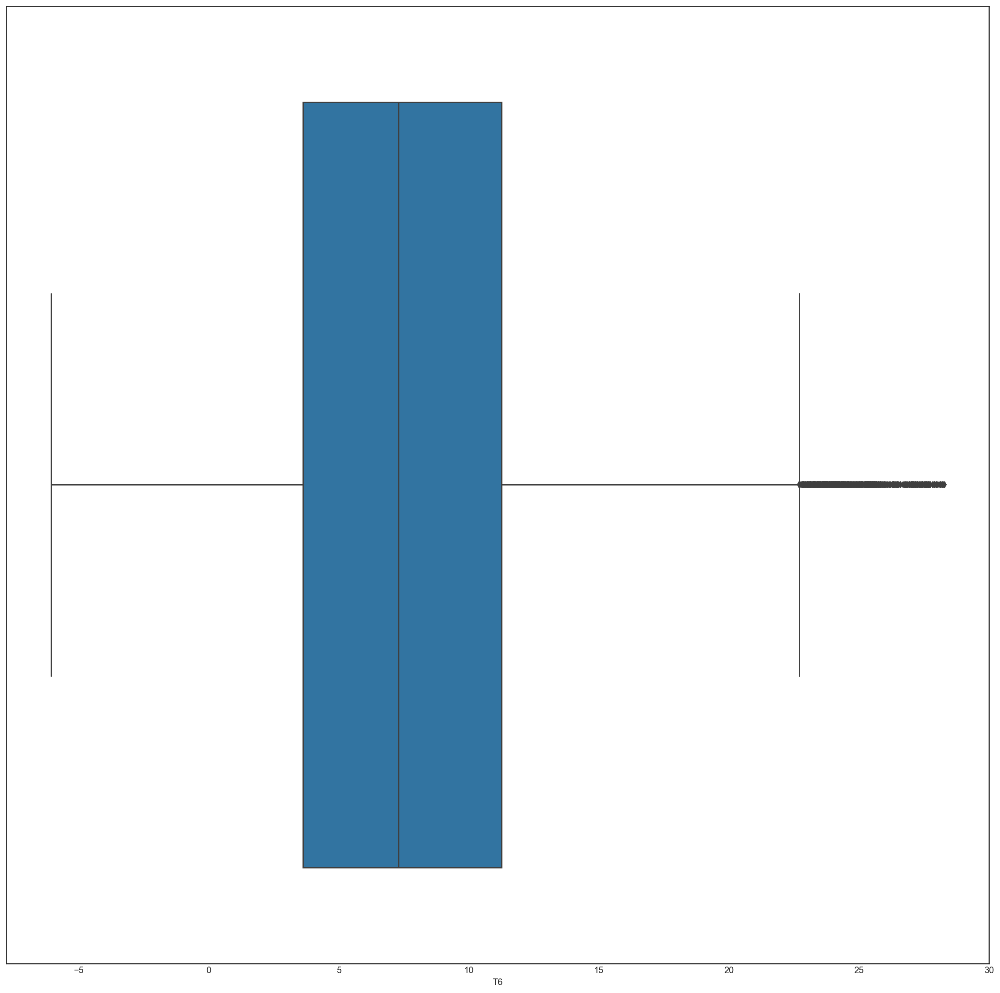

In [79]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax9 = sns.boxplot(x="T6", data=phase)

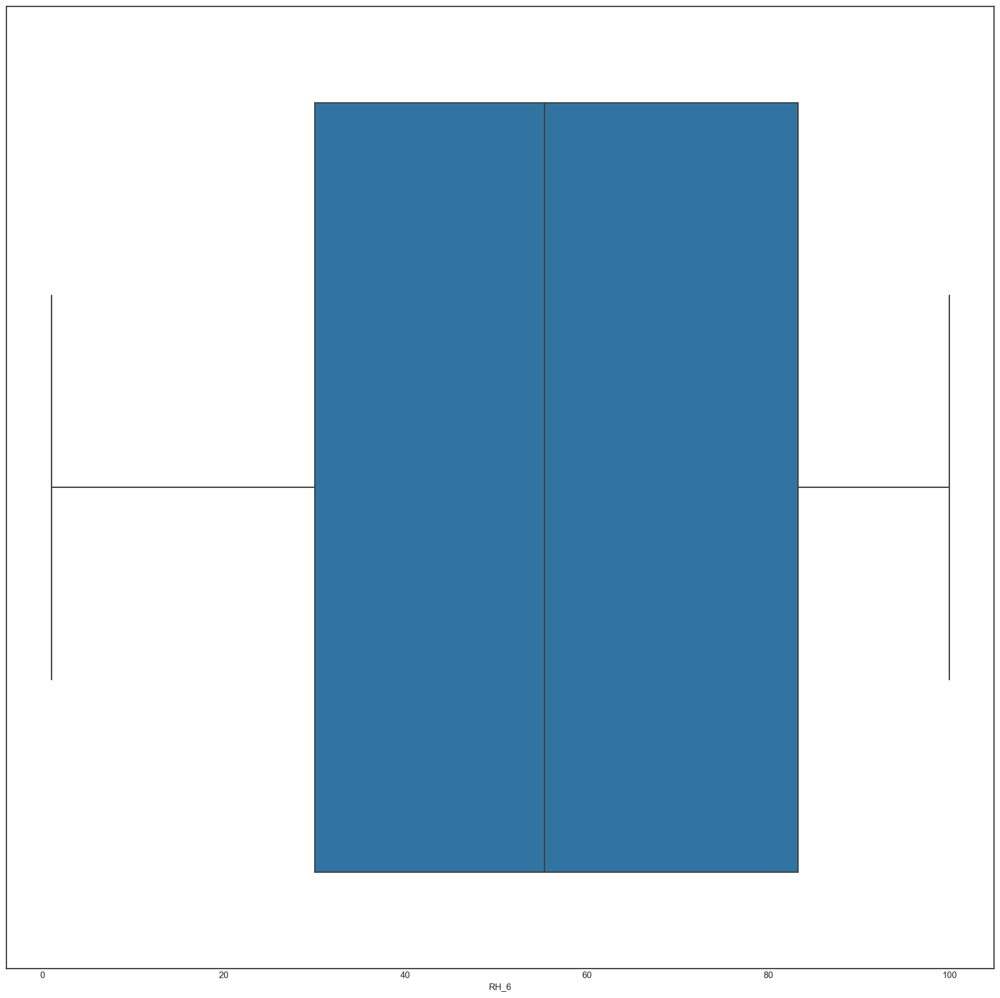

In [80]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax10 = sns.boxplot(x="RH_6", data=phase)

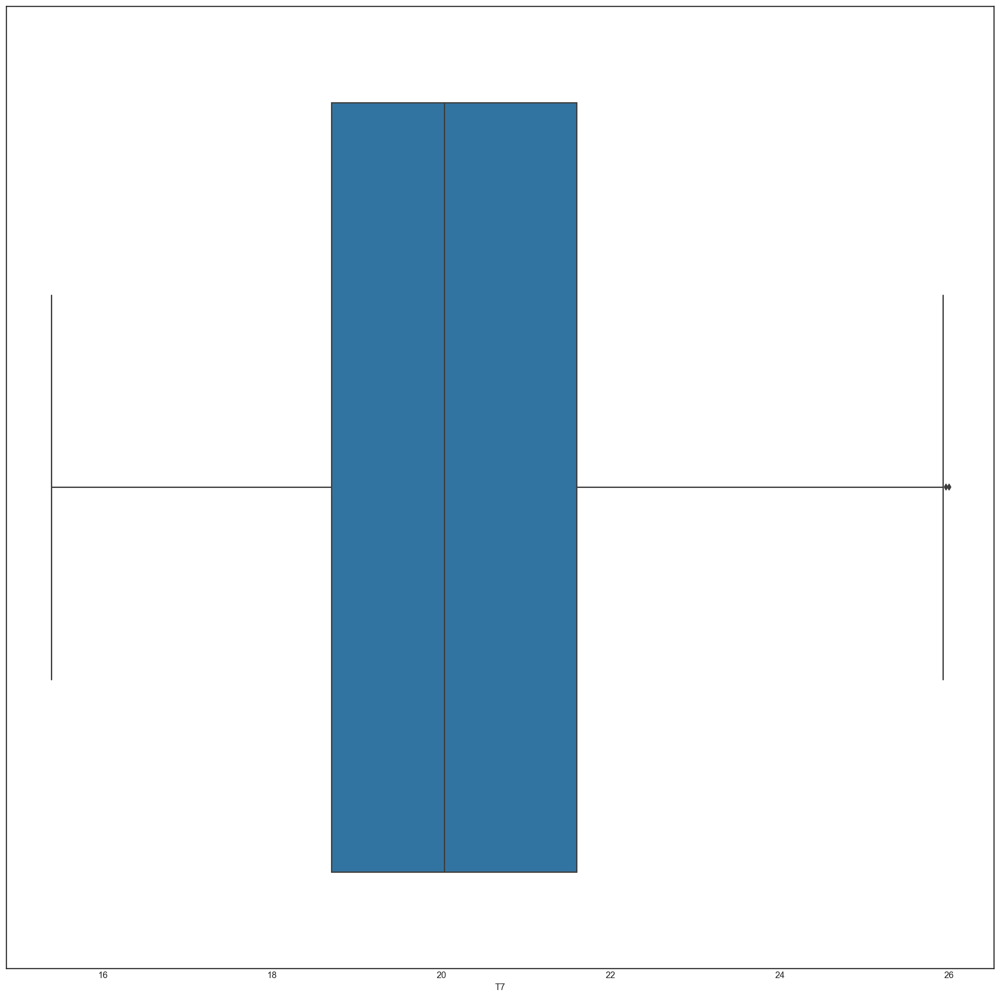

In [81]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax11 = sns.boxplot(x="T7", data=phase)

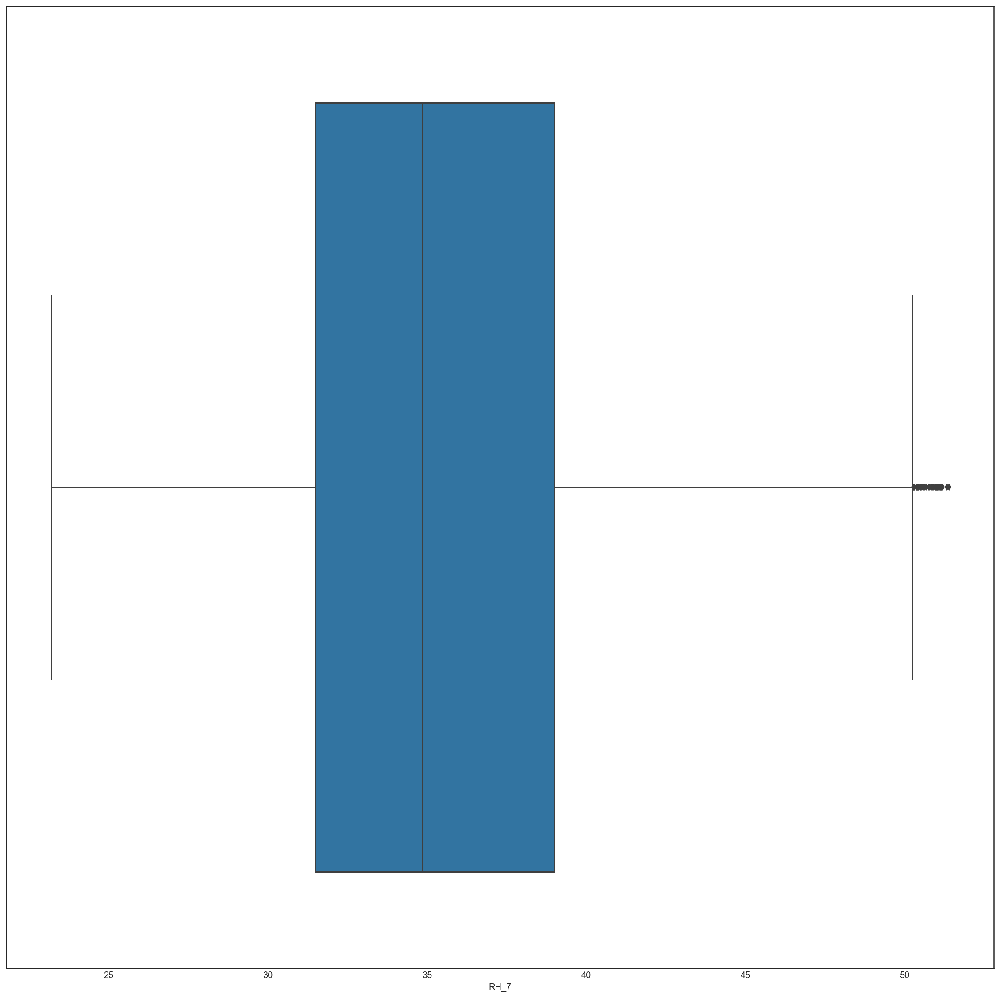

In [82]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax12 = sns.boxplot(x="RH_7", data=phase)

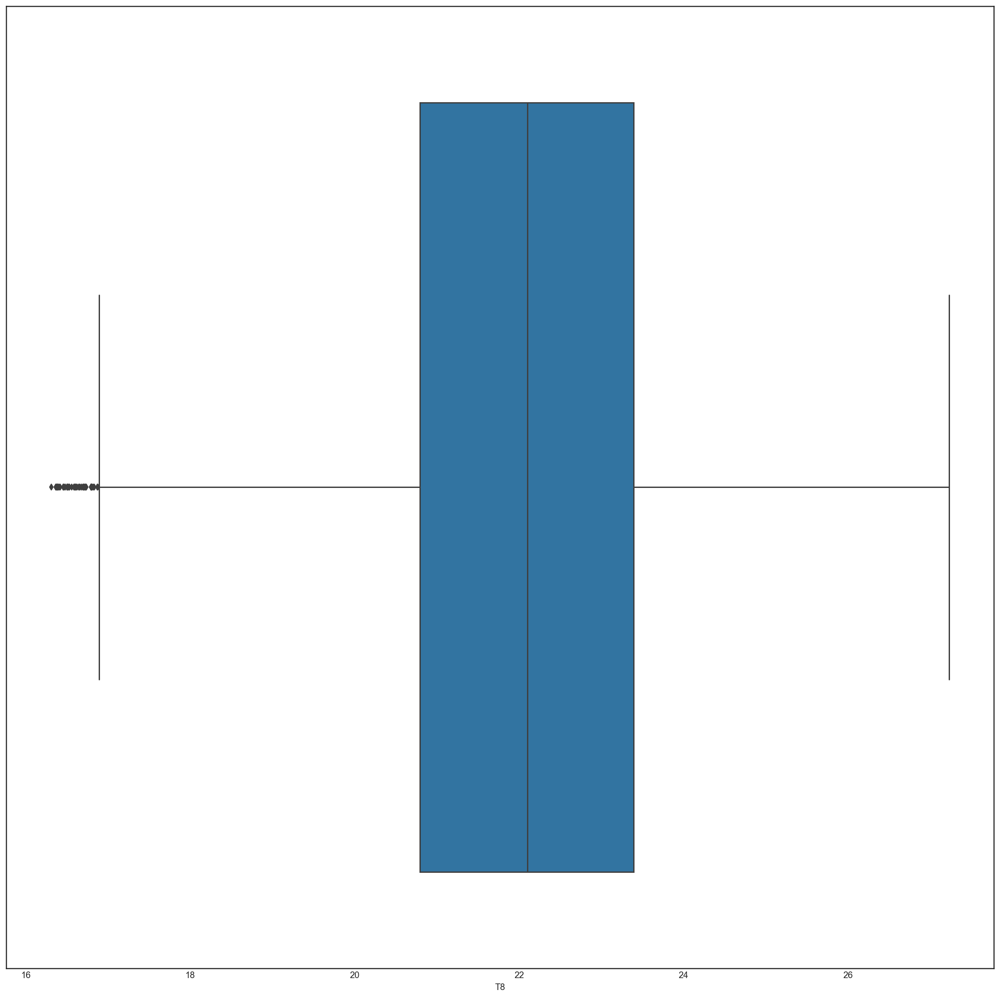

In [83]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax13 = sns.boxplot(x="T8", data=phase)

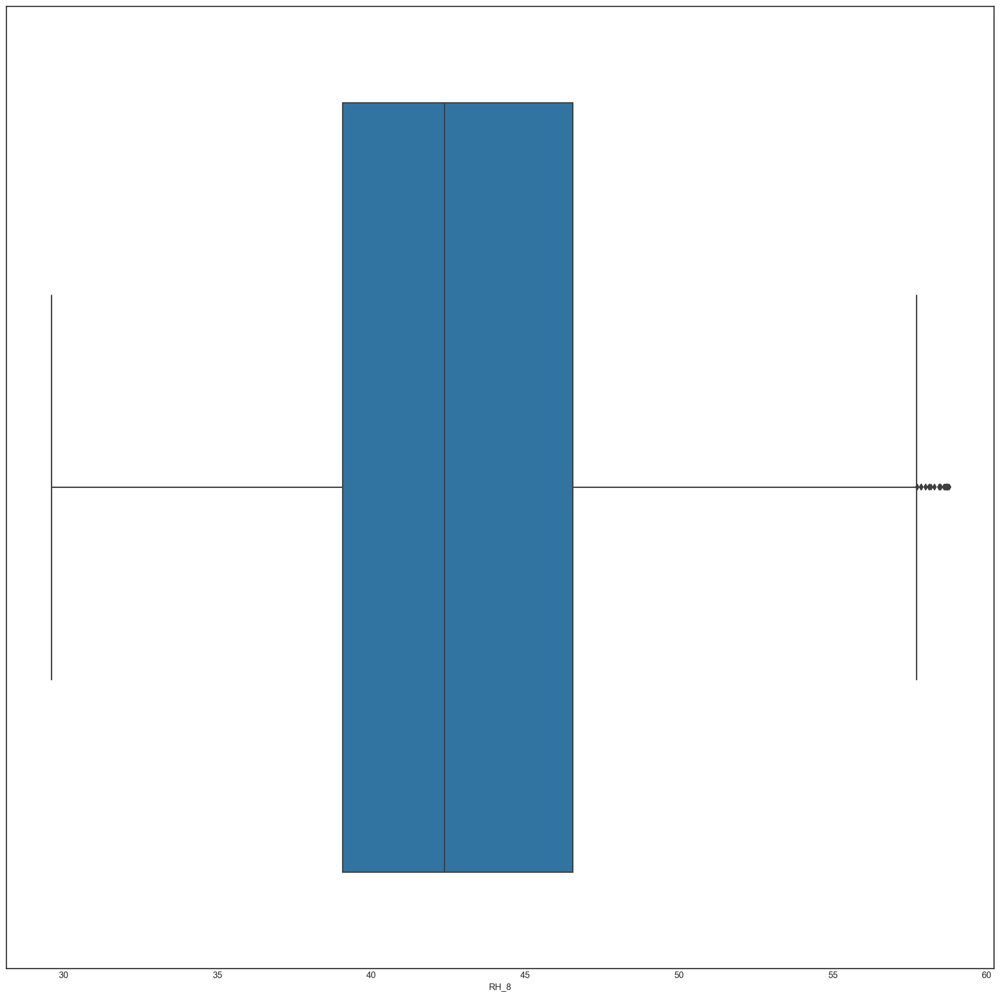

In [84]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax14 = sns.boxplot(x="RH_8", data=phase)

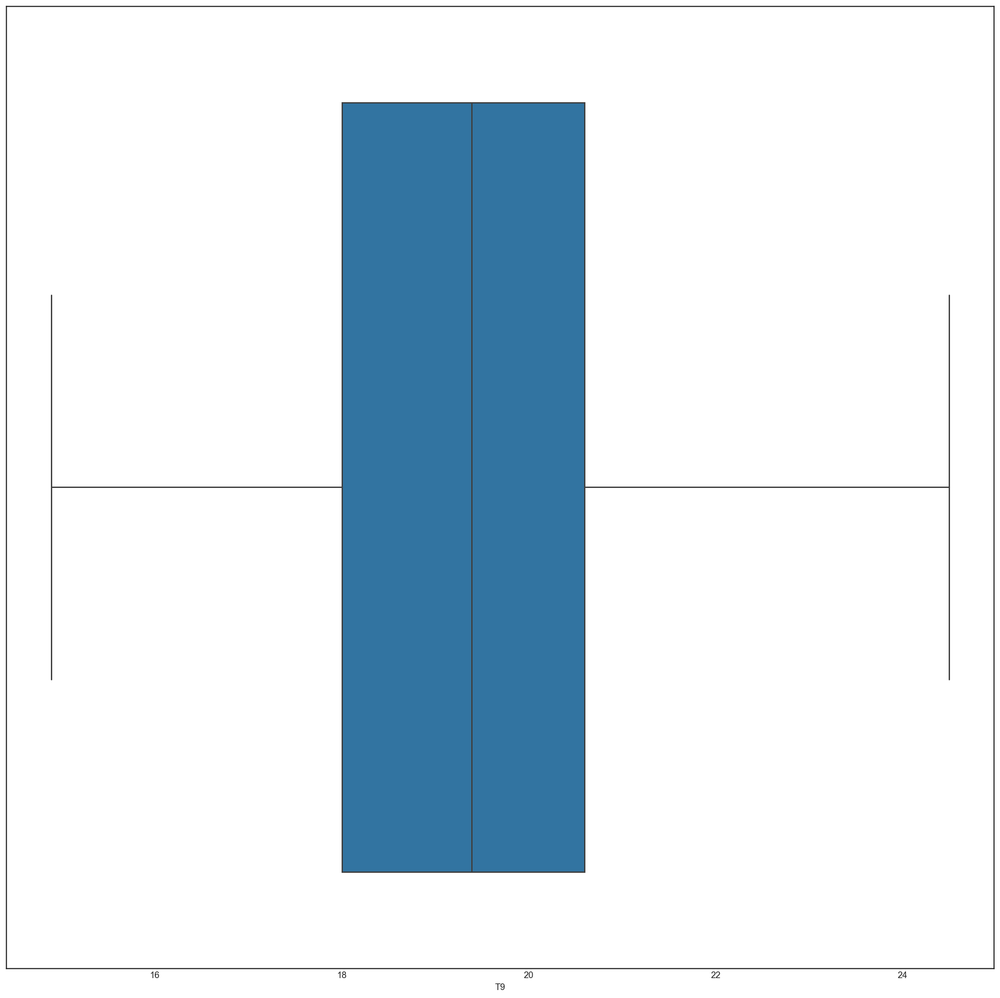

In [85]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax15 = sns.boxplot(x="T9", data=phase)

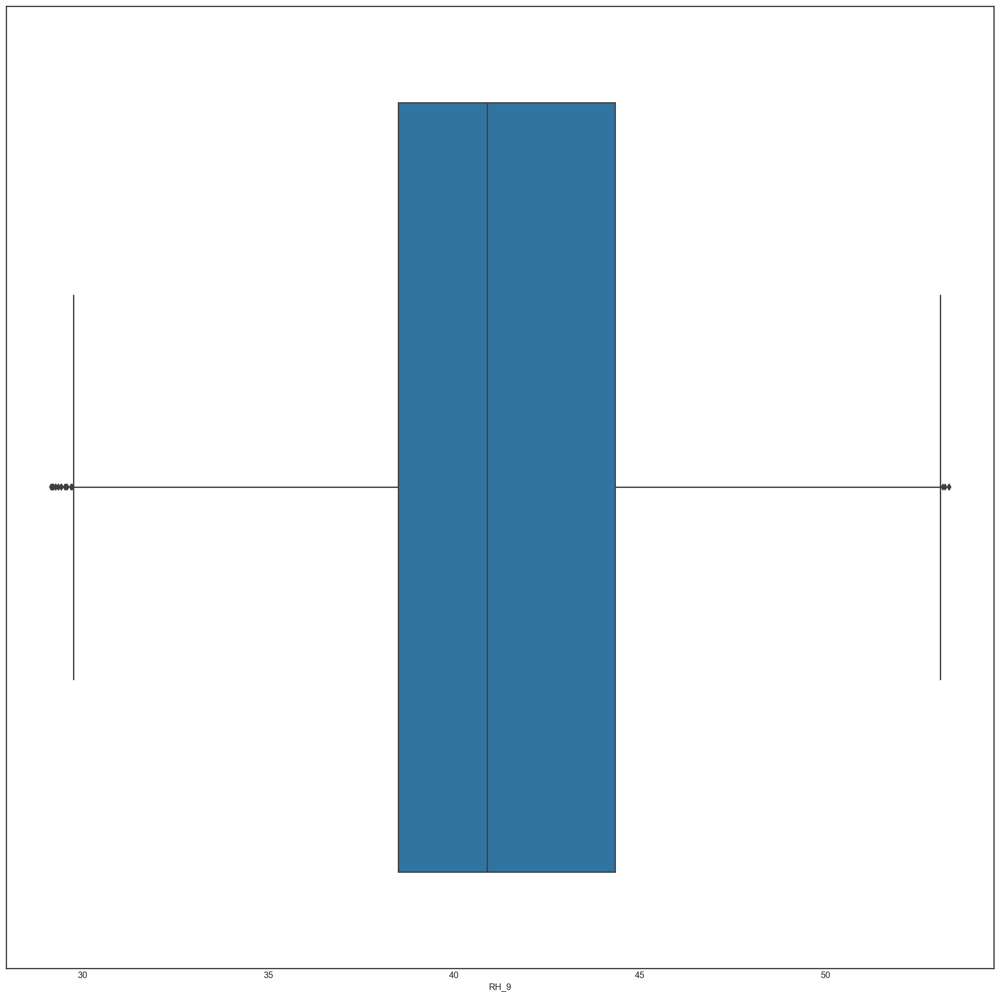

In [86]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax16 = sns.boxplot(x="RH_9", data=phase)

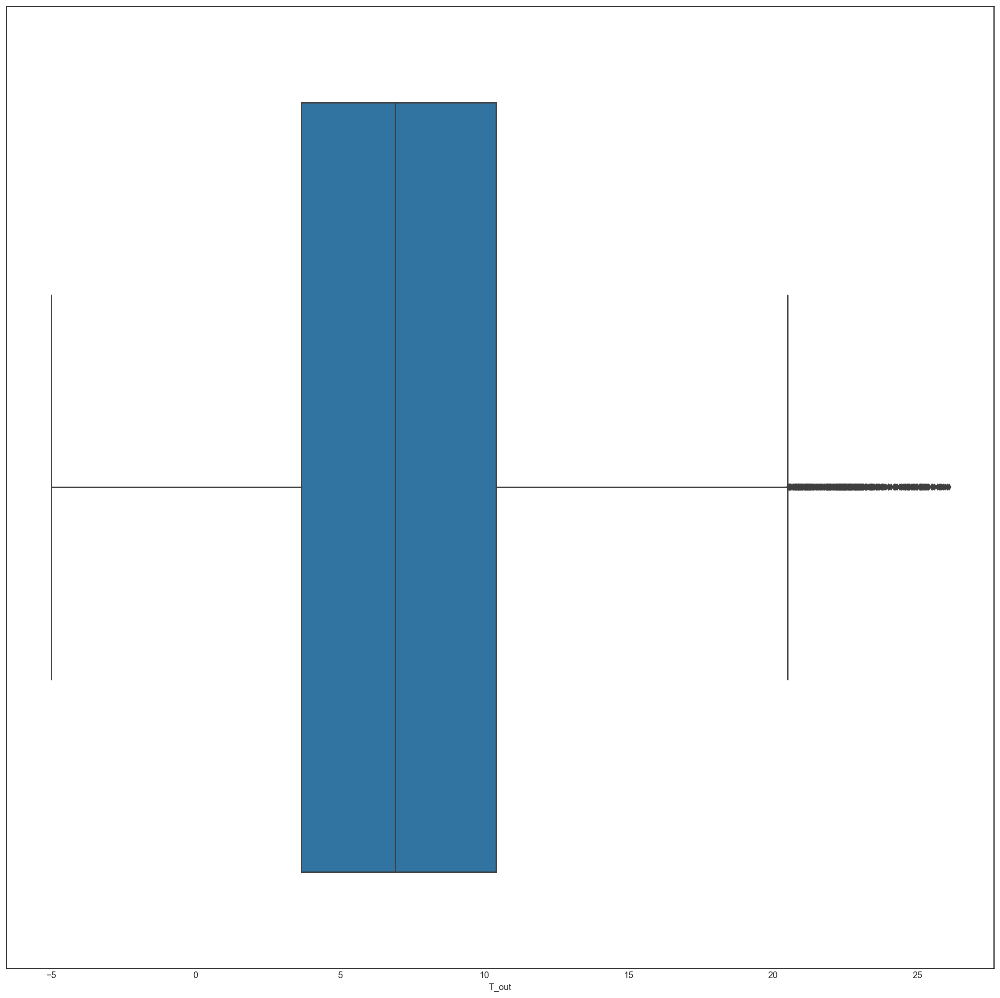

In [87]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax17 = sns.boxplot(x="T_out", data=phase)

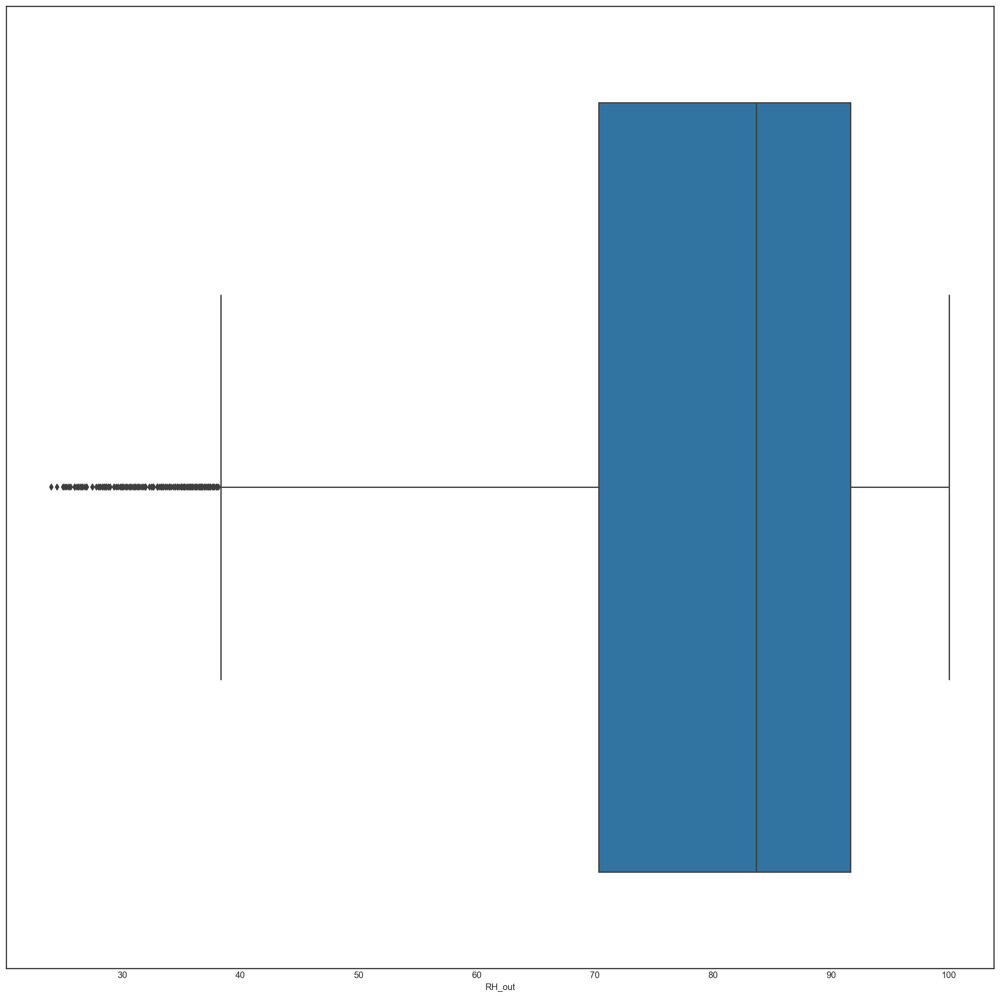

In [88]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax18 = sns.boxplot(x="RH_out", data=phase)

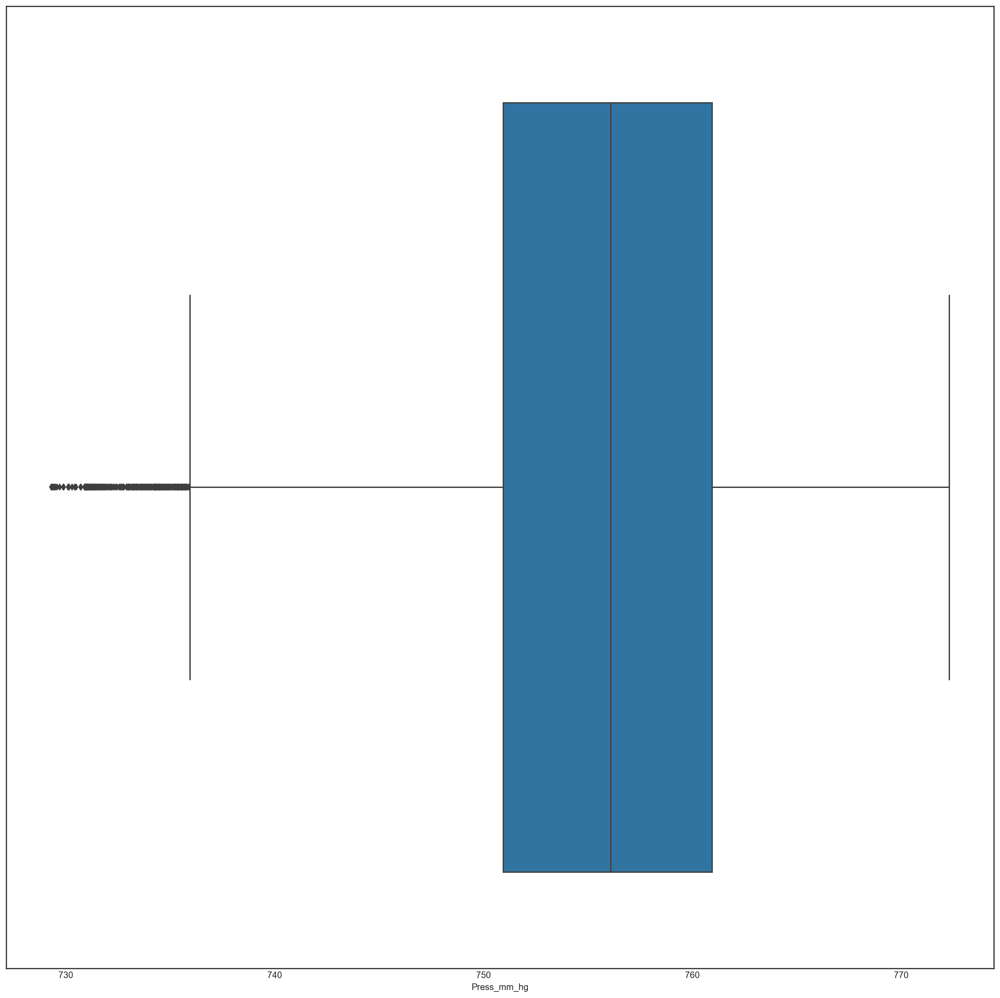

In [89]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax19 = sns.boxplot(x="Press_mm_hg", data=phase)

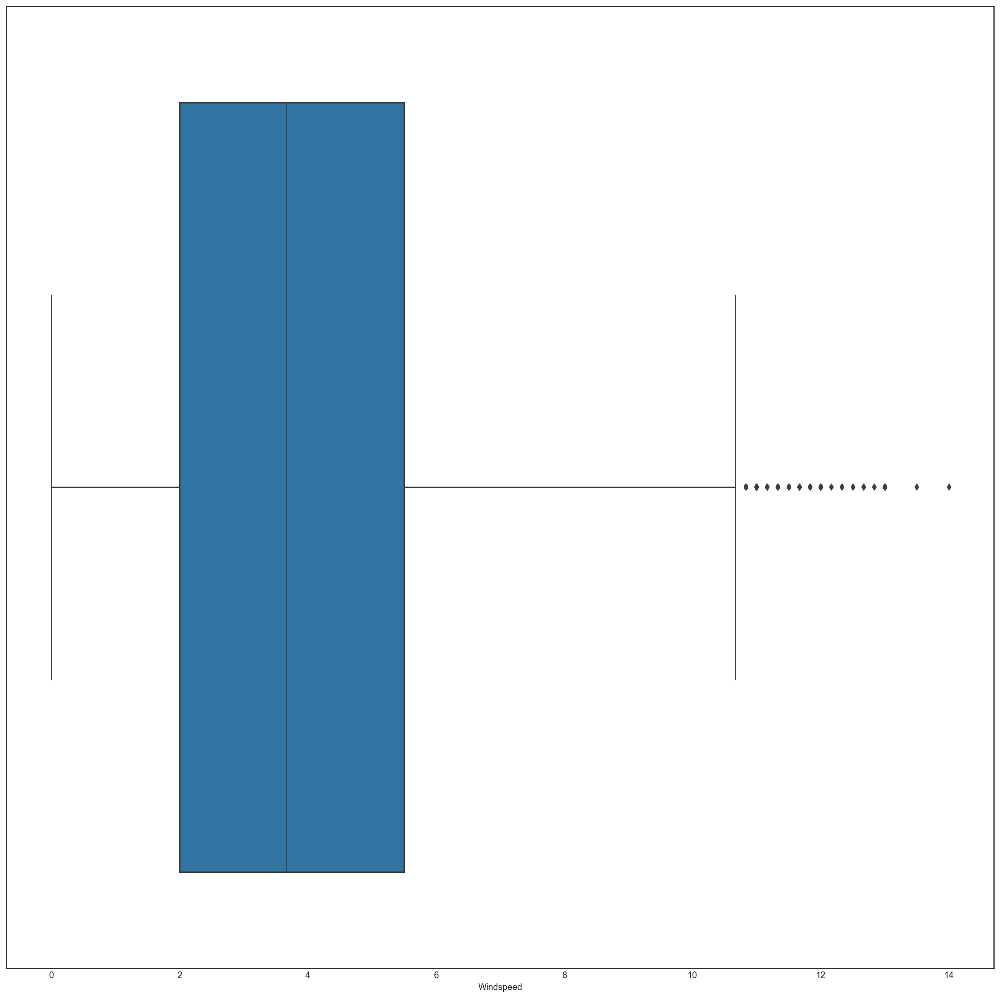

In [90]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax20 = sns.boxplot(x="Windspeed", data=phase)

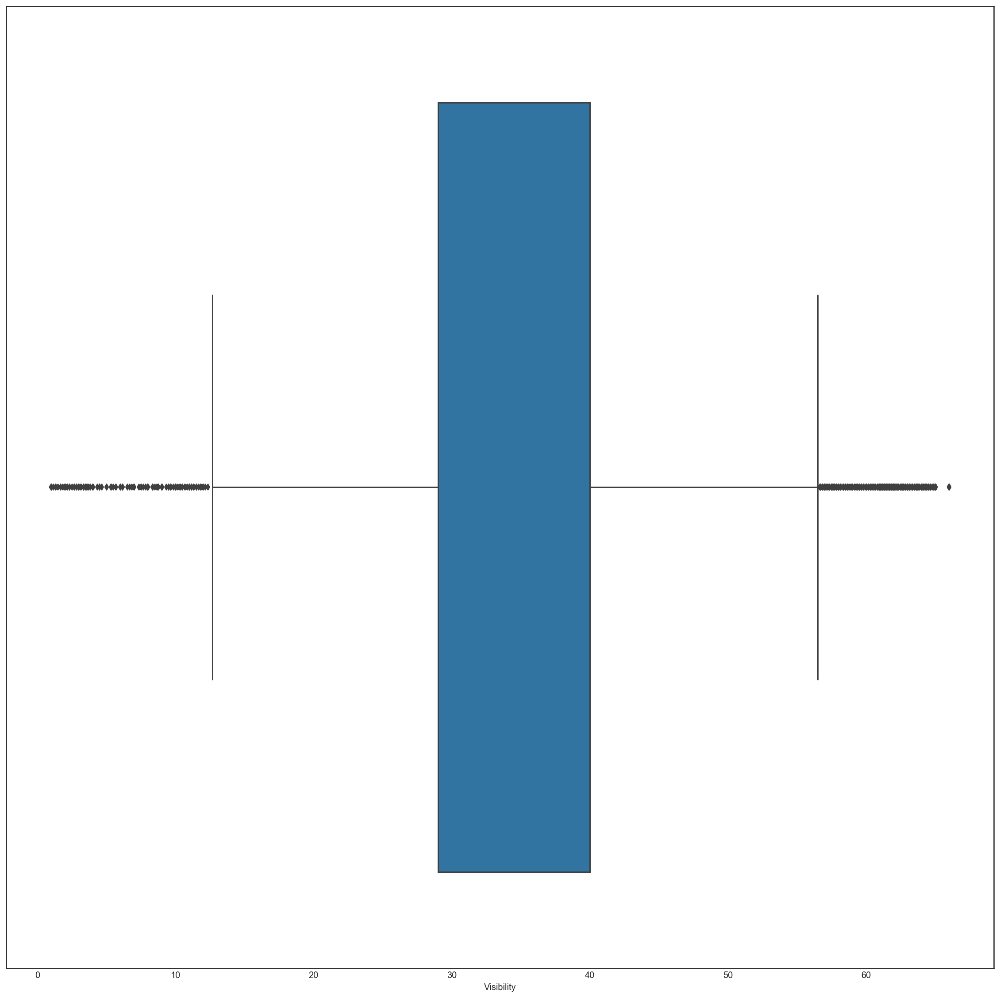

In [91]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax21 = sns.boxplot(x="Visibility", data=phase)

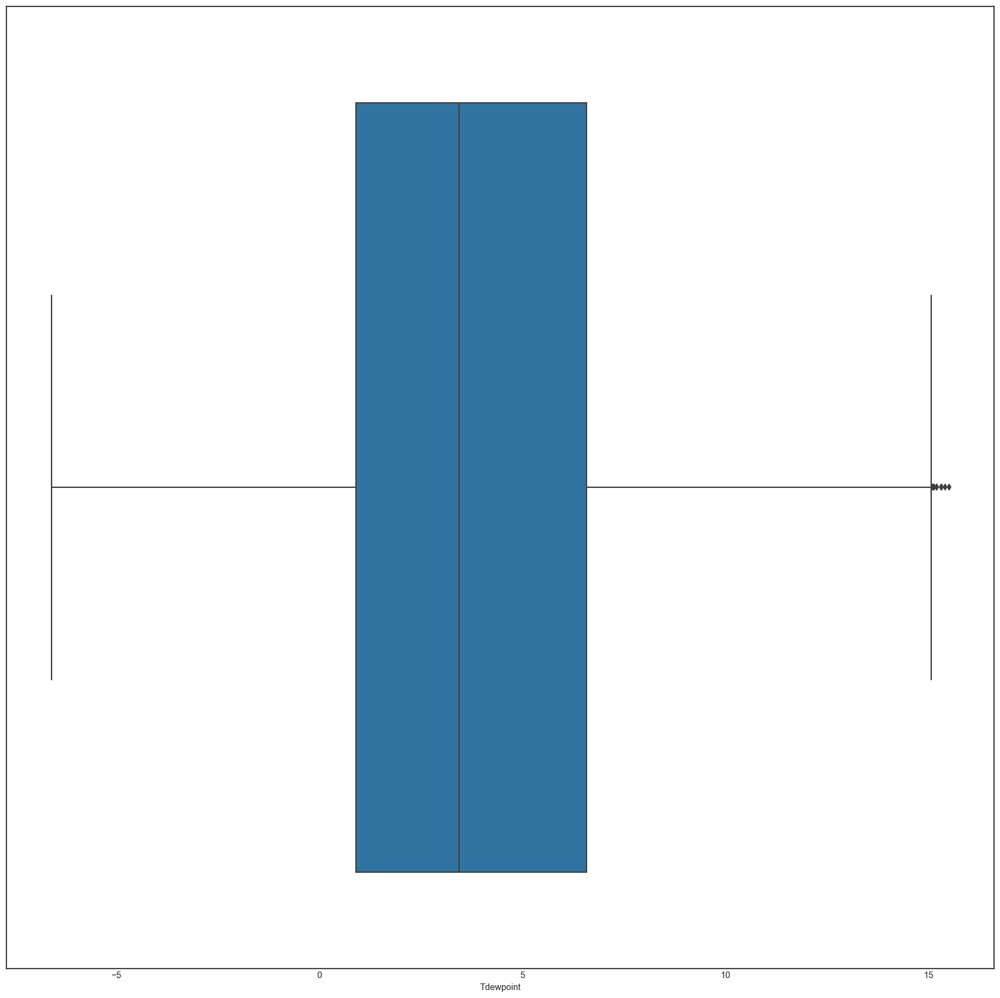

In [92]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax22 = sns.boxplot(x="Tdewpoint", data=phase)

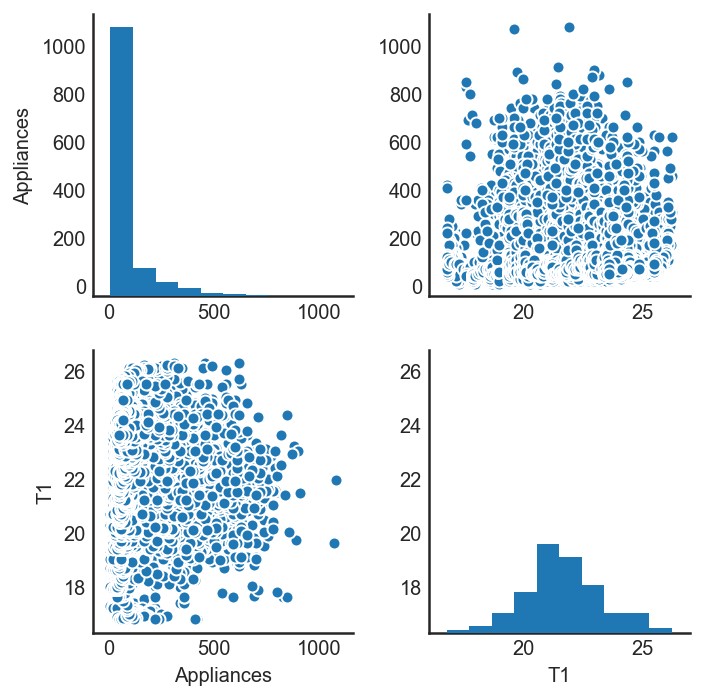

In [93]:
cc234 = sns.pairplot(phase, vars=["Appliances","T1"])

In [35]:
phase.dtypes

month                   int64
day_number              int64
datetime       datetime64[ns]
period                  int64
Appliances              int64
lights                  int64
T1                    float64
RH_1                  float64
T2                    float64
RH_2                  float64
T3                    float64
RH_3                  float64
T4                    float64
RH_4                  float64
T5                    float64
RH_5                  float64
T6                    float64
RH_6                  float64
T7                    float64
RH_7                  float64
T8                    float64
RH_8                  float64
T9                    float64
RH_9                  float64
T_out                 float64
Press_mm_hg           float64
RH_out                float64
Windspeed             float64
Visibility            float64
Tdewpoint             float64
rv1                   float64
rv2                   float64
Week_no                 int64
Total     

In [34]:
phase.drop(['day_of_week','hour','min'],axis=1,inplace=True)

# Logarithmic transformation of Appliances

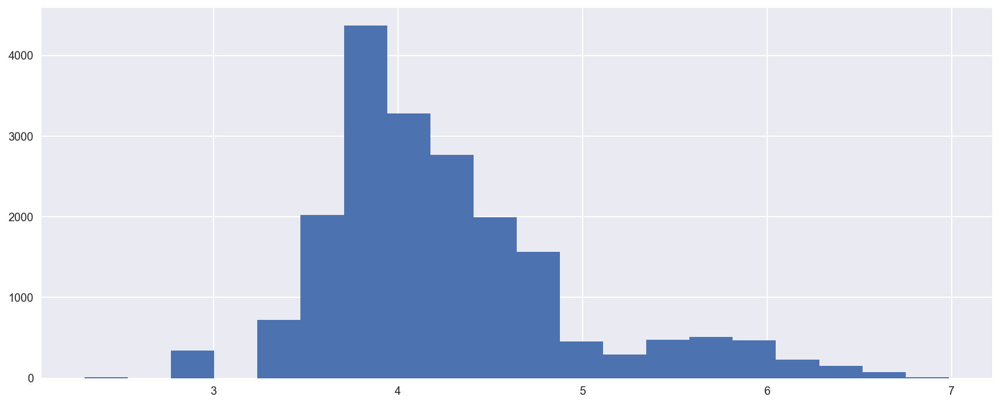

In [212]:
import numpy as np
phase['Appliances'] = np.log(phase['Appliances'])
phase['Appliances'].hist(bins=20)

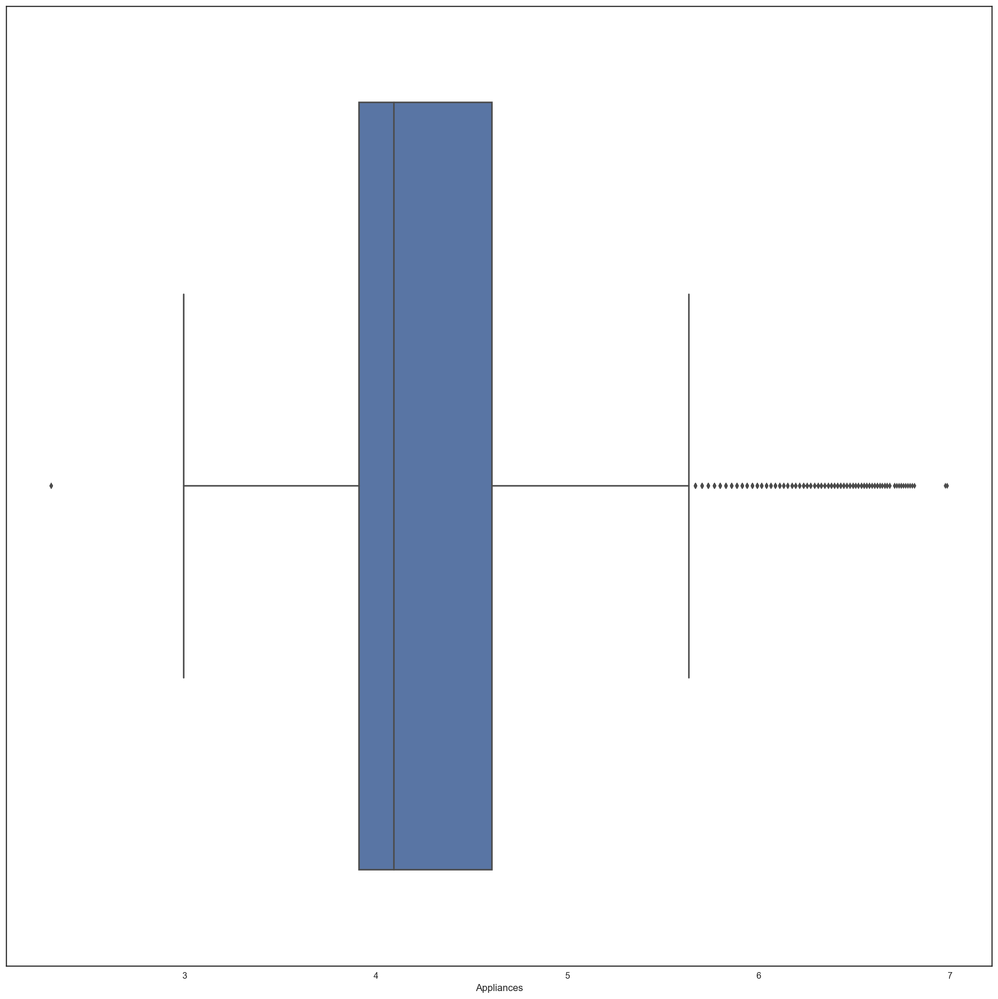

In [213]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax21 = sns.boxplot(x="Appliances", data=phase)

# Logarithmic transformation of Press_mm_hg

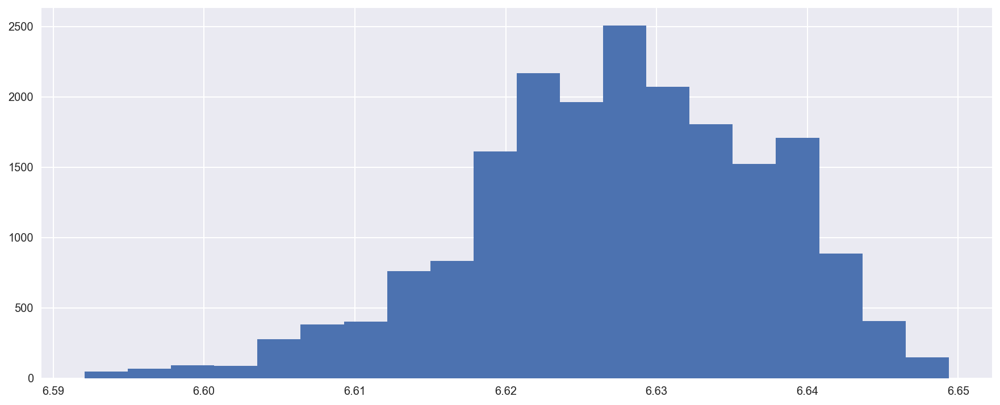

In [218]:
import numpy as np
phase['Press_mm_hg'] = np.log(phase['Press_mm_hg'])
phase['Press_mm_hg'].hist(bins=20)

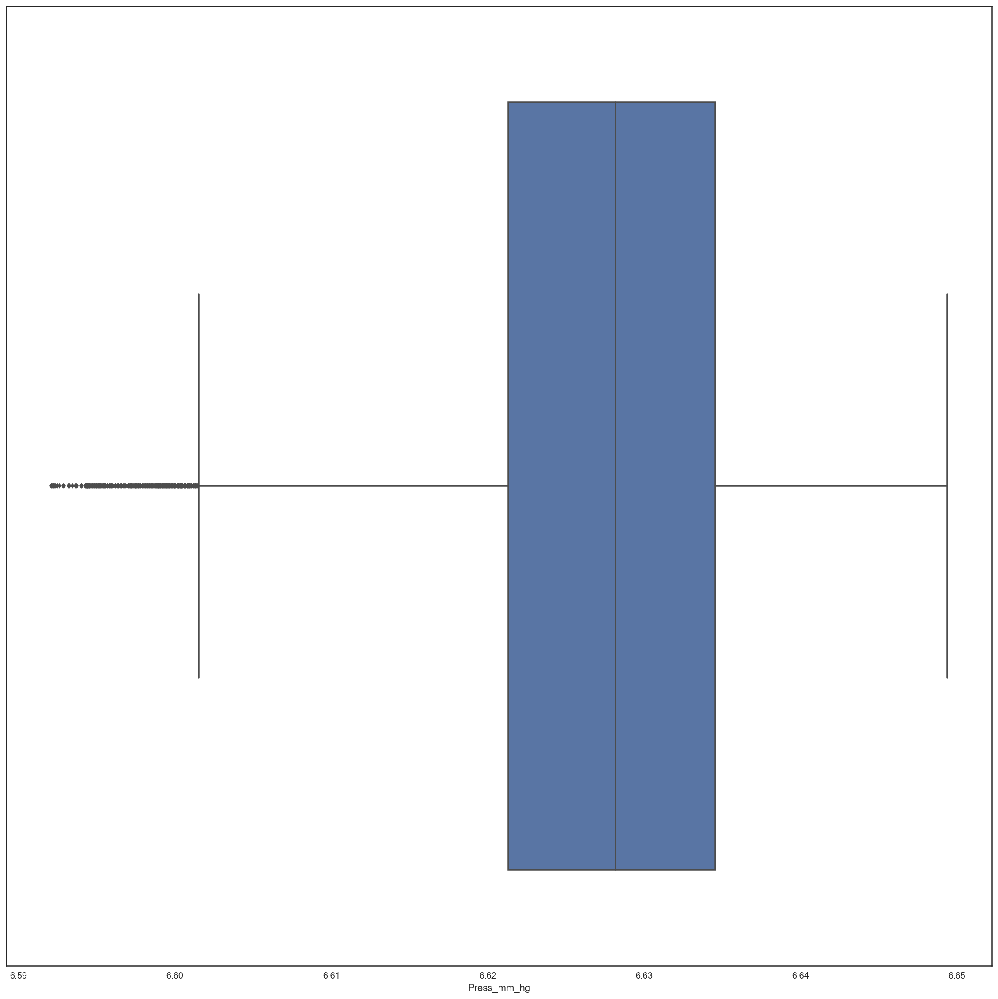

In [219]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax21 = sns.boxplot(x="Press_mm_hg", data=phase)

 # Logarithmic transformation of Visibility

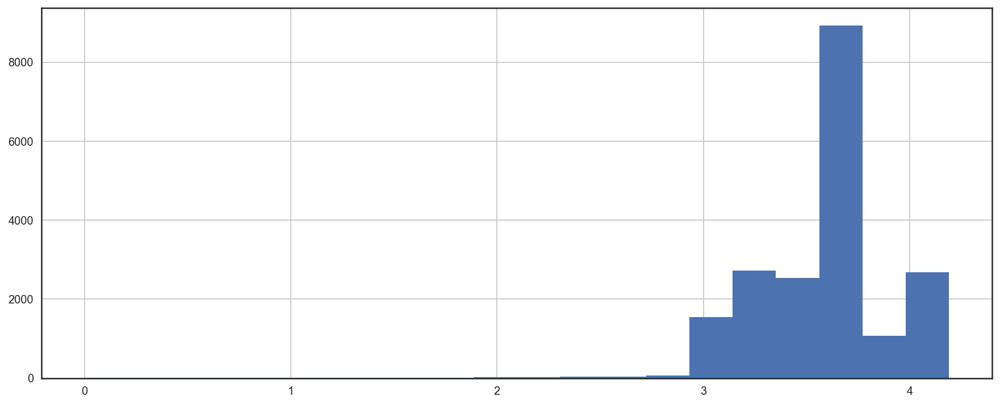

In [220]:
import numpy as np
phase['Visibility'] = np.log(phase['Visibility'])
phase['Visibility'].hist(bins=20)

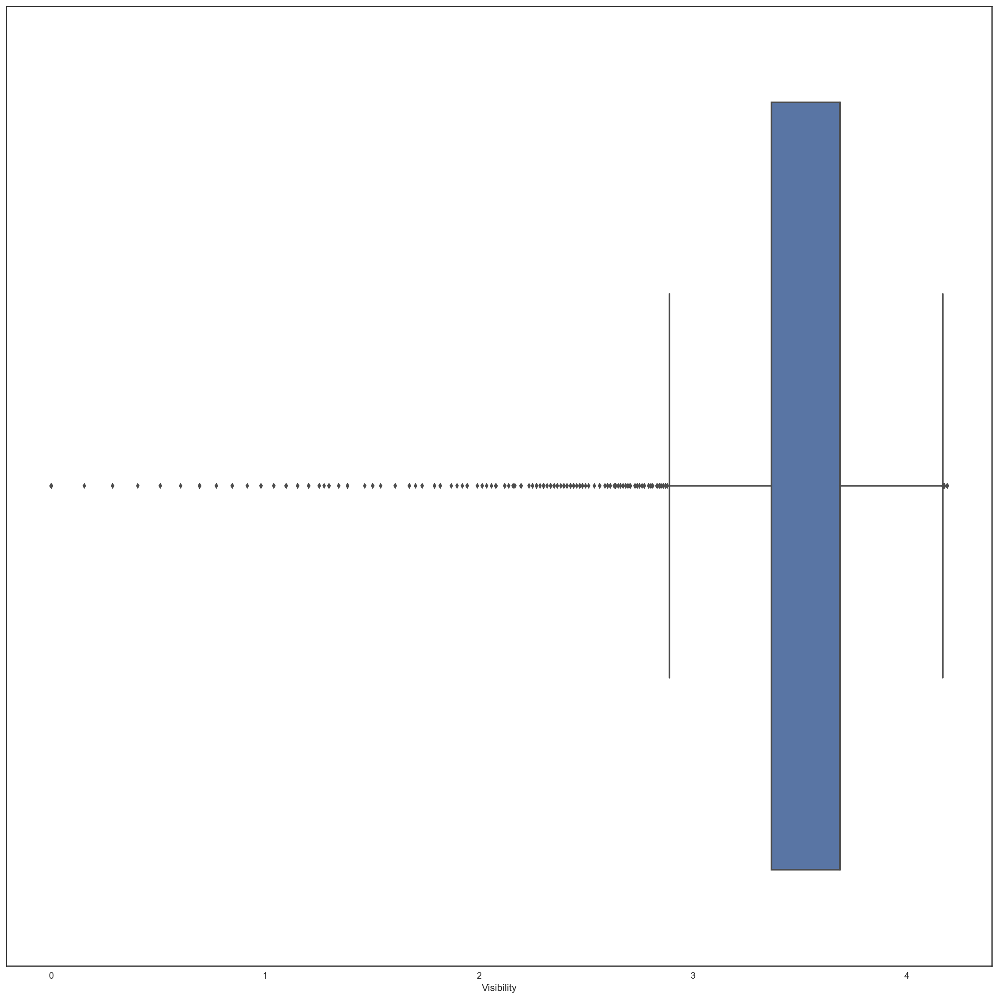

In [221]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax21 = sns.boxplot(x="Visibility", data=phase)

# Logarithmic transformation of Total

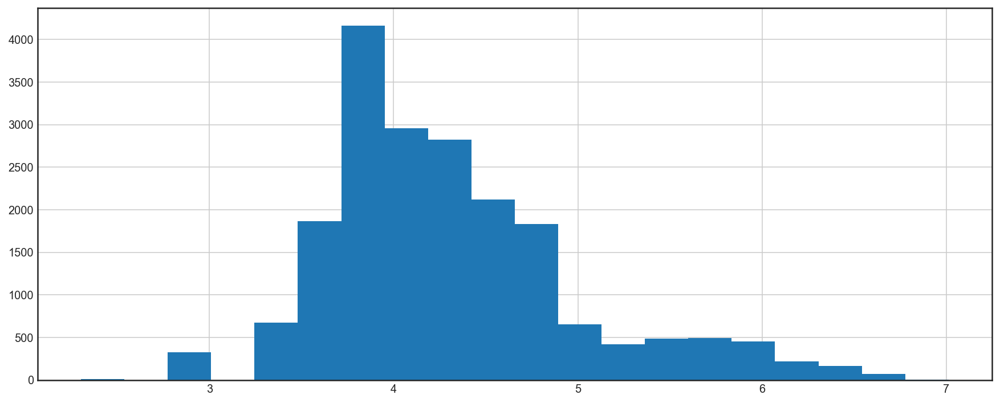

In [207]:
import numpy as np
phase['Total'] = np.log(phase['Total'])
phase['Total'].hist(bins=20)

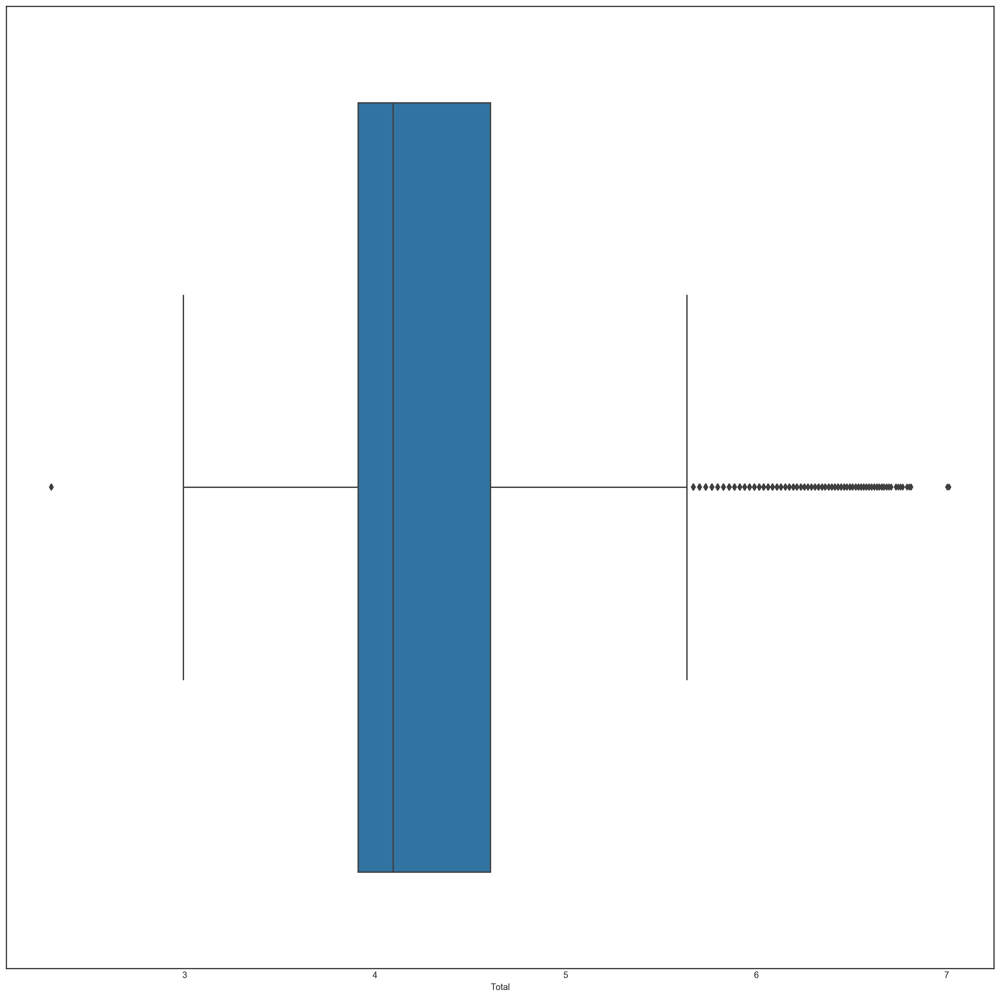

In [208]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax21 = sns.boxplot(x="Total", data=phase)

# logarithmic transformation of period

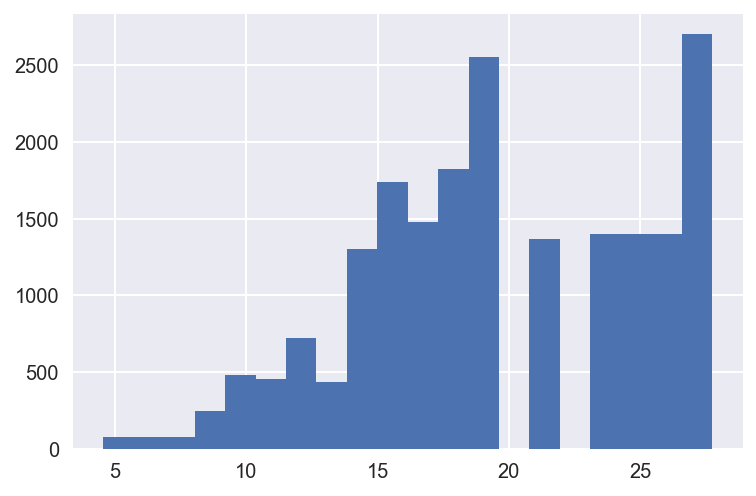

In [80]:
import numpy as np
phase['period'] = np.exp(phase['period'])
phase['period'].hist(bins=20)

In [ ]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax21 = sns.boxplot(x="Total", data=phase)

# Correlation between variables after transformation

## Continous-Continous
### See Scatter for corelation between them

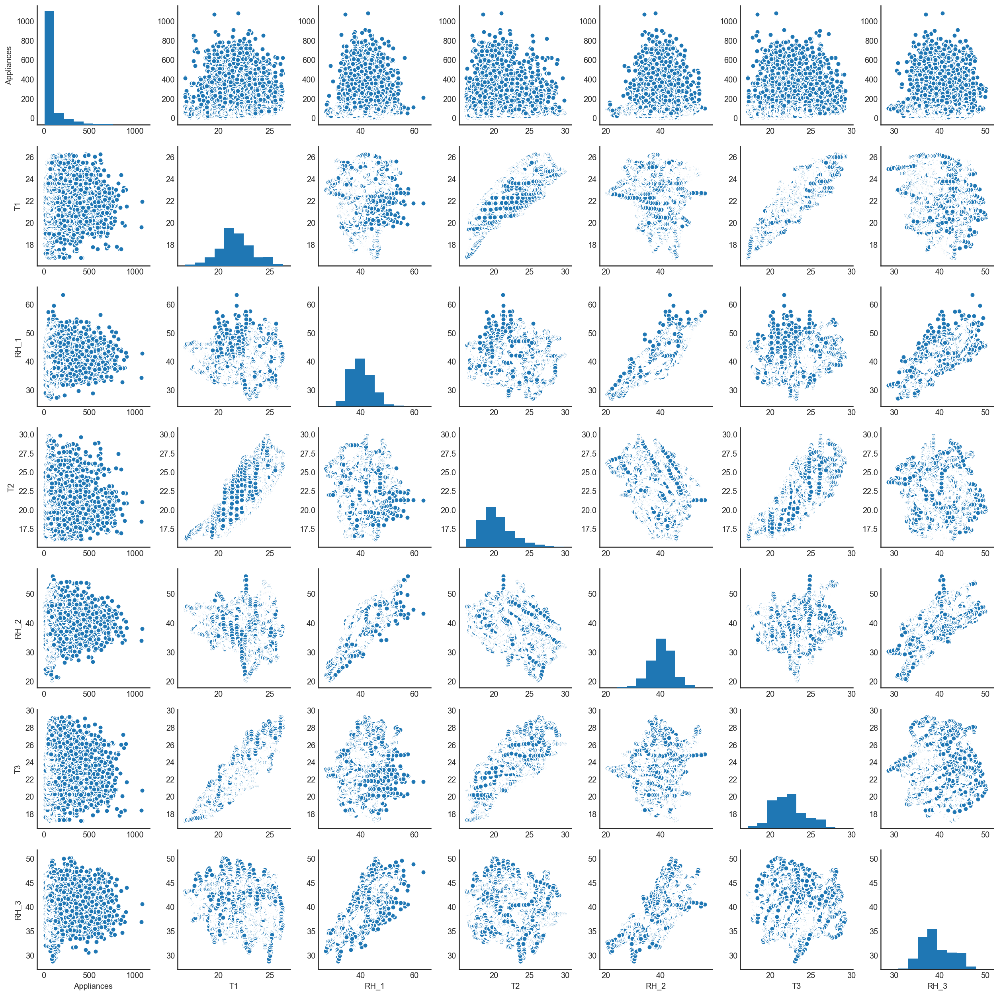

In [101]:
vg1 = sns.pairplot(phase, vars=["Appliances","T1", "RH_1", "T2", "RH_2", "T3", "RH_3"])

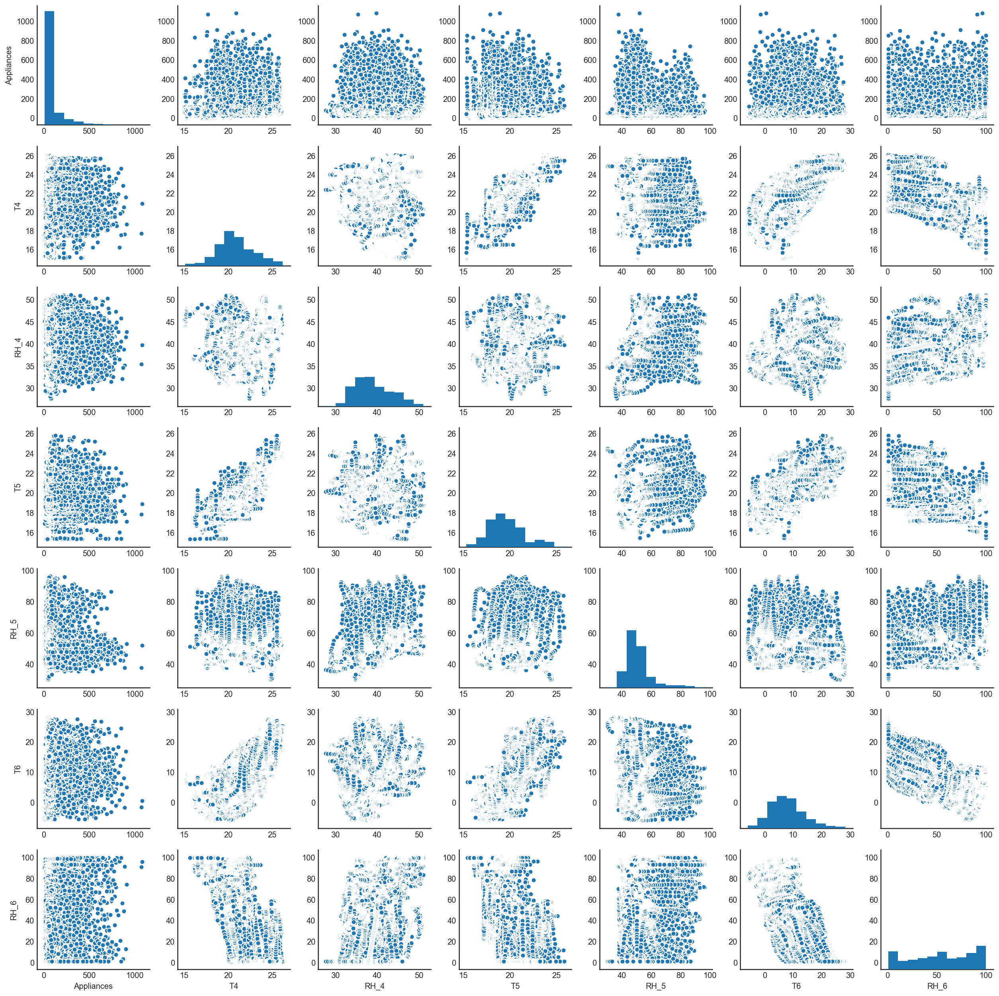

In [102]:
vg2 = sns.pairplot(phase, vars=["Appliances", "T4", "RH_4", "T5", "RH_5", "T6", "RH_6"])

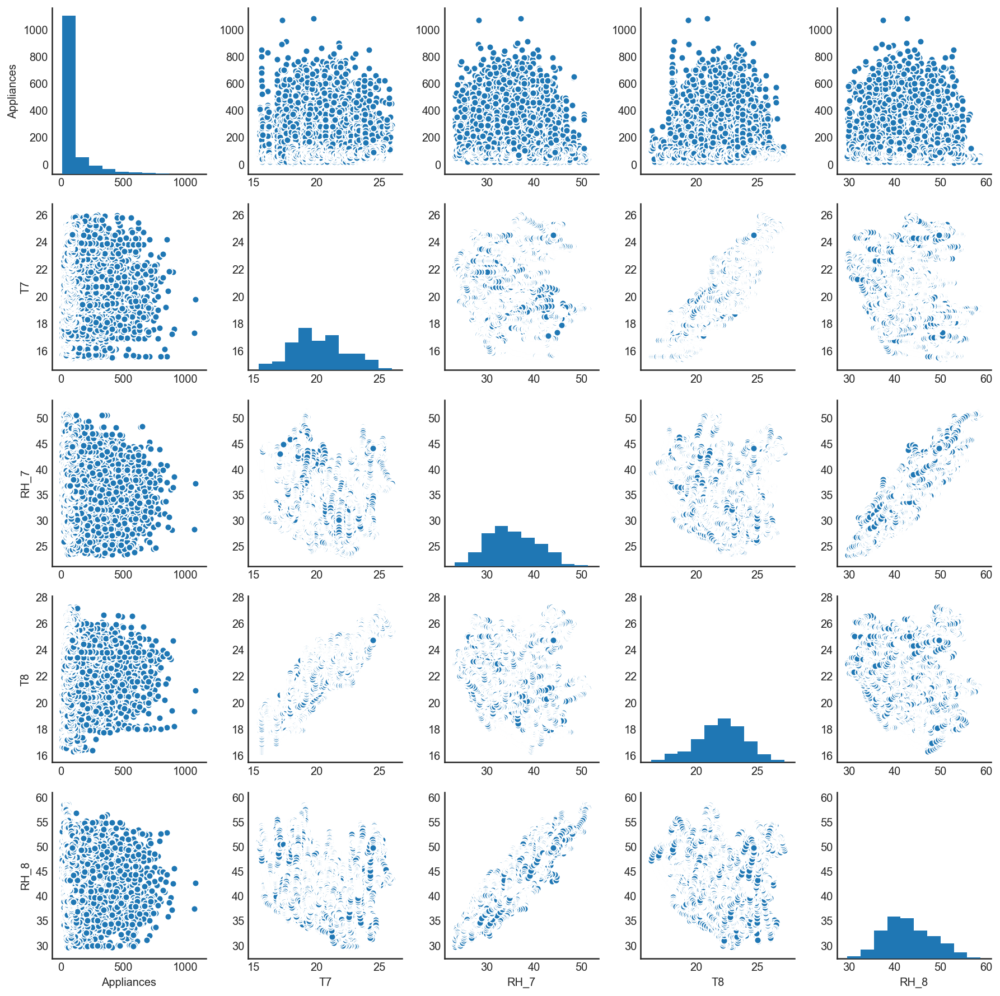

In [103]:
vg3 = sns.pairplot(phase, vars=["Appliances","T7", "RH_7", "T8","RH_8"])

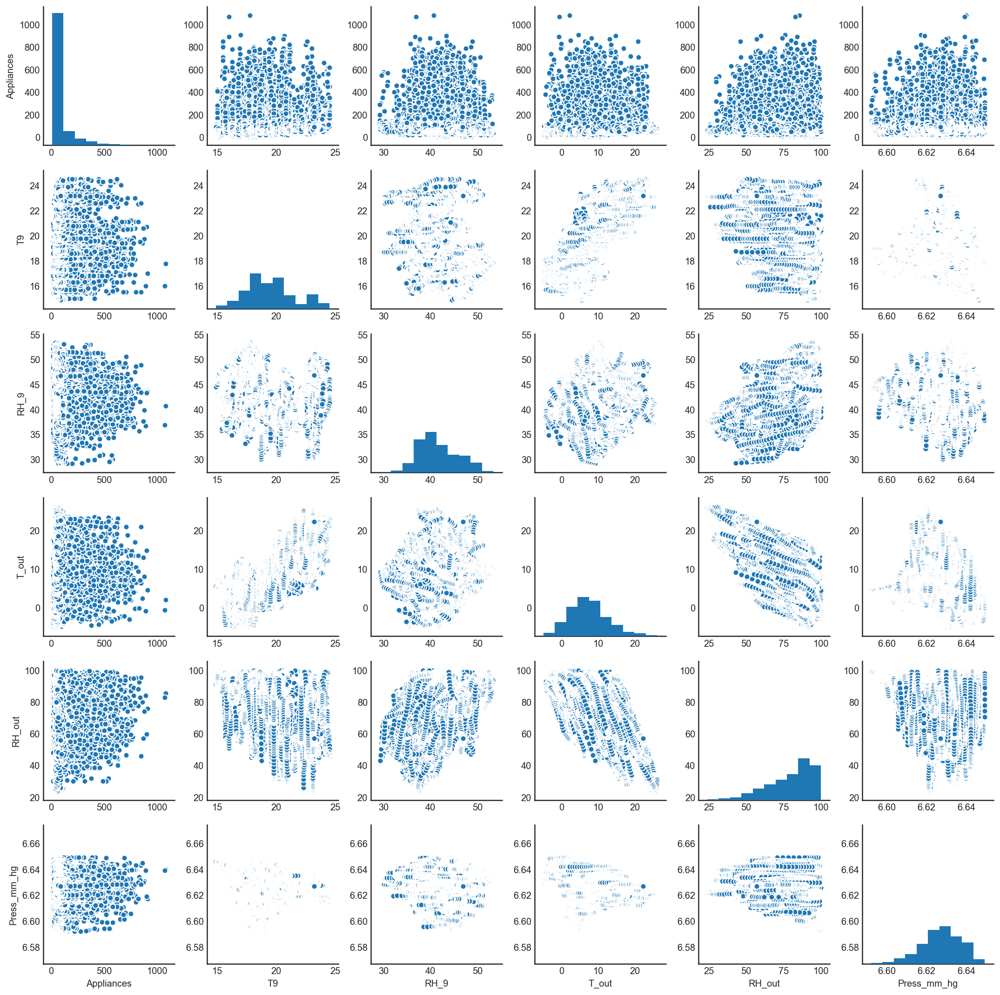

In [104]:
vg4 = sns.pairplot(phase, vars=["Appliances", "T9", "RH_9", "T_out", "RH_out", "Press_mm_hg"])

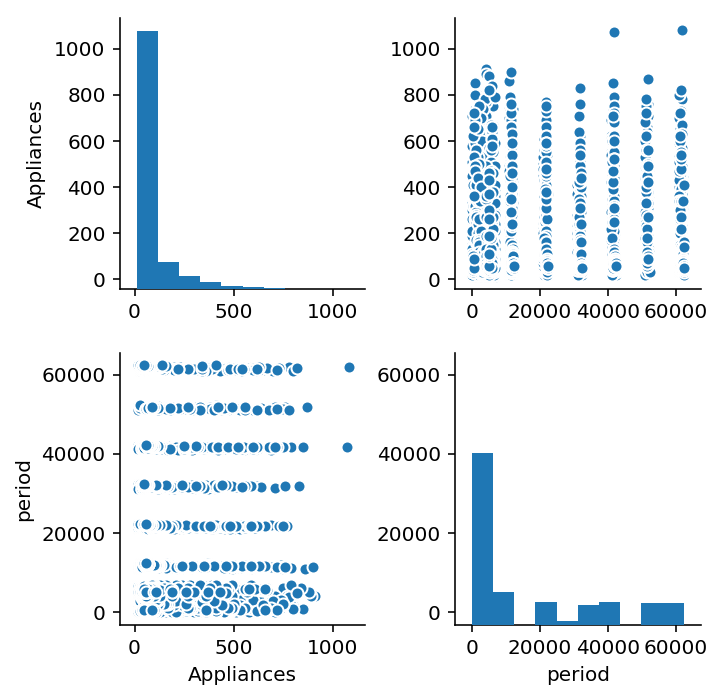

In [27]:
vg4 = sns.pairplot(phase, vars=["Appliances", "period"])

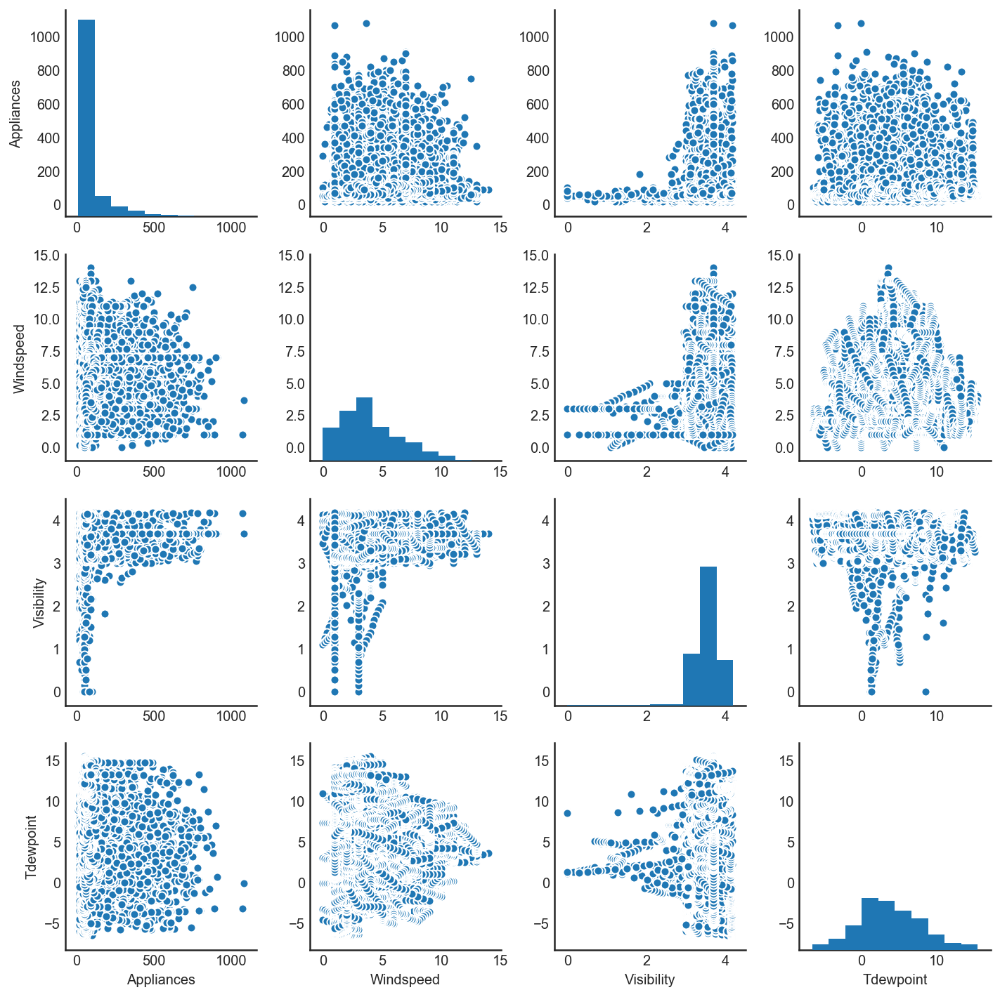

In [105]:
vg5 = sns.pairplot(phase, vars=["Appliances","Windspeed", "Visibility", "Tdewpoint"])

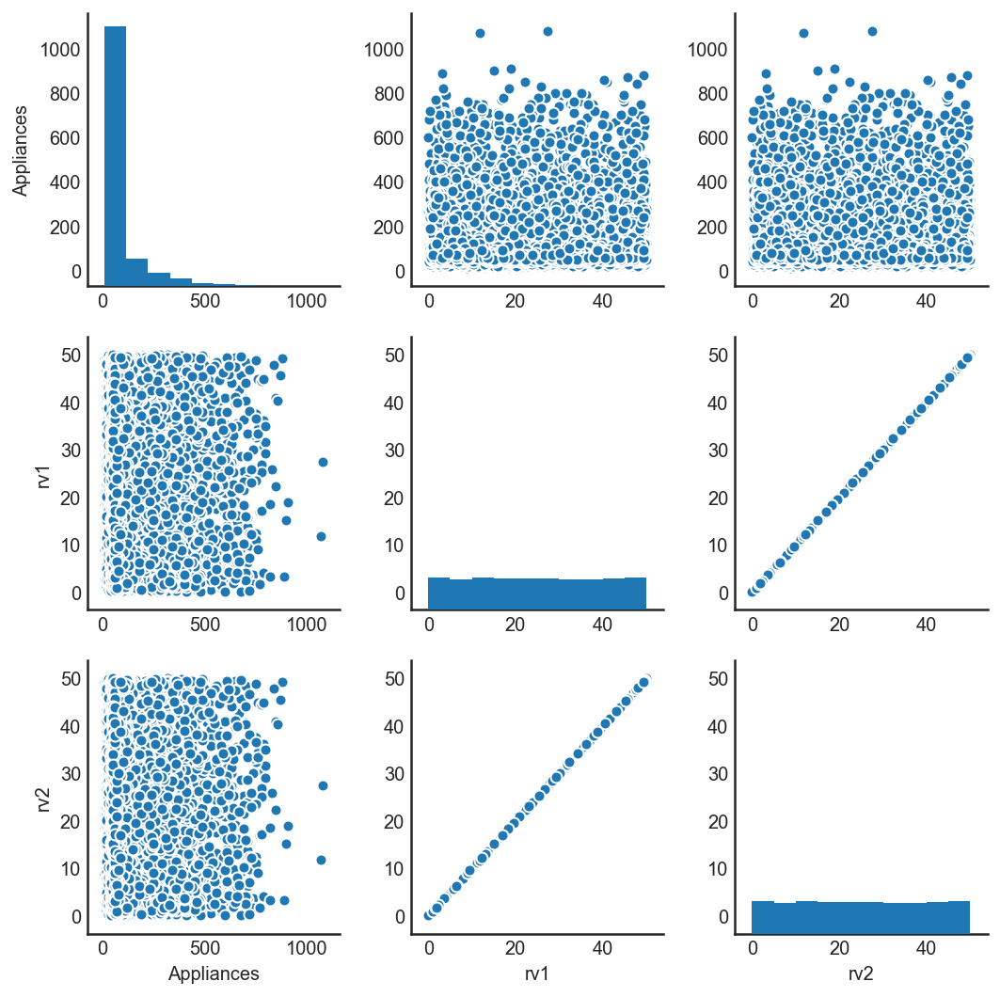

In [106]:
vg6 = sns.pairplot(phase, vars=["Appliances","rv1","rv2"])

## Categorical and Continous
### Box-plot
### For Statistical significance perform Z-test, T-test or ANOVA

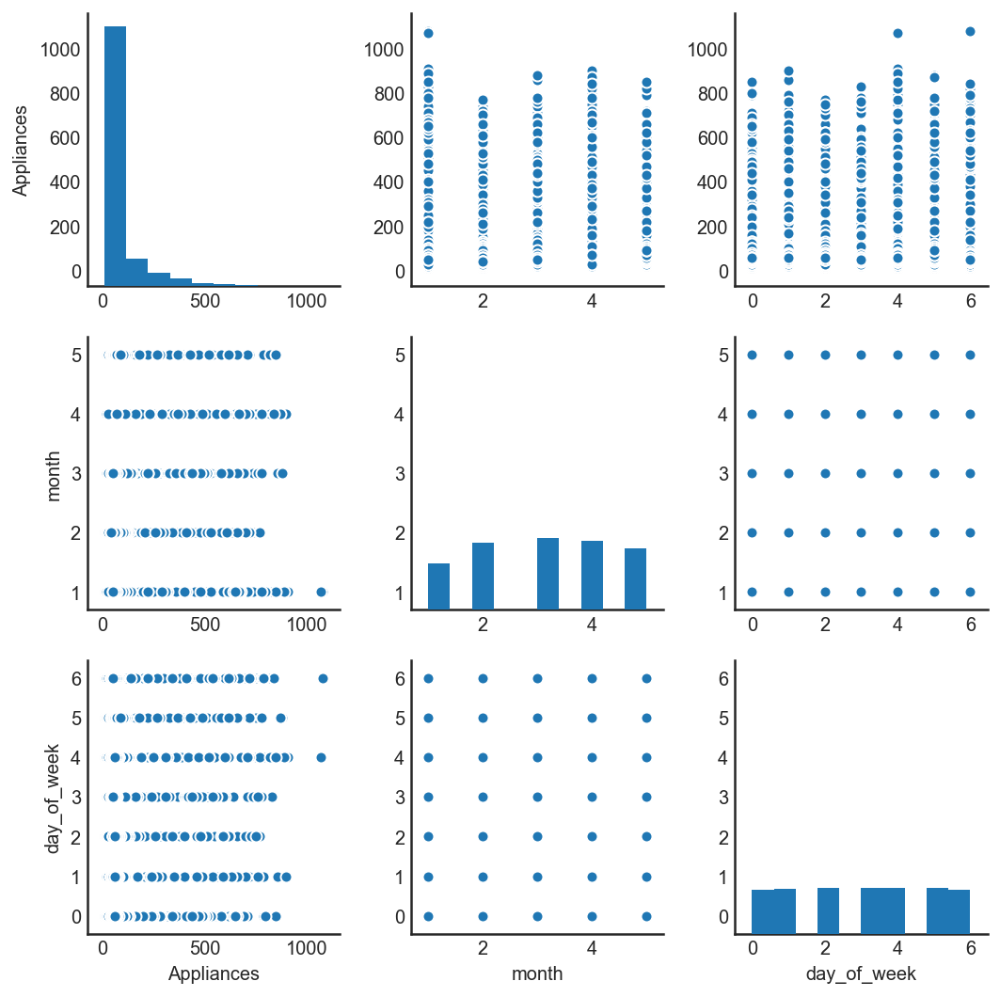

In [107]:
vcc1 = sns.pairplot(phase, vars=["Appliances","month", "day_of_week"])

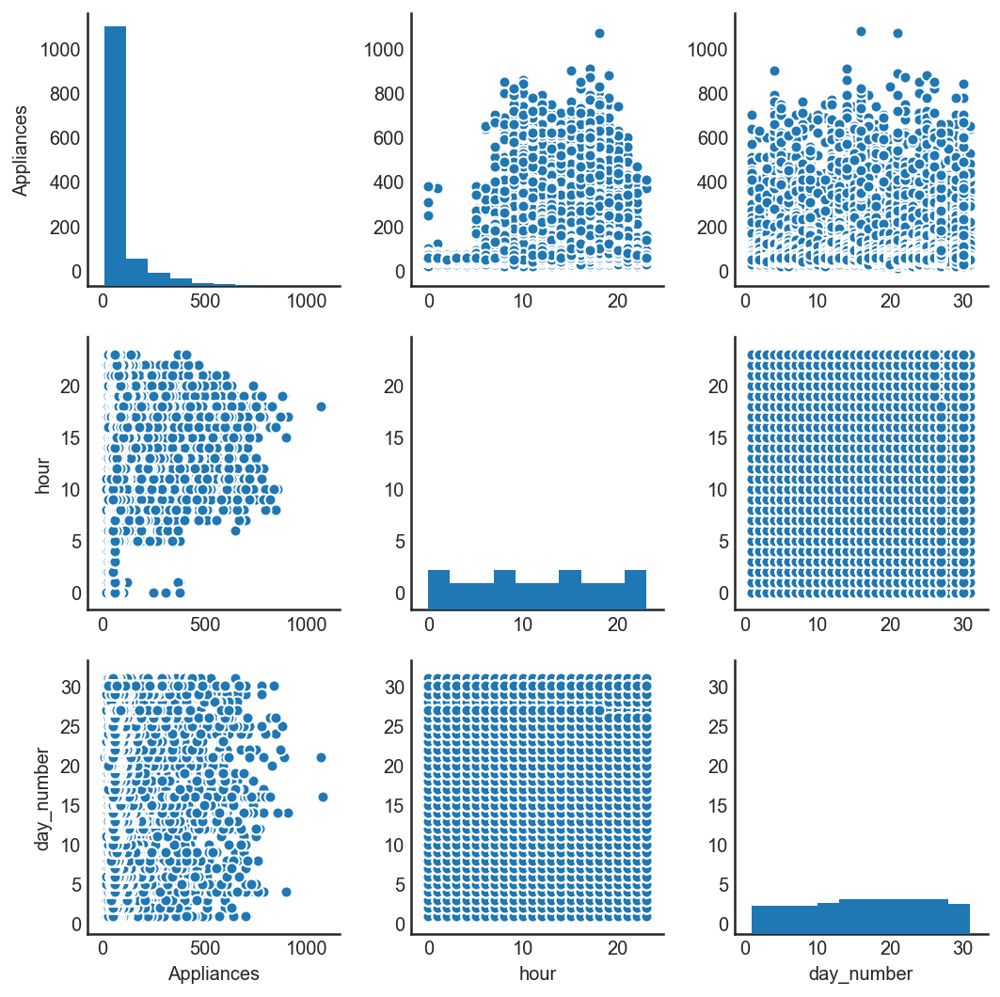

In [108]:
vcc2 = sns.pairplot(phase, vars=["Appliances","hour", "day_number"])

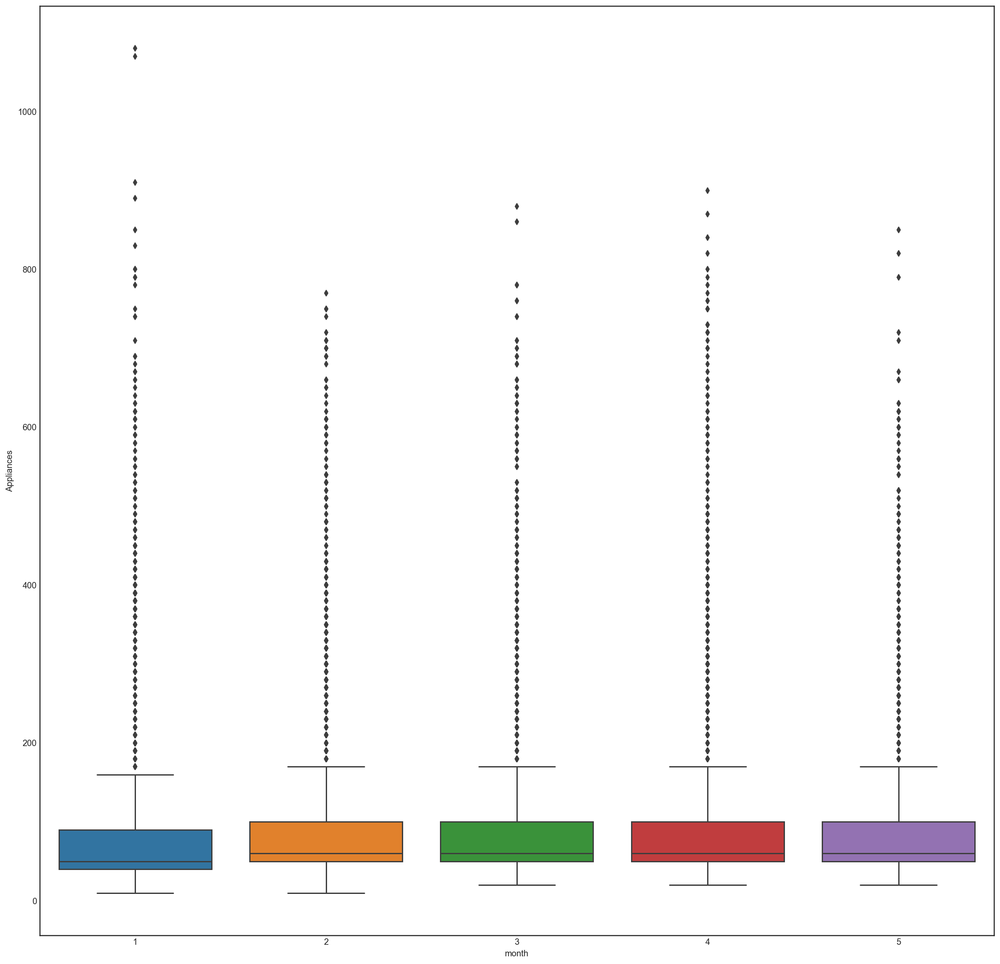

In [109]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
vax = sns.boxplot(x="month", y="Appliances", data=phase)

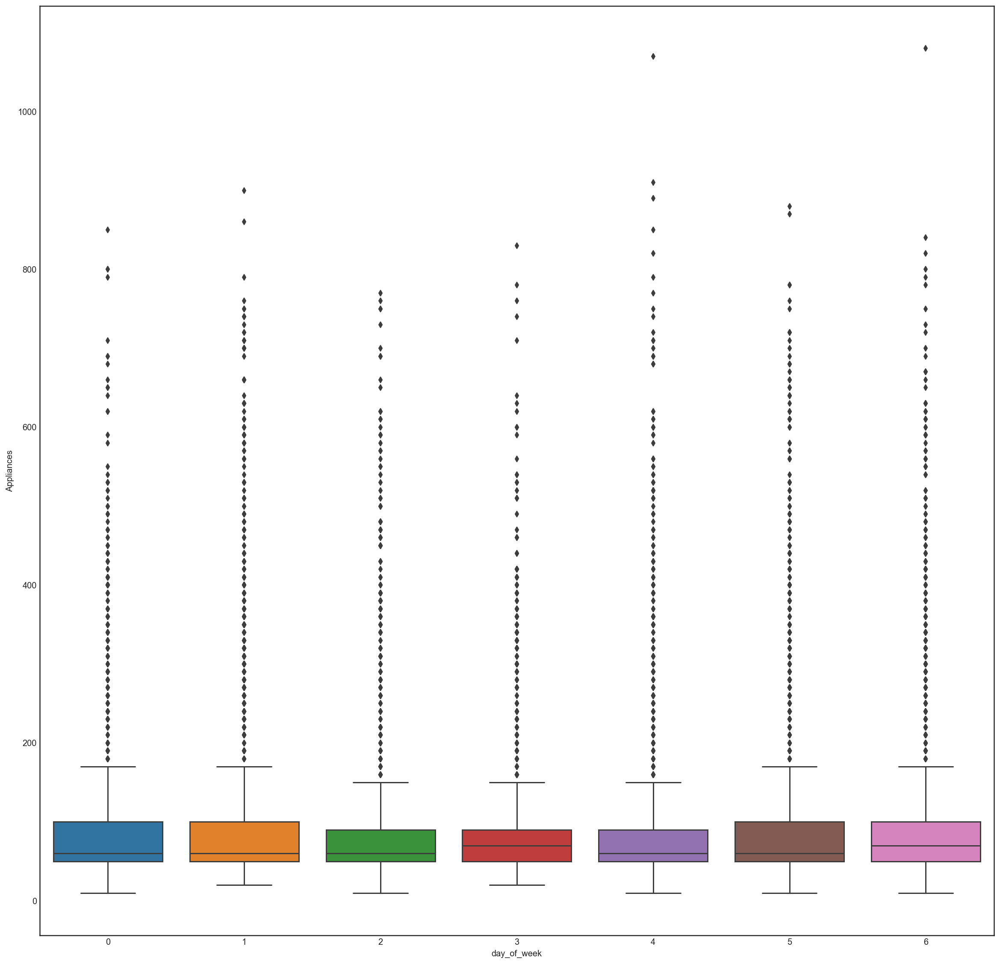

In [110]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
vax1 = sns.boxplot(x="day_of_week", y="Appliances", data=phase)

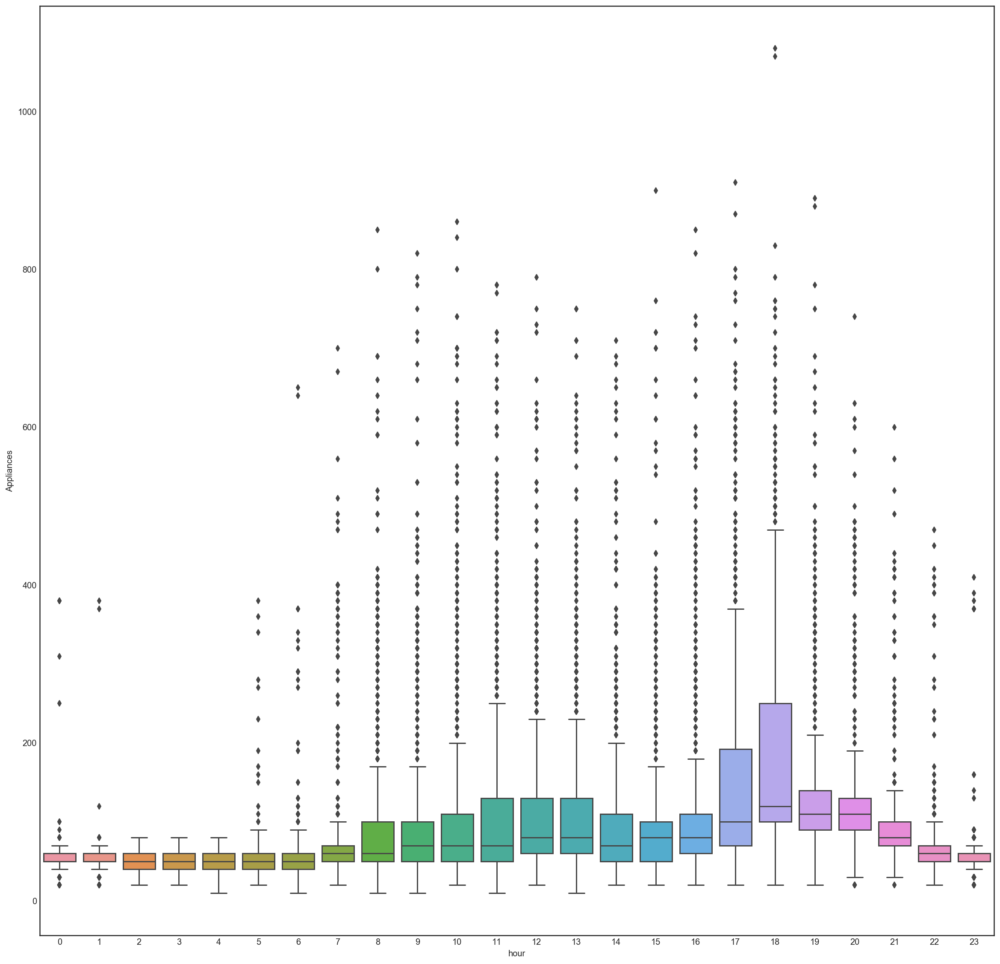

In [111]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
vax2 = sns.boxplot(x="hour", y="Appliances", data=phase)

# Correlation with heatmap after transformation of values for better understanding

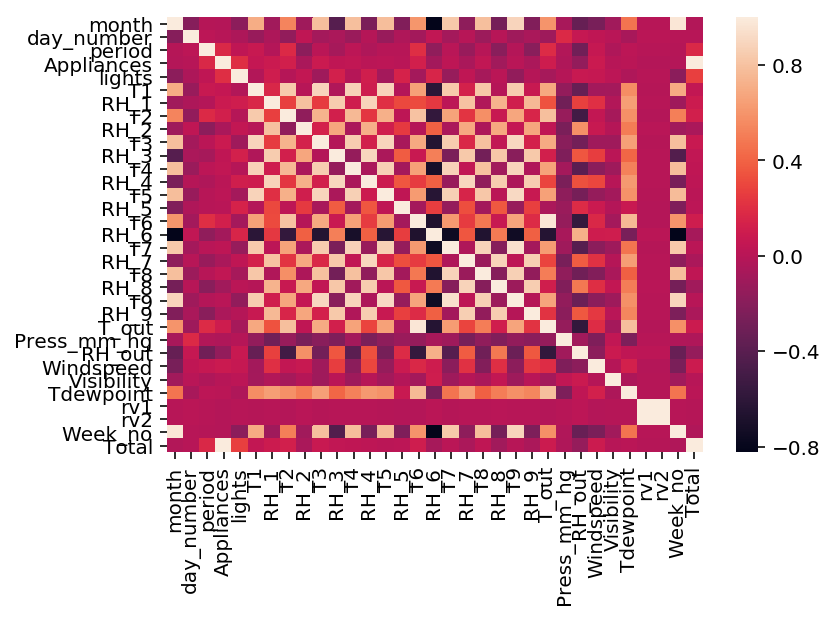

In [73]:
corr = phase.corr()
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns)
cmap=sns.diverging_palette(5, 250, as_cmap=True)

def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Hover to magify")\
    .set_precision(2)\
    .set_table_styles(magnify())

In [113]:
phase.describe()

,month,day_of_week,hour,day_number,Appliances,lights,T1,RH_1,T2,RH_2,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Week_no,Total
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,3.101647,3.006790,11.502002,16.057411,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,...,7.411665,6.627362,79.750418,4.039752,3.592755,3.760707,24.988033,24.988033,11.393615,4.342344
std,1.339200,1.981713,6.921953,8.450998,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,...,5.317409,0.009815,14.901088,2.451221,0.354316,4.194648,14.496634,14.496634,5.657985,0.663367
min,1.000000,0.000000,0.000000,1.000000,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,...,-5.000000,6.592085,24.000000,0.000000,0.000000,-6.600000,0.005322,0.005322,2.000000,2.302585
25%,2.000000,1.000000,6.000000,9.000000,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,...,3.666667,6.621317,70.333333,2.000000,3.367296,0.900000,12.497889,12.497889,6.000000,3.912023
50%,3.000000,3.000000,12.000000,16.000000,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,...,6.916667,6.628174,83.666667,3.666667,3.688879,3.433333,24.897653,24.897653,11.000000,4.094345
75%,4.000000,5.000000,17.000000,23.000000,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,...,10.408333,6.634546,91.666667,5.500000,3.688879,6.566667,37.583769,37.583769,16.000000,4.605170
max,5.000000,6.000000,23.000000,31.000000,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,...,26.100000,6.649373,100.000000,14.000000,4.189655,15.500000,49.996530,49.996530,21.000000,7.012115


# Outlier Removal

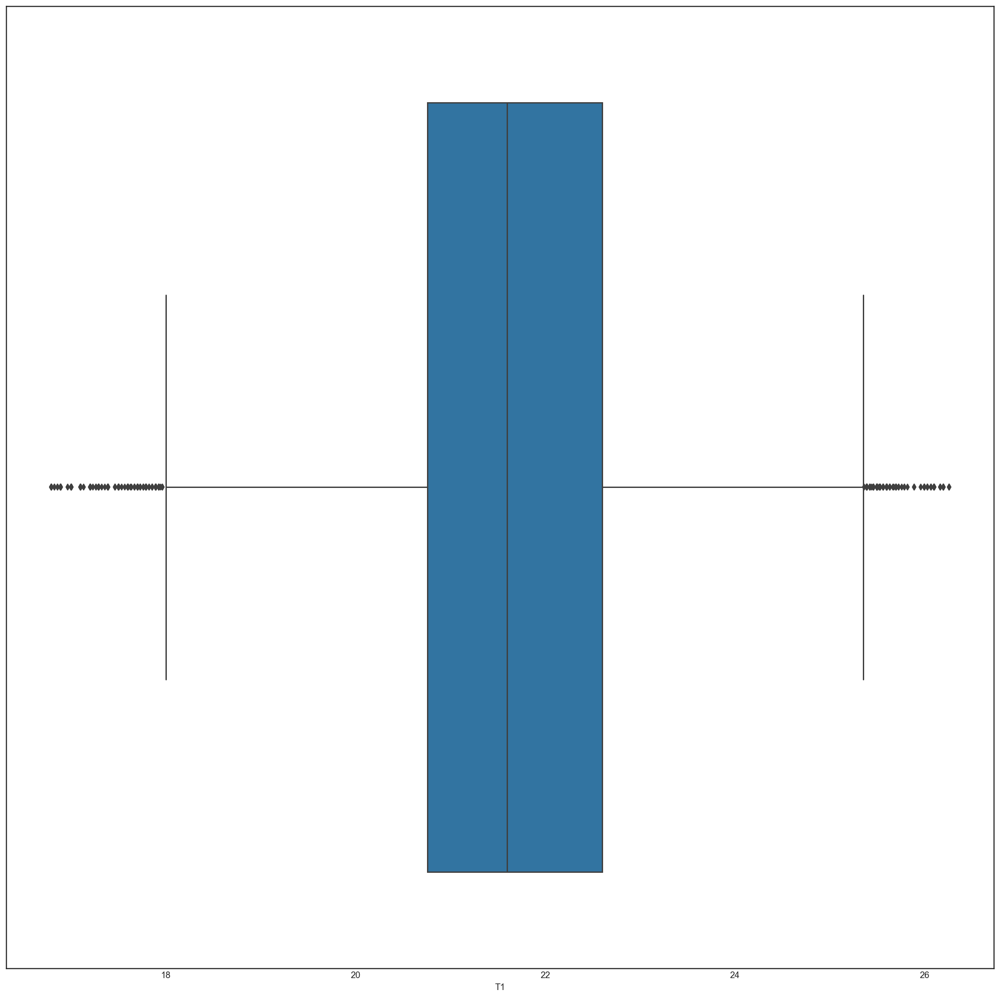

In [114]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax3 = sns.boxplot(x="T1", data=phase)

In [116]:
q75, q25 = np.percentile(phase.T1.dropna(), [75 ,25])
iqr = q75 - q25
min = q25 - (iqr*1.5)
max = q75 + (iqr*1.5)

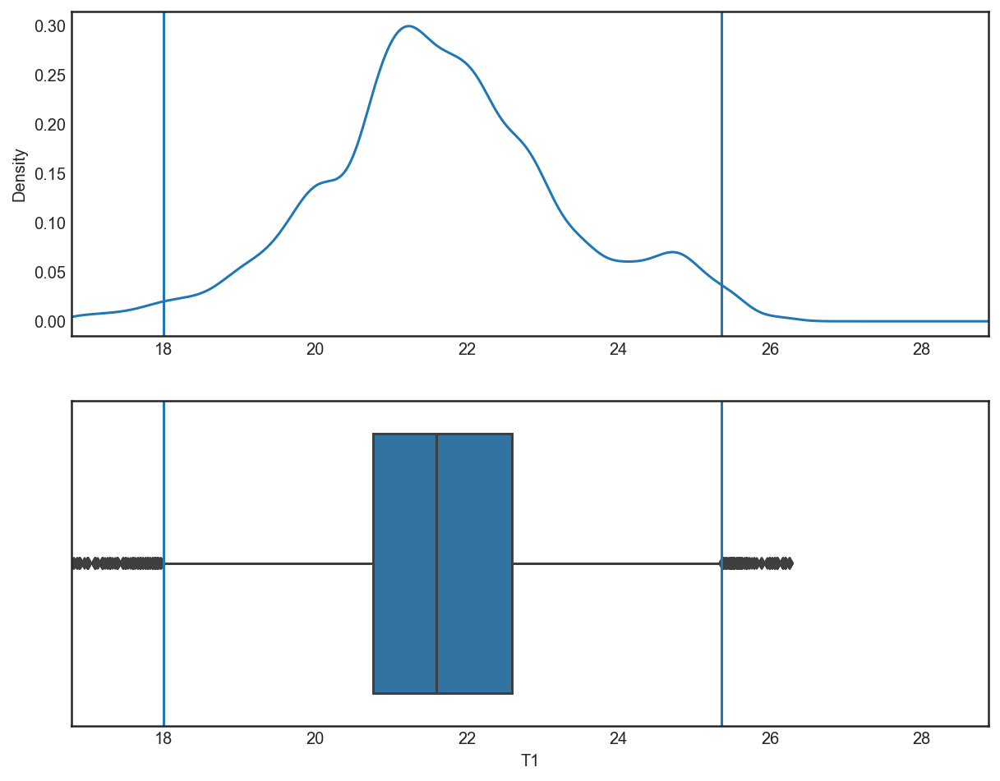

In [131]:
i = 'T1'
 
plt.figure(figsize=(10,8))
plt.subplot(211)
plt.xlim(phase1[i].min(), phase1[i].max()*1.1)
plt.axvline(x=min)
plt.axvline(x=max)
 
ax = phase1[i].plot(kind='kde')
 
plt.subplot(212)
plt.xlim(phase1[i].min(), phase1[i].max()*1.1)
sns.boxplot(x=phase1[i])
plt.axvline(x=min)
plt.axvline(x=max)

In [118]:
phase['Outlier'] = 0

phase1.loc[phase1[i] < min, 'Outlier'] = 1
phase1.loc[phase1[i] > max, 'Outlier'] = 1

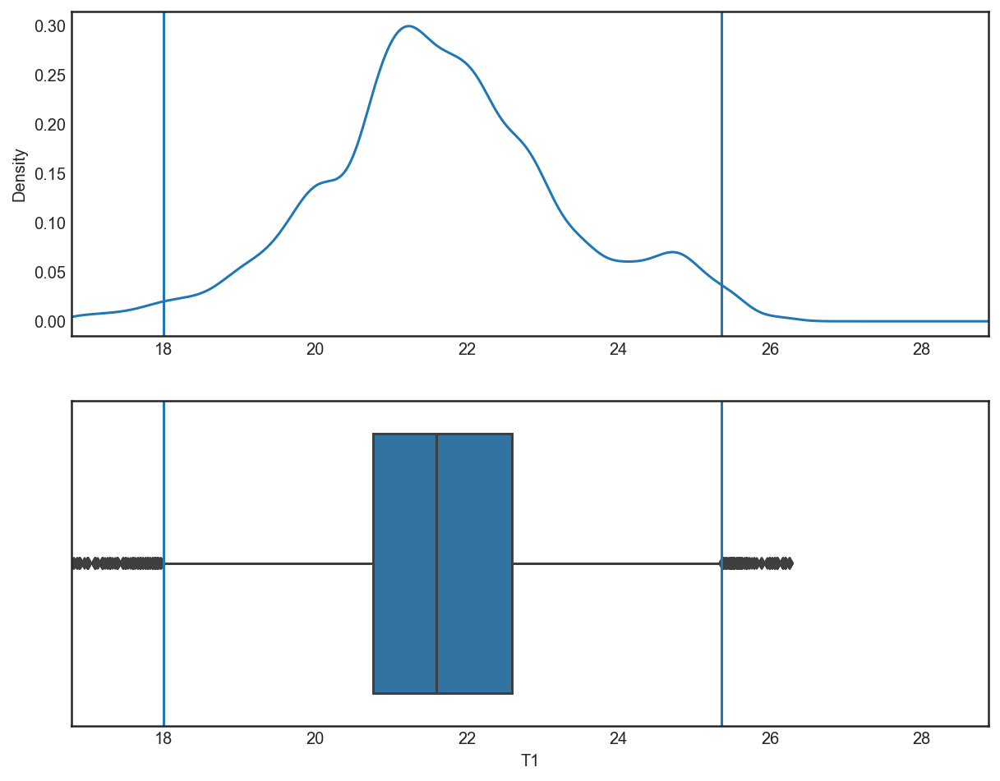

In [119]:
i = 'T1'
 
plt.figure(figsize=(10,8))
plt.subplot(211)
plt.xlim(phase[i].min(), phase[i].max()*1.1)
plt.axvline(x=min)
plt.axvline(x=max)
 
ax = df[i].plot(kind='kde')
 
plt.subplot(212)
plt.xlim(phase[i].min(), phase[i].max()*1.1)
sns.boxplot(x=phase[i])
plt.axvline(x=min)
plt.axvline(x=max)

In [124]:
phase['T1'].describe()

count    19735.000000
mean        21.686571
std          1.606066
min         16.790000
25%         20.760000
50%         21.600000
75%         22.600000
max         26.260000
Name: T1, dtype: float64

In [132]:
def remove_outlier(df_in, col_name):
    q1 = df_in[col_name].quantile(0.25)
    q3 = df_in[col_name].quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    df_out = df_in.loc[(df_in[col_name] > fence_low) & (df_in[col_name] < fence_high)]
    return df_out

In [135]:
remove_outlier(phase1,'T1')

,month,day_of_week,hour,day_number,Appliances,T1,RH_1,T2,RH_2,T3,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,Week_no,Outlier
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,1,1,17,11,60,19.890000,47.596667,19.200000,44.790000,19.790000,...,17.033333,45.530000,6.600000,6.597828,92.000000,7.000000,4.143135,5.300000,2,0
2016-01-11 17:10:00,1,1,17,11,60,19.890000,46.693333,19.200000,44.722500,19.790000,...,17.066667,45.560000,6.483333,6.597964,92.000000,6.666667,4.080358,5.200000,2,0
2016-01-11 17:20:00,1,1,17,11,50,19.890000,46.300000,19.200000,44.626667,19.790000,...,17.000000,45.500000,6.366667,6.598100,92.000000,6.333333,4.013375,5.100000,2,0
2016-01-11 17:30:00,1,1,17,11,50,19.890000,46.066667,19.200000,44.590000,19.790000,...,17.000000,45.400000,6.250000,6.598237,92.000000,6.000000,3.941582,5.000000,2,0
2016-01-11 17:40:00,1,1,17,11,60,19.890000,46.333333,19.200000,44.530000,19.790000,...,17.000000,45.400000,6.133333,6.598373,92.000000,5.666667,3.864232,4.900000,2,0
2016-01-11 17:50:00,1,1,17,11,50,19.890000,46.026667,19.200000,44.500000,19.790000,...,17.000000,45.290000,6.016667,6.598509,92.000000,5.333333,3.780395,4.800000,2,0
2016-01-11 18:00:00,1,1,18,11,60,19.890000,45.766667,19.200000,44.500000,19.790000,...,17.000000,45.290000,5.900000,6.598645,92.000000,5.000000,3.688879,4.700000,2,0
2016-01-11 18:10:00,1,1,18,11,60,19.856667,45.560000,19.200000,44.500000,19.730000,...,17.000000,45.290000,5.916667,6.598736,91.833333,5.166667,3.688879,4.683333,2,0
2016-01-11 18:20:00,1,1,18,11,60,19.790000,45.597500,19.200000,44.433333,19.730000,...,17.000000,45.290000,5.933333,6.598827,91.666667,5.333333,3.688879,4.666667,2,0


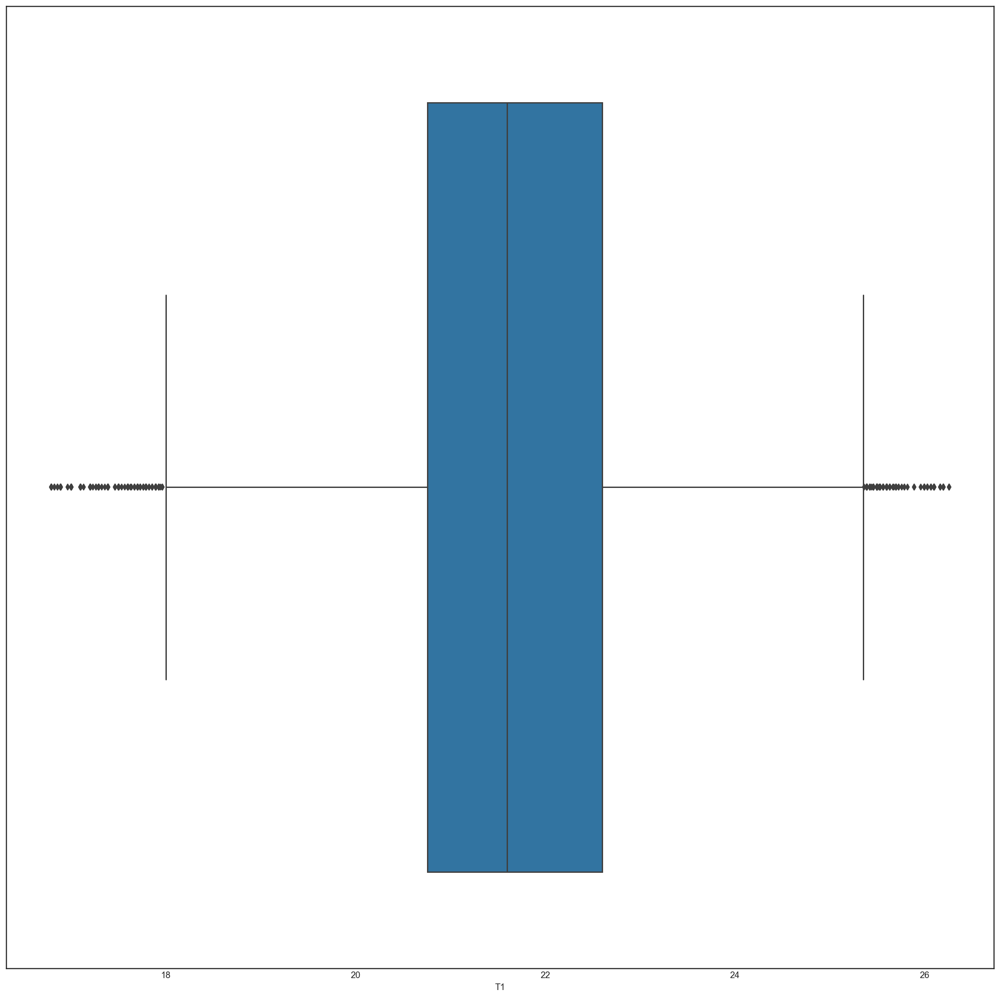

In [136]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax3 = sns.boxplot(x="T1", data=phase1)

In [95]:
phase1.isnull().sum()

NameError: name 'phase1' is not defined

In [ ]:
phase.loc('2016:01')

# --------------------------------------------

In [245]:
# Recursive feature elimination
def RFElimination1(X_train1,train1_y,X_test1,test1_y, return_score_p1,name):
    print("in "+str(name))
    org = lm
    selector = RFE(org, 18, step=1)
    selector = selector.fit(X_train1, train1_y)
    #     print(selector.ranking_)
    rankingdf = pd.DataFrame(list(zip(X_train1.columns, selector.ranking_)), columns=["features", "ranking"])
    file="Features"+ str(name)
    rankingdf.to_csv(file+".csv")
    # print(rankingdf)
    result = sm.OLS(train1_y, X_train1).fit()
    # print(result.summary())
    pred = selector.predict(X_train1)
    sc = r2_score(train1_y, pred)
    # print("RFElimination:" + str(sc))
    # print(sc)
    return_score_p1[name] = sc
    print("Training Dataset")
    computations(selector,X_train1,train1_y)
    print("Testing Dataset")
    computations(selector,X_test1,test1_y)

# Feature Engineering
## Steps in feature Engineering are-
### 1.Variable Transformation
### 2.Variable/Feature creation

In [96]:
phase1 = phase

In [97]:
phase1.drop(['datetime','Time','lights','Total','rv1','rv2'],axis=1,inplace=True)

In [98]:
phase1.dtypes

month            int64
day_of_week      int64
hour             int64
day_number       int64
Appliances       int64
T1             float64
RH_1           float64
T2             float64
RH_2           float64
T3             float64
RH_3           float64
T4             float64
RH_4           float64
T5             float64
RH_5           float64
T6             float64
RH_6           float64
T7             float64
RH_7           float64
T8             float64
RH_8           float64
T9             float64
RH_9           float64
T_out          float64
Press_mm_hg    float64
RH_out         float64
Windspeed      float64
Visibility     float64
Tdewpoint      float64
Week_no          int64
dtype: object

In [99]:
phase1

,month,day_of_week,hour,day_number,Appliances,T1,RH_1,T2,RH_2,T3,...,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,Week_no
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,1,1,17,11,60,19.890000,47.596667,19.200000,44.790000,19.790000,...,48.900000,17.033333,45.530000,6.600000,733.500000,92.000000,7.000000,63.000000,5.300000,2
2016-01-11 17:10:00,1,1,17,11,60,19.890000,46.693333,19.200000,44.722500,19.790000,...,48.863333,17.066667,45.560000,6.483333,733.600000,92.000000,6.666667,59.166667,5.200000,2
2016-01-11 17:20:00,1,1,17,11,50,19.890000,46.300000,19.200000,44.626667,19.790000,...,48.730000,17.000000,45.500000,6.366667,733.700000,92.000000,6.333333,55.333333,5.100000,2
2016-01-11 17:30:00,1,1,17,11,50,19.890000,46.066667,19.200000,44.590000,19.790000,...,48.590000,17.000000,45.400000,6.250000,733.800000,92.000000,6.000000,51.500000,5.000000,2
2016-01-11 17:40:00,1,1,17,11,60,19.890000,46.333333,19.200000,44.530000,19.790000,...,48.590000,17.000000,45.400000,6.133333,733.900000,92.000000,5.666667,47.666667,4.900000,2
2016-01-11 17:50:00,1,1,17,11,50,19.890000,46.026667,19.200000,44.500000,19.790000,...,48.590000,17.000000,45.290000,6.016667,734.000000,92.000000,5.333333,43.833333,4.800000,2
2016-01-11 18:00:00,1,1,18,11,60,19.890000,45.766667,19.200000,44.500000,19.790000,...,48.590000,17.000000,45.290000,5.900000,734.100000,92.000000,5.000000,40.000000,4.700000,2
2016-01-11 18:10:00,1,1,18,11,60,19.856667,45.560000,19.200000,44.500000,19.730000,...,48.590000,17.000000,45.290000,5.916667,734.166667,91.833333,5.166667,40.000000,4.683333,2
2016-01-11 18:20:00,1,1,18,11,60,19.790000,45.597500,19.200000,44.433333,19.730000,...,48.590000,17.000000,45.290000,5.933333,734.233333,91.666667,5.333333,40.000000,4.666667,2


In [120]:
from sklearn.preprocessing import PolynomialFeatures
poly = PolynomialFeatures(degree=3, include_bias=False)
X2 = poly.fit_transform(phase1)
print(X2)

[[  1.00000000e+00   1.00000000e+00   1.70000000e+01 ...,   5.61800000e+01
    2.12000000e+01   8.00000000e+00]
 [  1.00000000e+00   1.00000000e+00   1.70000000e+01 ...,   5.40800000e+01
    2.08000000e+01   8.00000000e+00]
 [  1.00000000e+00   1.00000000e+00   1.70000000e+01 ...,   5.20200000e+01
    2.04000000e+01   8.00000000e+00]
 ..., 
 [  5.00000000e+00   5.00000000e+00   1.70000000e+01 ...,   3.69609333e+03
    5.85060000e+03   9.26100000e+03]
 [  5.00000000e+00   5.00000000e+00   1.70000000e+01 ...,   3.67754333e+03
    5.83590000e+03   9.26100000e+03]
 [  5.00000000e+00   5.00000000e+00   1.80000000e+01 ...,   3.65904000e+03
    5.82120000e+03   9.26100000e+03]]


# Logistic Regression for Feature Selection

In [55]:
# define random forest classifier, with utilising all cores and
# sampling in proportion to y labels
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

X = phase.drop(['Appliances'],axis=1)
y = phase['Appliances']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.40, random_state=42) 

In [185]:
y_train_s = np.arange(14801).reshape(14801,1) 
y_train_s.shape

(14801, 1)

In [186]:
X_train_s = X_train.values
y_train_s = y_train.values

In [187]:
y_train_s = y_train_s.ravel()

In [188]:
y_train_s = np.arange(14801).reshape(14801,1) 

In [189]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
model = LogisticRegression()
    # create the RFE model and select 3 attributes
rfe = RFE(model, 3)
rfe = rfe.fit(X_train, y_train)
    # summarize the selection of the attributes
print(rfe.support_)
print(rfe.ranking_)
print(rfe.n_features_)
    #Check the accuracy of the model
rfe.score(X_train, y_train)

[False False False False False False False False  True False False False
  True False False False False False False False False False False  True
 False False False False False]
[ 3 13 26 23  2 10  8 11  1 12  5 20  1 25 15 27  7 17  6 18  4 22 16  1 24
 19  9 21 14]
3


0.22743011569968752

In [131]:
X.dtypes

month            int64
day_of_week      int64
hour             int64
day_number       int64
T1             float64
RH_1           float64
T2             float64
RH_2           float64
T3             float64
RH_3           float64
T4             float64
RH_4           float64
T5             float64
RH_5           float64
T6             float64
RH_6           float64
T7             float64
RH_7           float64
T8             float64
RH_8           float64
T9             float64
RH_9           float64
T_out          float64
Press_mm_hg    float64
RH_out         float64
Windspeed      float64
Visibility     float64
Tdewpoint      float64
Week_no          int64
dtype: object

In [241]:
feature_columns = ['hour','day_of_week','month']

In [242]:
from sklearn.preprocessing import scale
X_train_scale=scale(X_train[feature_columns])
X_test_scale=scale(X_test[feature_columns])

In [243]:
from sklearn.linear_model import LogisticRegression
log=LogisticRegression(penalty='l2',C=1)
log.fit(X_train_scale,y_train)

LogisticRegression(C=1, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)

In [244]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test,log.predict(X_test_scale))

0.21281986318723081

In [138]:
phase1

,month,day_of_week,hour,day_number,Appliances,T1,RH_1,T2,RH_2,T3,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,Week_no,Outlier
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,1,1,17,11,60,19.890000,47.596667,19.200000,44.790000,19.790000,...,17.033333,45.530000,6.600000,6.597828,92.000000,7.000000,4.143135,5.300000,2,0
2016-01-11 17:10:00,1,1,17,11,60,19.890000,46.693333,19.200000,44.722500,19.790000,...,17.066667,45.560000,6.483333,6.597964,92.000000,6.666667,4.080358,5.200000,2,0
2016-01-11 17:20:00,1,1,17,11,50,19.890000,46.300000,19.200000,44.626667,19.790000,...,17.000000,45.500000,6.366667,6.598100,92.000000,6.333333,4.013375,5.100000,2,0
2016-01-11 17:30:00,1,1,17,11,50,19.890000,46.066667,19.200000,44.590000,19.790000,...,17.000000,45.400000,6.250000,6.598237,92.000000,6.000000,3.941582,5.000000,2,0
2016-01-11 17:40:00,1,1,17,11,60,19.890000,46.333333,19.200000,44.530000,19.790000,...,17.000000,45.400000,6.133333,6.598373,92.000000,5.666667,3.864232,4.900000,2,0
2016-01-11 17:50:00,1,1,17,11,50,19.890000,46.026667,19.200000,44.500000,19.790000,...,17.000000,45.290000,6.016667,6.598509,92.000000,5.333333,3.780395,4.800000,2,0
2016-01-11 18:00:00,1,1,18,11,60,19.890000,45.766667,19.200000,44.500000,19.790000,...,17.000000,45.290000,5.900000,6.598645,92.000000,5.000000,3.688879,4.700000,2,0
2016-01-11 18:10:00,1,1,18,11,60,19.856667,45.560000,19.200000,44.500000,19.730000,...,17.000000,45.290000,5.916667,6.598736,91.833333,5.166667,3.688879,4.683333,2,0
2016-01-11 18:20:00,1,1,18,11,60,19.790000,45.597500,19.200000,44.433333,19.730000,...,17.000000,45.290000,5.933333,6.598827,91.666667,5.333333,3.688879,4.666667,2,0


In [145]:
phase1.loc['2016-01-11']

KeyError: 'the label [2016-01-11] is not in the [index]'

In [216]:
phase.shape

(19735, 30)

In [217]:
phase

,month,day_of_week,hour,day_number,Appliances,T1,RH_1,T2,RH_2,T3,...,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,Week_no
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,1,1,17,11,60,19.890000,47.596667,19.200000,44.790000,19.790000,...,48.900000,17.033333,45.530000,6.600000,6.597828,92.000000,7.000000,4.143135,5.300000,2
2016-01-11 17:10:00,1,1,17,11,60,19.890000,46.693333,19.200000,44.722500,19.790000,...,48.863333,17.066667,45.560000,6.483333,6.597964,92.000000,6.666667,4.080358,5.200000,2
2016-01-11 17:20:00,1,1,17,11,50,19.890000,46.300000,19.200000,44.626667,19.790000,...,48.730000,17.000000,45.500000,6.366667,6.598100,92.000000,6.333333,4.013375,5.100000,2
2016-01-11 17:30:00,1,1,17,11,50,19.890000,46.066667,19.200000,44.590000,19.790000,...,48.590000,17.000000,45.400000,6.250000,6.598237,92.000000,6.000000,3.941582,5.000000,2
2016-01-11 17:40:00,1,1,17,11,60,19.890000,46.333333,19.200000,44.530000,19.790000,...,48.590000,17.000000,45.400000,6.133333,6.598373,92.000000,5.666667,3.864232,4.900000,2
2016-01-11 17:50:00,1,1,17,11,50,19.890000,46.026667,19.200000,44.500000,19.790000,...,48.590000,17.000000,45.290000,6.016667,6.598509,92.000000,5.333333,3.780395,4.800000,2
2016-01-11 18:00:00,1,1,18,11,60,19.890000,45.766667,19.200000,44.500000,19.790000,...,48.590000,17.000000,45.290000,5.900000,6.598645,92.000000,5.000000,3.688879,4.700000,2
2016-01-11 18:10:00,1,1,18,11,60,19.856667,45.560000,19.200000,44.500000,19.730000,...,48.590000,17.000000,45.290000,5.916667,6.598736,91.833333,5.166667,3.688879,4.683333,2
2016-01-11 18:20:00,1,1,18,11,60,19.790000,45.597500,19.200000,44.433333,19.730000,...,48.590000,17.000000,45.290000,5.933333,6.598827,91.666667,5.333333,3.688879,4.666667,2


In [215]:
phase1.('10Min').ffill()

AttributeError: 'DataFrame' object has no attribute 'date'

# Feature Relation using coefficient

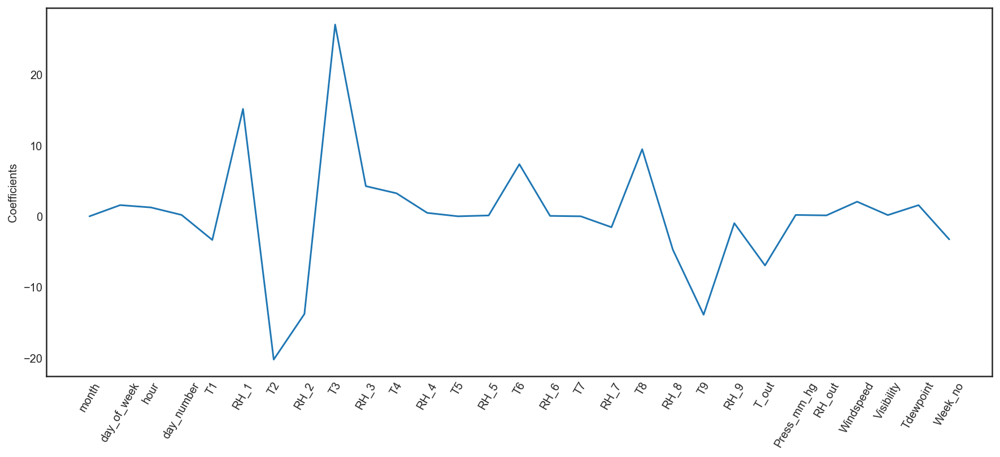

In [102]:
from sklearn.linear_model import Lasso
names = phase1.drop('Appliances',axis=1).columns
lasso =Lasso(alpha=0.1)
lasso_coef = lasso.fit(X,y).coef_
_=plt.plot(range(len(names)),lasso_coef)
_=plt.xticks(range(len(names)),names, rotation=60)
_=plt.ylabel('Coefficients')
plt.show()

# Bee Swarm Plots

KeyboardInterrupt: 

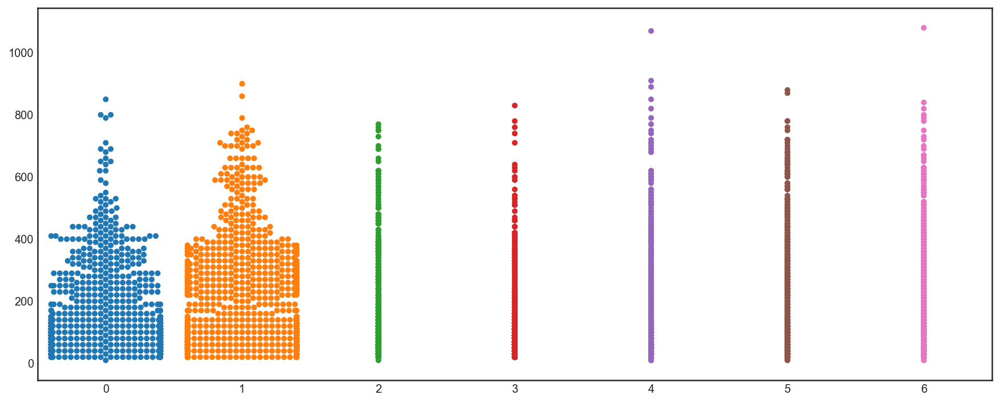

In [103]:
_= sns.swarmplot(x='day_of_week',y='Appliances',data=phase1)
_= plt.xlabel('day_of_week')
_=plt.ylabel('Appliances')
plt.show()

# ECDF Plots

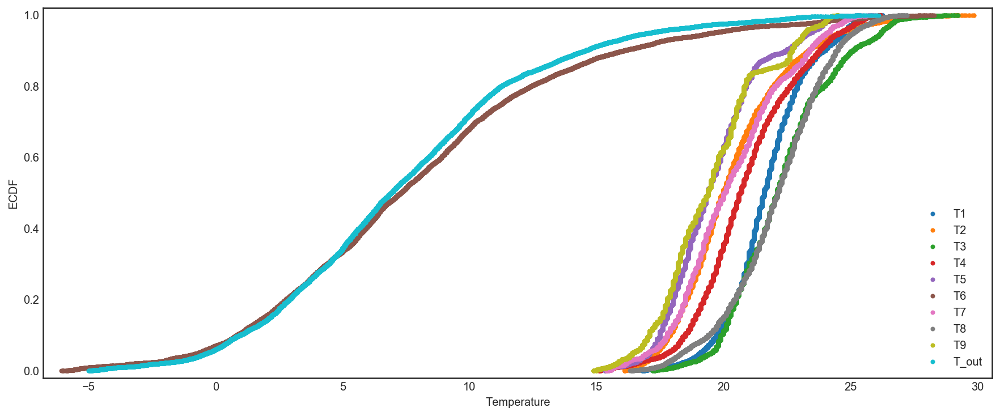

In [110]:
import numpy as np

x_t1 = np.sort(phase1['T1'])
y_t1 = np.arange(1, len(x_t1)+1)/len(x_t1)

x_t2 = np.sort(phase1['T2'])
y_t2 = np.arange(1, len(x_t2)+1)/len(x_t2)

x_t3 = np.sort(phase1['T3'])
y_t3 = np.arange(1, len(x_t3)+1)/len(x_t3)

x_t4 = np.sort(phase1['T4'])
y_t4 = np.arange(1, len(x_t4)+1)/len(x_t4)

x_t5 = np.sort(phase1['T5'])
y_t5 = np.arange(1, len(x_t5)+1)/len(x_t5)

x_t6 = np.sort(phase1['T6'])
y_t6 = np.arange(1, len(x_t6)+1)/len(x_t6)

x_t7 = np.sort(phase1['T7'])
y_t7 = np.arange(1, len(x_t7)+1)/len(x_t7)

x_t8 = np.sort(phase1['T8'])
y_t8 = np.arange(1, len(x_t8)+1)/len(x_t8)

x_t9 = np.sort(phase1['T9'])
y_t9 = np.arange(1, len(x_t9)+1)/len(x_t9)

x_tout = np.sort(phase1['T_out'])
y_tout = np.arange(1, len(x_tout)+1)/len(x_tout)


_=plt.plot(x_t1,y_t1,marker='.',linestyle='none')
_=plt.plot(x_t2,y_t2,marker='.',linestyle='none')
_=plt.plot(x_t3,y_t3,marker='.',linestyle='none')
_=plt.plot(x_t4,y_t4,marker='.',linestyle='none')
_=plt.plot(x_t5,y_t5,marker='.',linestyle='none')
_=plt.plot(x_t6,y_t6,marker='.',linestyle='none')
_=plt.plot(x_t7,y_t7,marker='.',linestyle='none')
_=plt.plot(x_t8,y_t8,marker='.',linestyle='none')
_=plt.plot(x_t9,y_t9,marker='.',linestyle='none')
_=plt.plot(x_tout,y_tout,marker='.',linestyle='none')


plt.margins(0.02)
plt.legend(('T1','T2','T3','T4','T5','T6','T7','T8','T9','T_out'), loc='lower right')
_= plt.xlabel('Temperature')
_=plt.ylabel('ECDF')

plt.show()


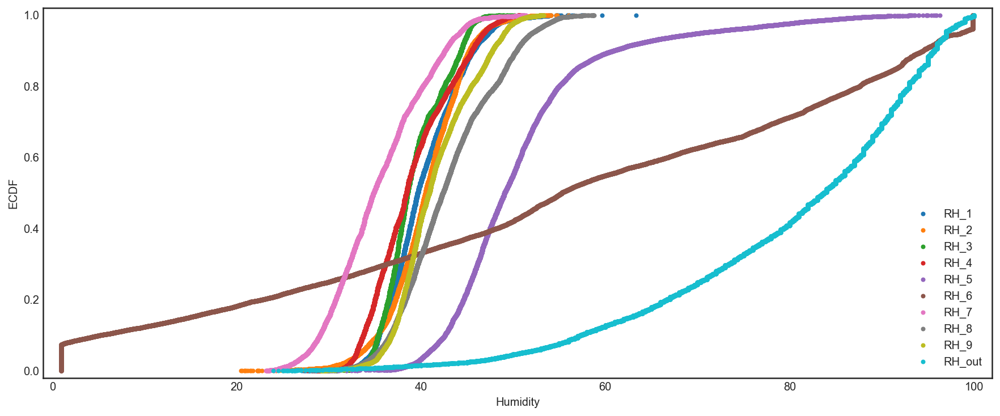

In [111]:
import numpy as np

x_rh1 = np.sort(phase1['RH_1'])
y_rh1 = np.arange(1, len(x_rh1)+1)/len(x_rh1)

x_rh2 = np.sort(phase1['RH_2'])
y_rh2 = np.arange(1, len(x_rh2)+1)/len(x_rh2)

x_rh3 = np.sort(phase1['RH_3'])
y_rh3 = np.arange(1, len(x_rh3)+1)/len(x_rh3)

x_rh4 = np.sort(phase1['RH_4'])
y_rh4 = np.arange(1, len(x_rh4)+1)/len(x_rh4)

x_rh5 = np.sort(phase1['RH_5'])
y_rh5 = np.arange(1, len(x_rh5)+1)/len(x_rh5)

x_rh6 = np.sort(phase1['RH_6'])
y_rh6 = np.arange(1, len(x_rh6)+1)/len(x_rh6)

x_rh7 = np.sort(phase1['RH_7'])
y_rh7 = np.arange(1, len(x_rh7)+1)/len(x_rh7)

x_rh8 = np.sort(phase1['RH_8'])
y_rh8 = np.arange(1, len(x_rh8)+1)/len(x_rh8)

x_rh9 = np.sort(phase1['RH_9'])
y_rh9 = np.arange(1, len(x_rh9)+1)/len(x_rh9)

x_rhout = np.sort(phase1['RH_out'])
y_rhout = np.arange(1, len(x_rhout)+1)/len(x_rhout)


_=plt.plot(x_rh1,y_rh1,marker='.',linestyle='none')
_=plt.plot(x_rh2,y_rh2,marker='.',linestyle='none')
_=plt.plot(x_rh3,y_rh3,marker='.',linestyle='none')
_=plt.plot(x_rh4,y_rh4,marker='.',linestyle='none')
_=plt.plot(x_rh5,y_rh5,marker='.',linestyle='none')
_=plt.plot(x_rh6,y_rh6,marker='.',linestyle='none')
_=plt.plot(x_rh7,y_rh7,marker='.',linestyle='none')
_=plt.plot(x_rh8,y_rh8,marker='.',linestyle='none')
_=plt.plot(x_rh9,y_rh9,marker='.',linestyle='none')
_=plt.plot(x_rhout,y_rhout,marker='.',linestyle='none')


plt.margins(0.02)
plt.legend(('RH_1','RH_2','RH_3','RH_4','RH_5','RH_6','RH_7','RH_8','RH_9','RH_out'), loc='lower right')
_= plt.xlabel('Humidity')
_=plt.ylabel('ECDF')

plt.show()



# Mean and Median

In [113]:
np.median(phase1['T1'])

21.600000000000001

# Computing Percentile

In [114]:
np.percentile(phase1['T1'],[25,50,75])

array([ 20.76,  21.6 ,  22.6 ])

In [115]:
np.var(phase['T1'])

2.579316151278515

In [116]:
np.std(phase['T1'])

1.606024953504308

# Covariane and Pearson correlation coefficient

In [117]:
np.cov(phase1['Appliances'],phase1['T1'])

array([[  1.05113532e+04,   9.13007522e+00],
       [  9.13007522e+00,   2.57944686e+00]])

In [118]:
np.corrcoef(phase1['Appliances'],phase1['T1'])

array([[ 1.        ,  0.05544747],
       [ 0.05544747,  1.        ]])

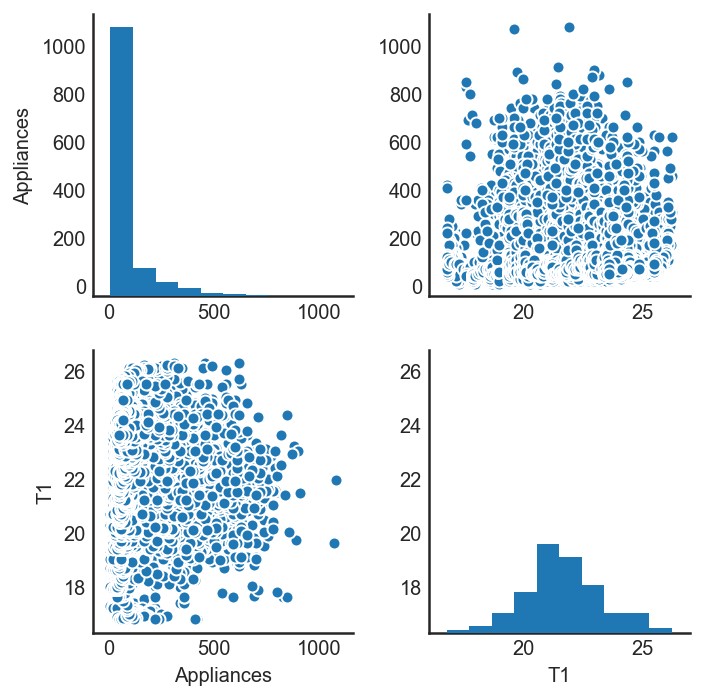

In [119]:
vcc2q1 = sns.pairplot(phase, vars=["Appliances","T1"])

In [121]:
# pearson correlation
def pearson_r(x,y):
    """Compute Pearson correlation coefficient between two arrays."""
    # Compute correlation matrix: corr_mat
    corr_mat = np.corrcoef(x,y)

    # Return entry [0,1]
    return corr_mat[0,1]

In [123]:
r = pearson_r(phase1['Appliances'],phase1['T1'])
print(r)

0.055447471852


In [124]:
# Probablistic 


# Random number generator

# Bernoulli Trial

In [125]:
np.random.seed()

# PMF
# CDF

# Poisson Distribution
# Probablity Density Function

In [76]:
def ecdf(data):
    n = len(data)
    x = np.sort(data)
    y = np.arange(1,n+1)/n
    return x,y
    

In [136]:
n = len(phase1['Appliances'])
print(n)

19735


In [216]:
mean = np.mean(phase1['Appliances'])
std = np.std(phase1['Appliances'])
samples = np.random.normal(mean,std,size = 100000)
x,y = ecdf(phase1['Appliances'])
x_theor,y_theor = ecdf(samples)


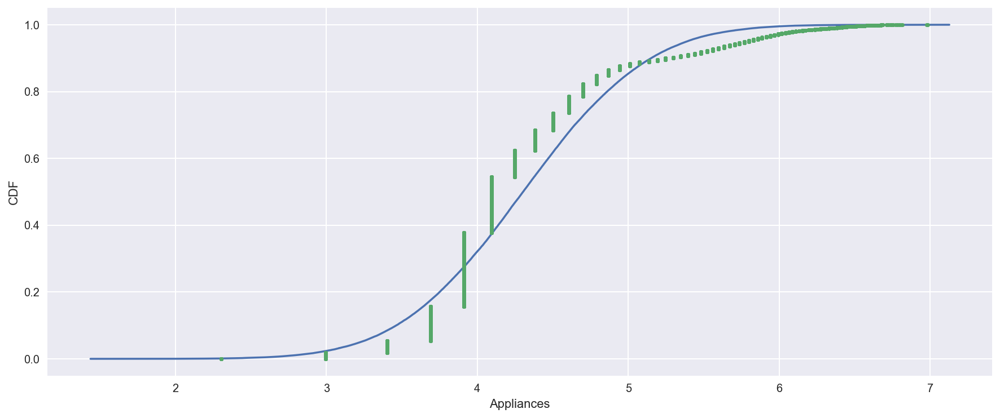

In [217]:
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('Appliances')
_=plt.ylabel('CDF')
plt.show()

In [222]:
mean = np.mean(phase1['T1'])
std = np.std(phase1['T1'])
samples = np.random.normal(mean,std,size = 100000)
x,y = ecdf(phase1['T1'])
x_theor,y_theor = ecdf(samples)

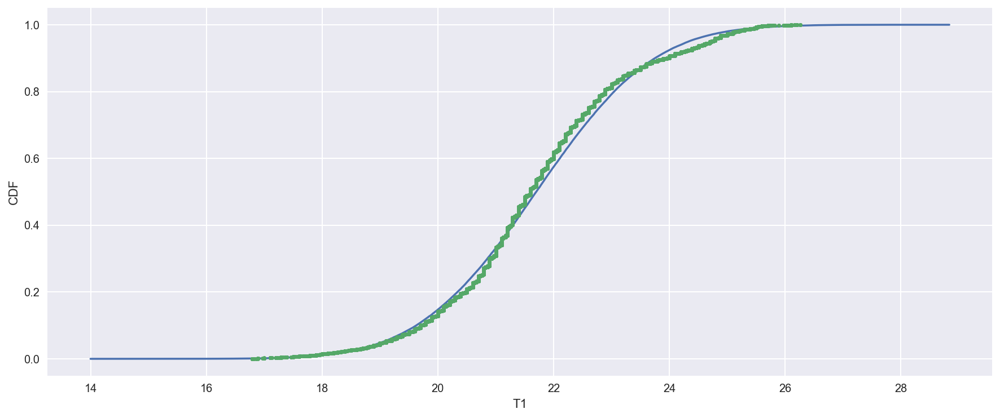

In [223]:
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T1')
_=plt.ylabel('CDF')
plt.show()

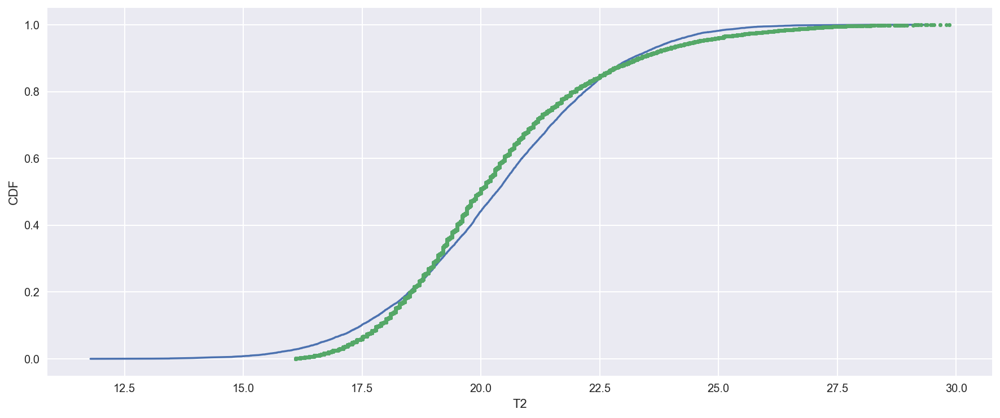

In [232]:
mean = np.mean(phase1['T2'])
std = np.std(phase1['T2'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['T2'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T2')
_=plt.ylabel('CDF')
plt.show()

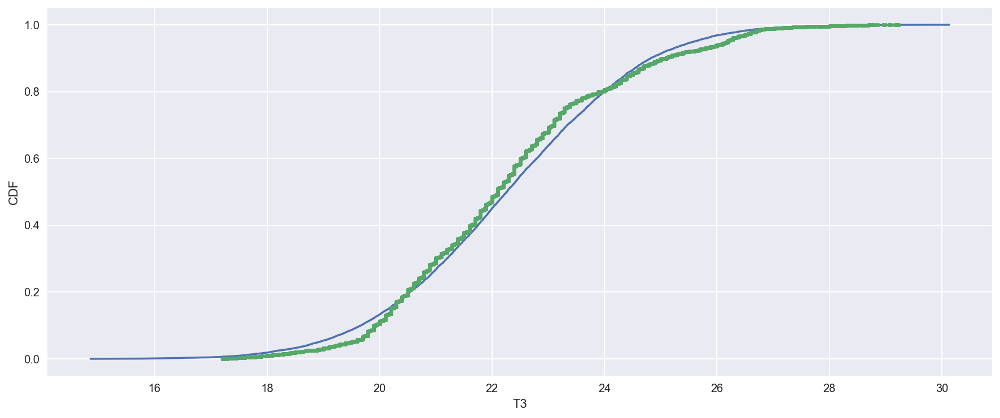

In [231]:
mean = np.mean(phase1['T3'])
std = np.std(phase1['T3'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['T3'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T3')
_=plt.ylabel('CDF')
plt.show()

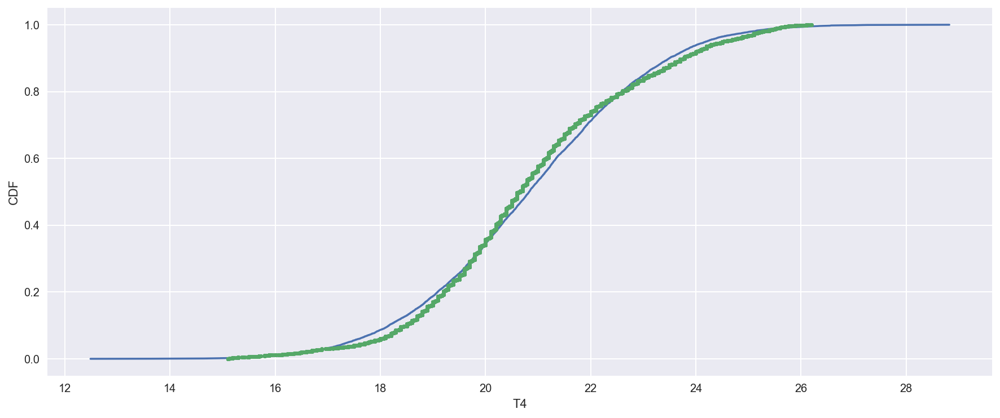

In [233]:
mean = np.mean(phase1['T4'])
std = np.std(phase1['T4'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['T4'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T4')
_=plt.ylabel('CDF')
plt.show()

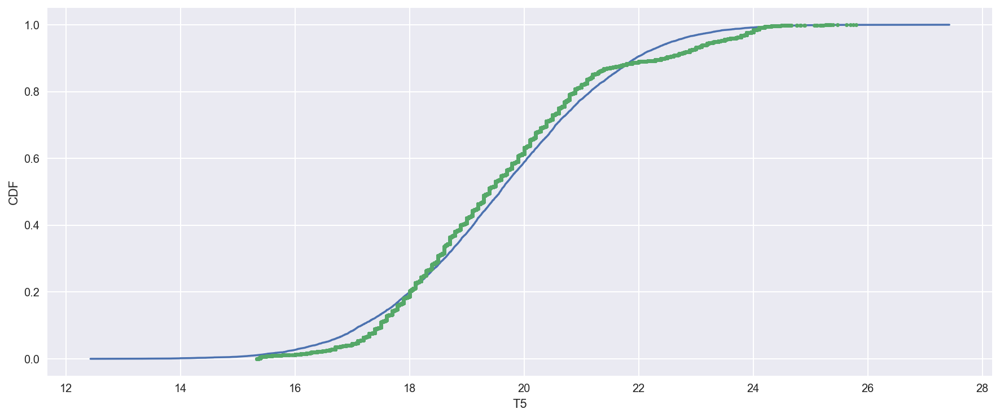

In [234]:
mean = np.mean(phase1['T5'])
std = np.std(phase1['T5'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['T5'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T5')
_=plt.ylabel('CDF')
plt.show()

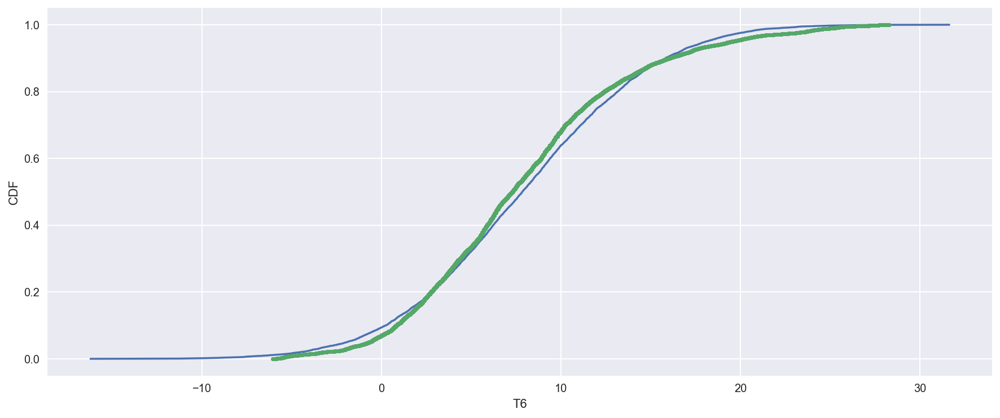

In [235]:
mean = np.mean(phase1['T6'])
std = np.std(phase1['T6'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['T6'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T6')
_=plt.ylabel('CDF')
plt.show()

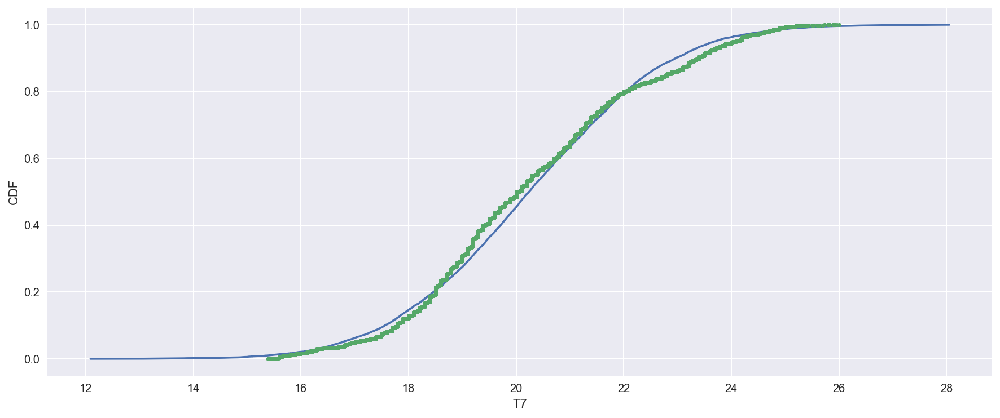

In [236]:
mean = np.mean(phase1['T7'])
std = np.std(phase1['T7'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['T7'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T7')
_=plt.ylabel('CDF')
plt.show()

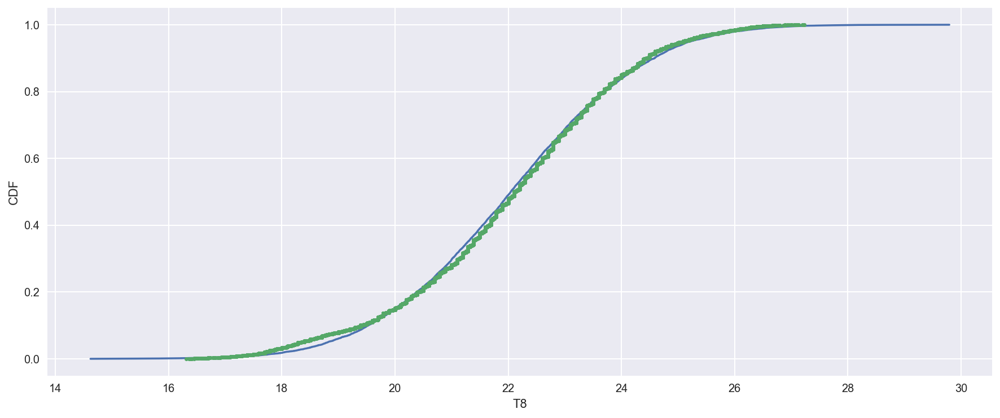

In [237]:
mean = np.mean(phase1['T8'])
std = np.std(phase1['T8'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['T8'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T8')
_=plt.ylabel('CDF')
plt.show()

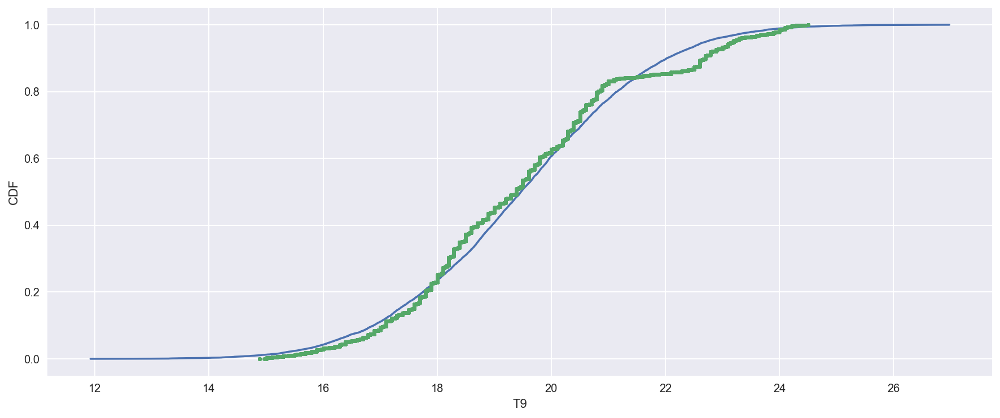

In [238]:
mean = np.mean(phase1['T9'])
std = np.std(phase1['T9'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['T9'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T9')
_=plt.ylabel('CDF')
plt.show()

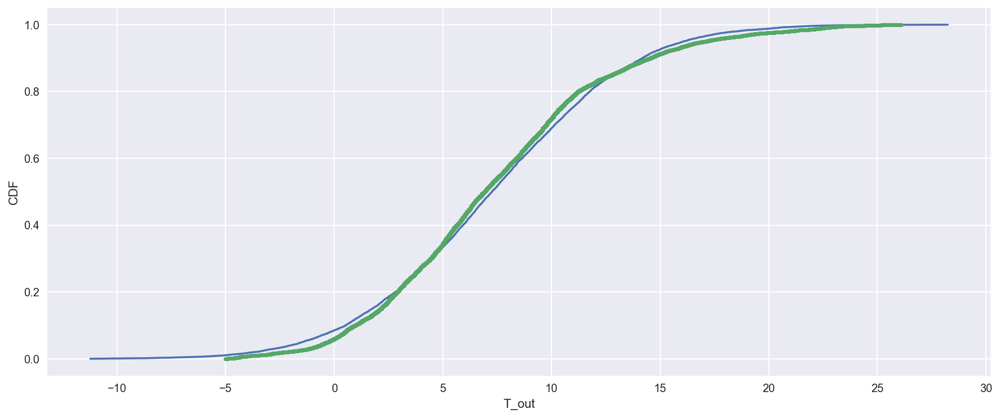

In [239]:
mean = np.mean(phase1['T_out'])
std = np.std(phase1['T_out'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['T_out'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('T_out')
_=plt.ylabel('CDF')
plt.show()

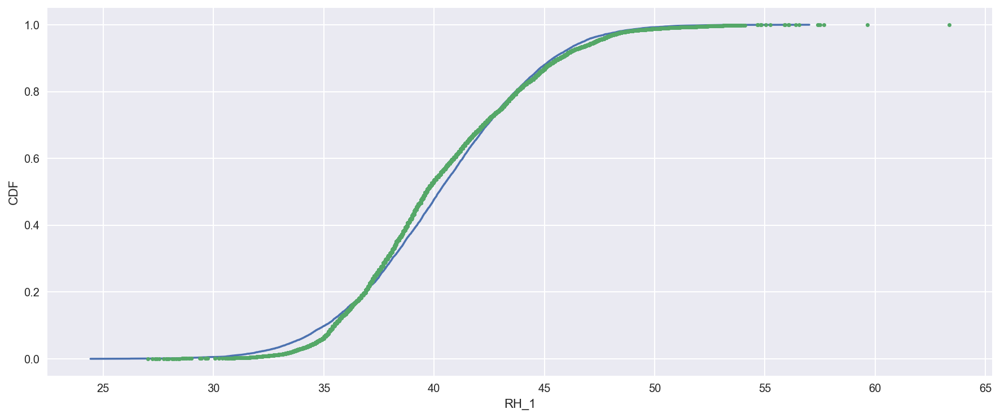

In [240]:
mean = np.mean(phase1['RH_1'])
std = np.std(phase1['RH_1'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['RH_1'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_1')
_=plt.ylabel('CDF')
plt.show()

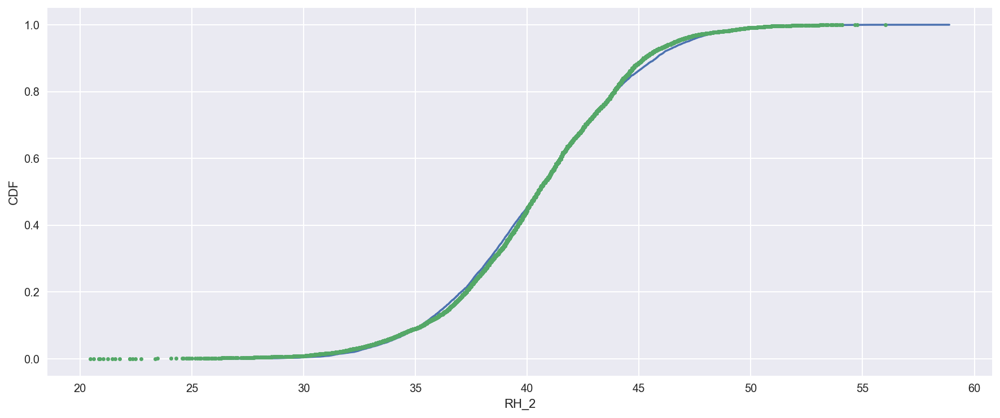

In [241]:
mean = np.mean(phase1['RH_2'])
std = np.std(phase1['RH_2'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['RH_2'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_2')
_=plt.ylabel('CDF')
plt.show()

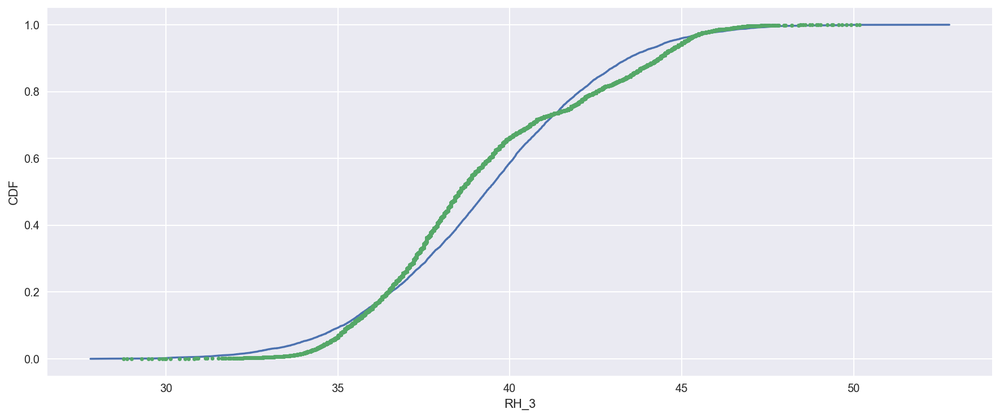

In [242]:
mean = np.mean(phase1['RH_3'])
std = np.std(phase1['RH_3'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['RH_3'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_3')
_=plt.ylabel('CDF')
plt.show()

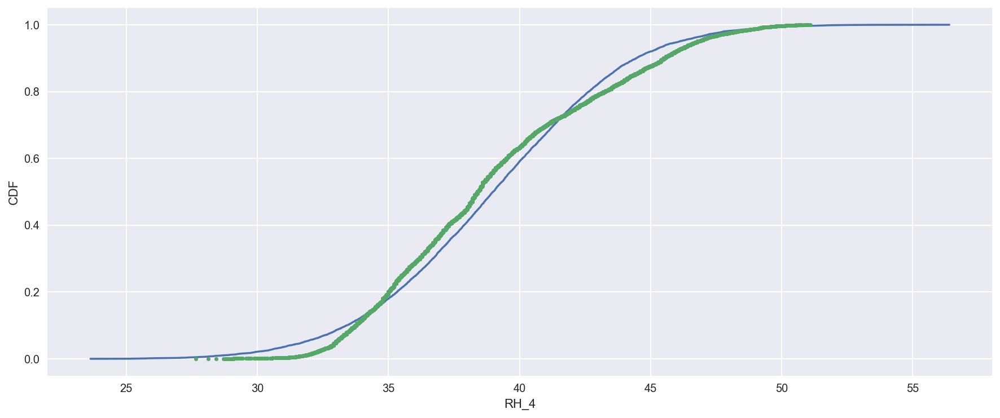

In [243]:
mean = np.mean(phase1['RH_4'])
std = np.std(phase1['RH_4'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['RH_4'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_4')
_=plt.ylabel('CDF')
plt.show()

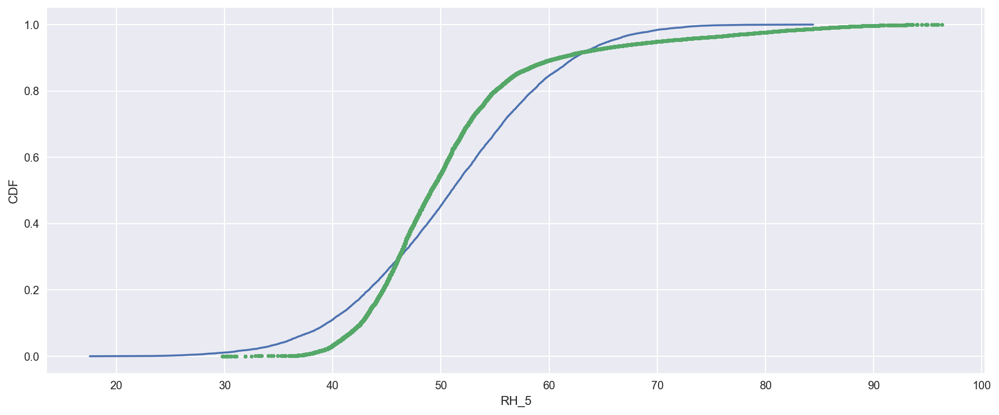

In [244]:
mean = np.mean(phase1['RH_5'])
std = np.std(phase1['RH_5'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['RH_5'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_5')
_=plt.ylabel('CDF')
plt.show()

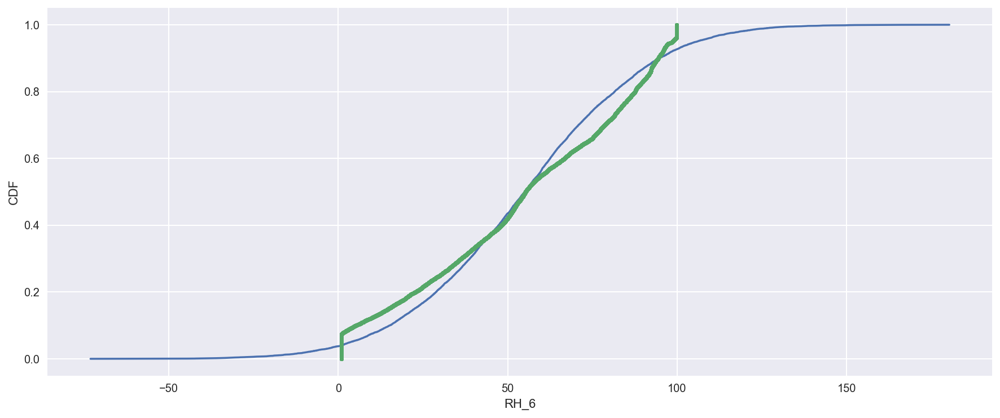

In [245]:
mean = np.mean(phase1['RH_6'])
std = np.std(phase1['RH_6'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['RH_6'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_6')
_=plt.ylabel('CDF')
plt.show()

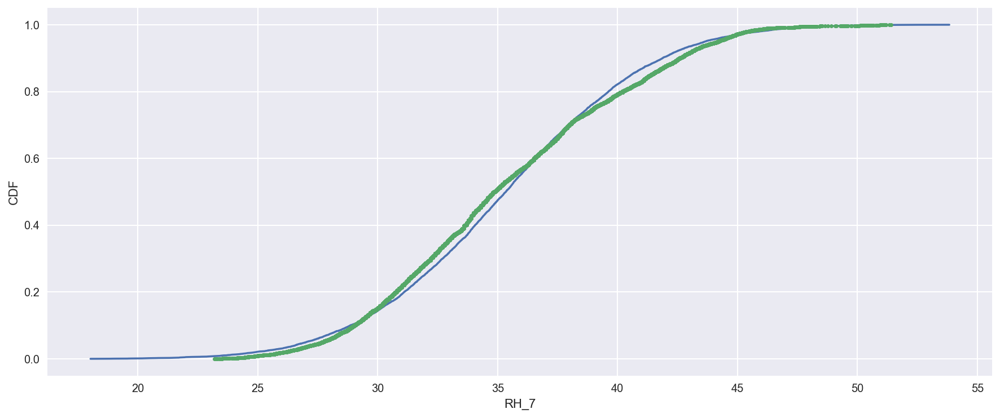

In [246]:
mean = np.mean(phase1['RH_7'])
std = np.std(phase1['RH_7'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['RH_7'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_7')
_=plt.ylabel('CDF')
plt.show()

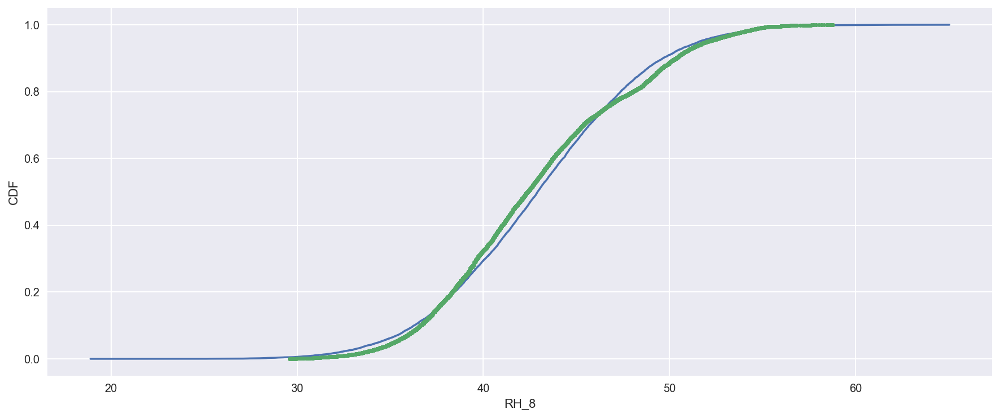

In [247]:
mean = np.mean(phase1['RH_8'])
std = np.std(phase1['RH_8'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['RH_8'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_8')
_=plt.ylabel('CDF')
plt.show()

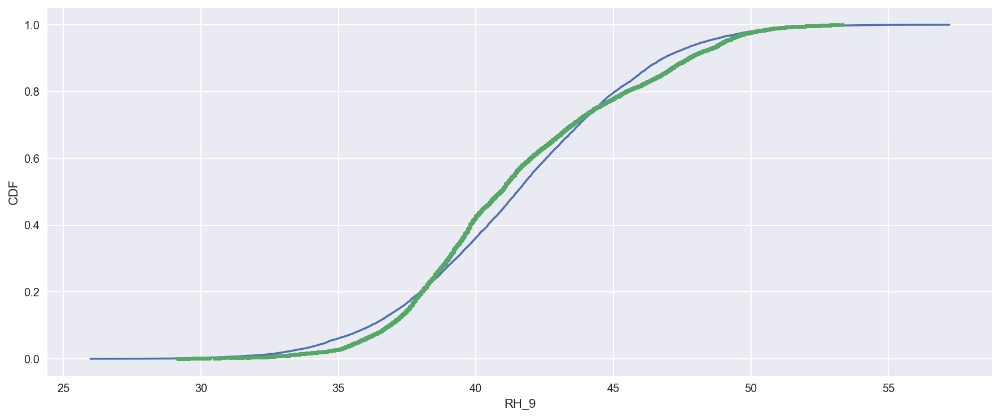

In [248]:
mean = np.mean(phase1['RH_9'])
std = np.std(phase1['RH_9'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['RH_9'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_9')
_=plt.ylabel('CDF')
plt.show()

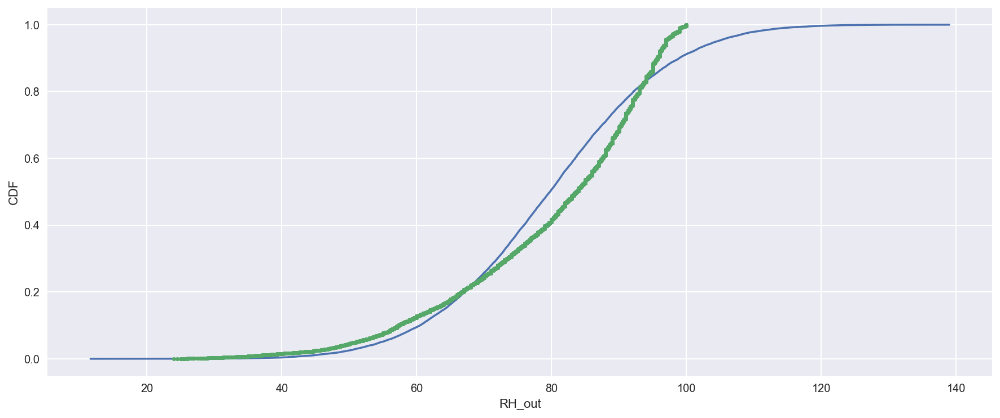

In [269]:
mean = np.mean(phase1['RH_out'])
std = np.std(phase1['RH_out'])
samples = np.random.normal(mean,std,size = 19735)
x,y = ecdf(phase1['RH_out'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('RH_out')
_=plt.ylabel('CDF')
plt.show()

In [263]:
phase1.dtypes

month            int64
day_of_week      int64
hour             int64
day_number       int64
Appliances     float64
T1             float64
RH_1           float64
T2             float64
RH_2           float64
T3             float64
RH_3           float64
T4             float64
RH_4           float64
T5             float64
RH_5           float64
T6             float64
RH_6           float64
T7             float64
RH_7           float64
T8             float64
RH_8           float64
T9             float64
RH_9           float64
T_out          float64
Press_mm_hg    float64
RH_out         float64
Windspeed      float64
Visibility     float64
Tdewpoint      float64
Week_no          int64
dtype: object

In [266]:
phase1.shape

(19735, 30)

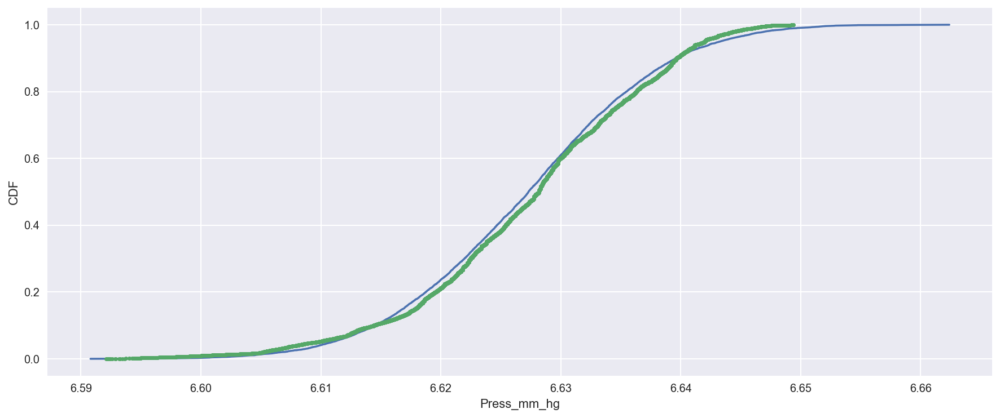

In [264]:
mean = np.mean(phase1['Press_mm_hg'])
std = np.std(phase1['Press_mm_hg'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['Press_mm_hg'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('Press_mm_hg')
_=plt.ylabel('CDF')
plt.show()

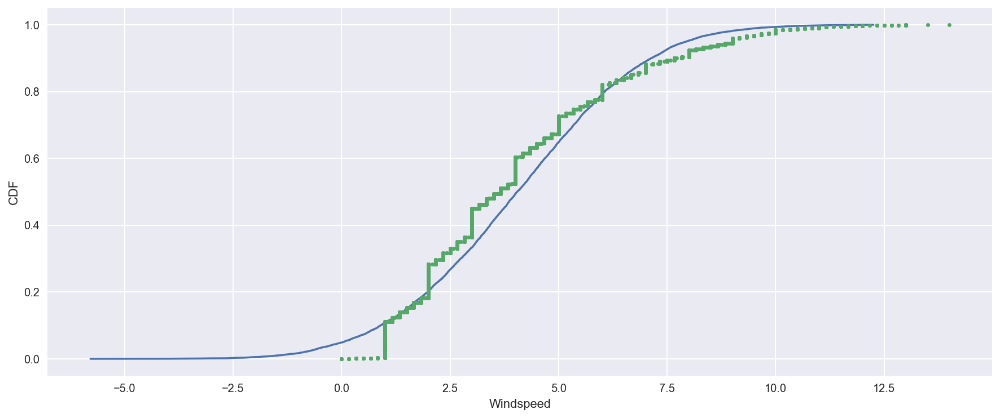

In [253]:
mean = np.mean(phase1['Windspeed'])
std = np.std(phase1['Windspeed'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['Windspeed'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('Windspeed')
_=plt.ylabel('CDF')
plt.show()

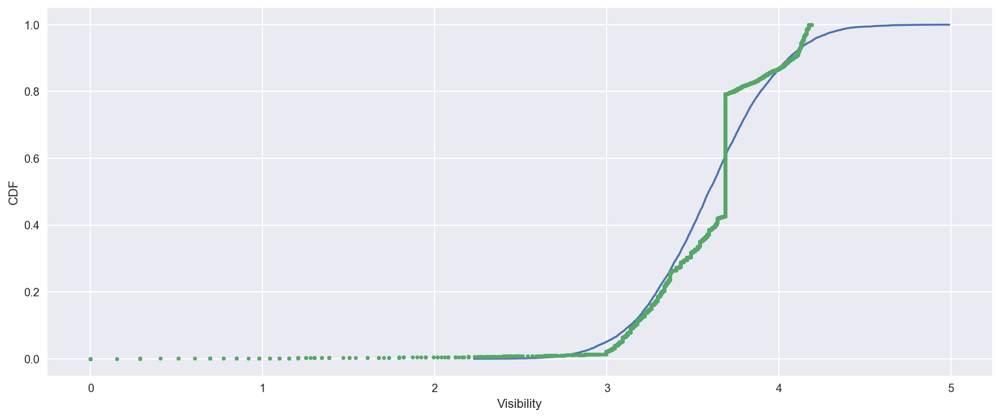

In [254]:
mean = np.mean(phase1['Visibility'])
std = np.std(phase1['Visibility'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['Visibility'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('Visibility')
_=plt.ylabel('CDF')
plt.show()

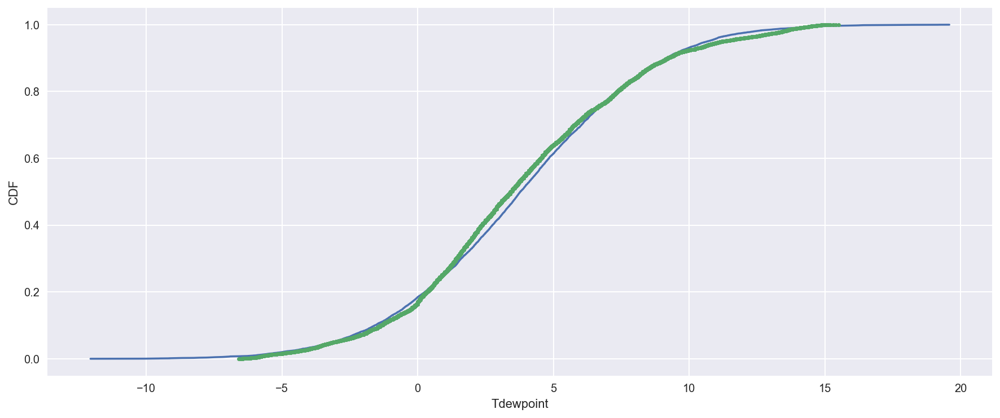

In [255]:
mean = np.mean(phase1['Tdewpoint'])
std = np.std(phase1['Tdewpoint'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['Tdewpoint'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('Tdewpoint')
_=plt.ylabel('CDF')
plt.show()

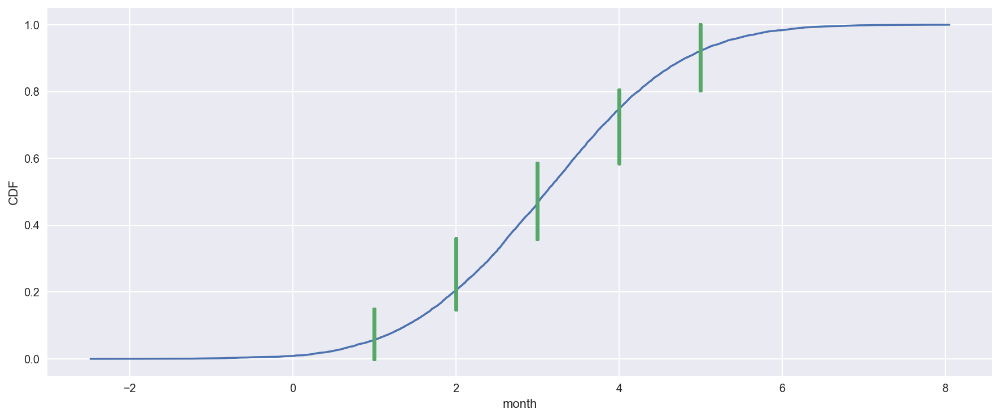

In [256]:
mean = np.mean(phase1['month'])
std = np.std(phase1['month'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['month'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('month')
_=plt.ylabel('CDF')
plt.show()

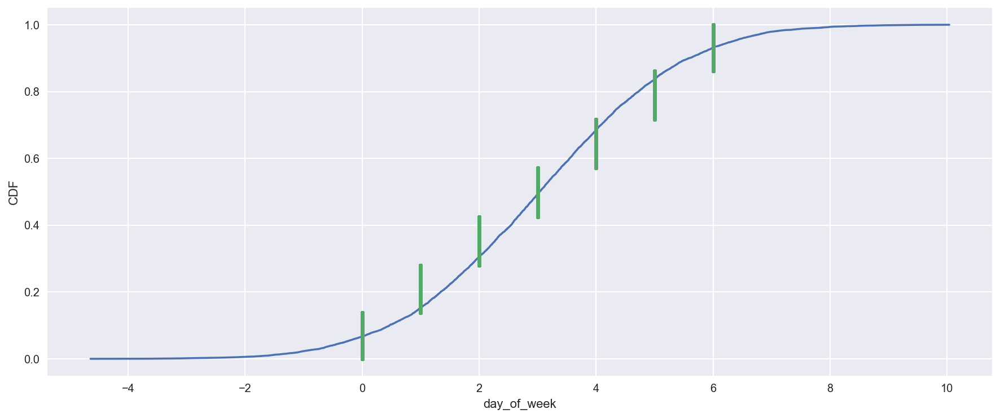

In [257]:
mean = np.mean(phase1['day_of_week'])
std = np.std(phase1['day_of_week'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['day_of_week'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('day_of_week')
_=plt.ylabel('CDF')
plt.show()

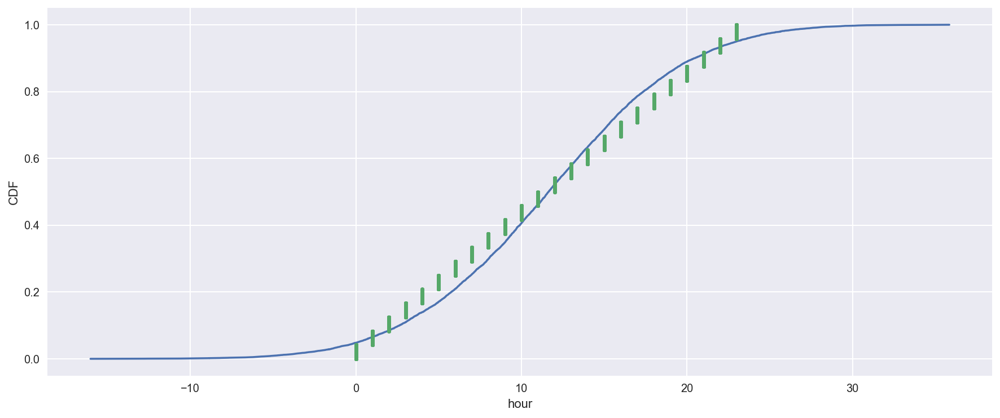

In [258]:
mean = np.mean(phase1['hour'])
std = np.std(phase1['hour'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['hour'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('hour')
_=plt.ylabel('CDF')
plt.show()

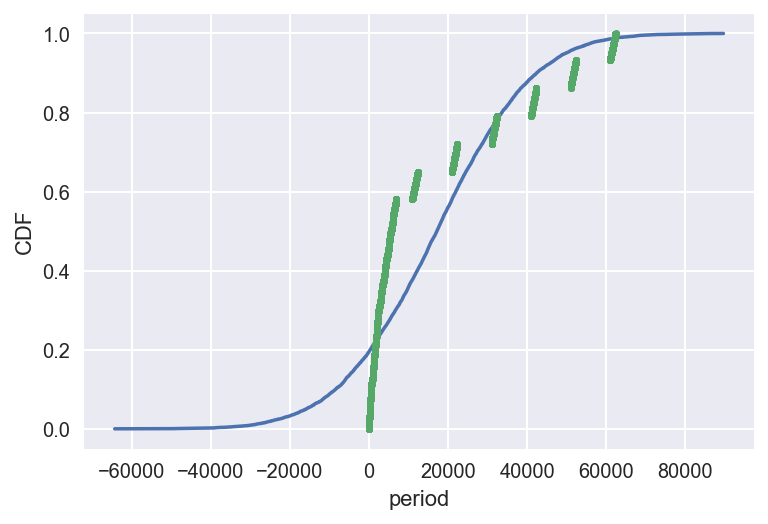

In [77]:
mean = np.mean(phase['period'])
std = np.std(phase['period'])
samples = np.random.normal(mean,std,size = 10000)
x,y = ecdf(phase['period'])
x_theor,y_theor = ecdf(samples)
sns.set()
_=plt.plot(x_theor,y_theor)
_ = plt.plot(x,y,marker='.',linestyle='none')
_=plt.xlabel('period')
_=plt.ylabel('CDF')
plt.show()

# PCA

In [47]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
%matplotlib inline

In [305]:
phase1.head()

,month,day_of_week,hour,day_number,Appliances,T1,RH_1,T2,RH_2,T3,...,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,Week_no
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,1,1,17,11,4.094345,19.89,47.596667,19.2,44.790000,19.79,...,48.900000,17.033333,45.53,6.600000,6.597828,92.0,7.000000,4.143135,5.3,2
2016-01-11 17:10:00,1,1,17,11,4.094345,19.89,46.693333,19.2,44.722500,19.79,...,48.863333,17.066667,45.56,6.483333,6.597964,92.0,6.666667,4.080358,5.2,2
2016-01-11 17:20:00,1,1,17,11,3.912023,19.89,46.300000,19.2,44.626667,19.79,...,48.730000,17.000000,45.50,6.366667,6.598100,92.0,6.333333,4.013375,5.1,2
2016-01-11 17:30:00,1,1,17,11,3.912023,19.89,46.066667,19.2,44.590000,19.79,...,48.590000,17.000000,45.40,6.250000,6.598237,92.0,6.000000,3.941582,5.0,2
2016-01-11 17:40:00,1,1,17,11,4.094345,19.89,46.333333,19.2,44.530000,19.79,...,48.590000,17.000000,45.40,6.133333,6.598373,92.0,5.666667,3.864232,4.9,2


In [363]:
features = ['month','day_of_week','hour','day_number','T1','T2','T3','T4','T5','T6','T7','T8','T9','T_out','RH_1','RH_2','RH_3','RH_4','RH_5','RH_6','RH_7','RH_8','RH_9','RH_out','Press_mm_hg','Visibility','Windspeed','Tdewpoint','Week_no']

In [48]:
features = ['month','day_number','period','T1','T2','T3','T4','T5','T6','T7','T8','T9','T_out','RH_1','RH_2','RH_3','RH_4','RH_5','RH_6','RH_7','RH_8','RH_9','RH_out','Press_mm_hg','Visibility','Windspeed','Tdewpoint','Week_no']

In [49]:
x = phase.loc[:, features].values

In [50]:
y = phase['Appliances']

In [39]:
y.shape

(19735,)

In [40]:
phase

,month,day_number,datetime,period,Appliances,lights,T1,RH_1,T2,RH_2,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Week_no,Total
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,1,11,2016-01-11 17:00:00,1170,60,30,19.890000,47.596667,19.200000,44.790000,...,6.600000,733.500000,92.000000,7.000000,63.000000,5.300000,13.275433,13.275433,2,90
2016-01-11 17:10:00,1,11,2016-01-11 17:10:00,11710,60,30,19.890000,46.693333,19.200000,44.722500,...,6.483333,733.600000,92.000000,6.666667,59.166667,5.200000,18.606195,18.606195,2,90
2016-01-11 17:20:00,1,11,2016-01-11 17:20:00,11720,50,30,19.890000,46.300000,19.200000,44.626667,...,6.366667,733.700000,92.000000,6.333333,55.333333,5.100000,28.642668,28.642668,2,80
2016-01-11 17:30:00,1,11,2016-01-11 17:30:00,11730,50,40,19.890000,46.066667,19.200000,44.590000,...,6.250000,733.800000,92.000000,6.000000,51.500000,5.000000,45.410389,45.410389,2,90
2016-01-11 17:40:00,1,11,2016-01-11 17:40:00,11740,60,40,19.890000,46.333333,19.200000,44.530000,...,6.133333,733.900000,92.000000,5.666667,47.666667,4.900000,10.084097,10.084097,2,100
2016-01-11 17:50:00,1,11,2016-01-11 17:50:00,11750,50,40,19.890000,46.026667,19.200000,44.500000,...,6.016667,734.000000,92.000000,5.333333,43.833333,4.800000,44.919484,44.919484,2,90
2016-01-11 18:00:00,1,11,2016-01-11 18:00:00,1180,60,50,19.890000,45.766667,19.200000,44.500000,...,5.900000,734.100000,92.000000,5.000000,40.000000,4.700000,47.233763,47.233763,2,110
2016-01-11 18:10:00,1,11,2016-01-11 18:10:00,11810,60,50,19.856667,45.560000,19.200000,44.500000,...,5.916667,734.166667,91.833333,5.166667,40.000000,4.683333,33.039890,33.039890,2,110
2016-01-11 18:20:00,1,11,2016-01-11 18:20:00,11820,60,40,19.790000,45.597500,19.200000,44.433333,...,5.933333,734.233333,91.666667,5.333333,40.000000,4.666667,31.455702,31.455702,2,100


In [309]:
x = StandardScaler().fit_transform(x)


In [310]:
pd.DataFrame(data = x, columns = features).head()


,month,day_of_week,hour,day_number,T1,T2,T3,T4,T5,T6,...,RH_6,RH_7,RH_8,RH_9,RH_out,Press_mm_hg,Visibility,Windspeed,Tdewpoint,Week_no
0,-1.569369,-1.01268,0.794304,-0.598455,-1.118645,-0.520411,-1.235063,-0.908217,-1.314903,-0.145196,...,0.951798,1.219861,1.141572,0.958136,0.82208,-2.976328,2.091596,1.207694,0.366975,-1.660283
1,-1.569369,-1.01268,0.794304,-0.598455,-1.118645,-0.520411,-1.235063,-0.908217,-1.314903,-0.176941,...,0.945592,1.206825,1.134554,0.965363,0.82208,-2.962813,1.766584,1.071703,0.343135,-1.660283
2,-1.569369,-1.01268,0.794304,-0.598455,-1.118645,-0.520411,-1.235063,-0.944115,-1.314903,-0.221822,...,0.916484,1.182057,1.109032,0.950910,0.82208,-2.949298,1.441572,0.935713,0.319294,-1.660283
3,-1.569369,-1.01268,0.794304,-0.598455,-1.118645,-0.520411,-1.235063,-0.962063,-1.314903,-0.242621,...,0.925045,1.154030,1.082233,0.926821,0.82208,-2.935783,1.116559,0.799723,0.295454,-1.660283
4,-1.569369,-1.01268,0.794304,-0.598455,-1.118645,-0.520411,-1.235063,-0.962063,-1.296832,-0.253567,...,0.972238,1.142298,1.082233,0.926821,0.82208,-2.922268,0.791547,0.663733,0.271613,-1.660283


In [311]:
pca = PCA(n_components=6)

In [312]:
principalComponents = pca.fit_transform(x)


In [299]:
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2','principal component 3','principal component 4])


In [300]:
principalDf.head(5)

,principal component 1,principal component 2,principal component 3
0,-4.010472,4.251601,1.165049
1,-4.015415,4.178479,1.103335
2,-4.038891,4.087696,1.026134
3,-4.069347,4.009537,0.974172
4,-4.059739,3.989092,0.920702


In [301]:
phase1[['hour']].head()

,hour
date,
2016-01-11 17:00:00,17
2016-01-11 17:10:00,17
2016-01-11 17:20:00,17
2016-01-11 17:30:00,17
2016-01-11 17:40:00,17


In [302]:
finalDf = pd.concat([principalDf, phase1[['hour']]], axis = 1)
finalDf.head(5)

,principal component 1,principal component 2,principal component 3,hour
0,-4.010472,4.251601,1.165049,NaN
1,-4.015415,4.178479,1.103335,NaN
2,-4.038891,4.087696,1.026134,NaN
3,-4.069347,4.009537,0.974172,NaN
4,-4.059739,3.989092,0.920702,NaN


# PCA + Logistic Regression

In [51]:
x.shape

(19735, 28)

In [52]:
y.shape

(19735,)

In [56]:
train_img, test_img, train_lbl, test_lbl = train_test_split(
    x,y, test_size=0.25, random_state=0)

In [57]:
print(train_img.shape)


(14801, 28)


In [58]:
print(train_lbl.shape)

(14801,)


In [59]:
print(test_img.shape)

(4934, 28)


In [60]:
print(test_lbl.shape)

(4934,)


In [407]:
train_img

array([[   3.        ,    1.        ,   10.        , ...,  761.71666667,
           4.53333333,   12.        ],
       [   5.        ,    1.        ,    2.        , ...,  752.83333333,
          10.23333333,   21.        ],
       [   5.        ,    5.        ,    5.        , ...,  757.38333333,
           9.46666667,   20.        ],
       ..., 
       [   3.        ,    0.        ,    1.        , ...,  762.3       ,
           2.15      ,   11.        ],
       [   3.        ,    6.        ,   16.        , ...,  752.05      ,
           8.36666667,   12.        ],
       [   1.        ,    6.        ,   16.        , ...,  752.43333333,
           3.23333333,    4.        ]])

In [61]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

# Fit on training set only.
scaler.fit(train_img)

# Apply transform to both the training set and the test set.
train_img = scaler.transform(train_img)
test_img = scaler.transform(test_img)

In [62]:
from sklearn.decomposition import PCA

In [63]:
pca = PCA(.99)

In [64]:
pca.fit(train_img)

PCA(copy=True, iterated_power='auto', n_components=0.99, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

In [65]:
train_img = pca.transform(train_img)
test_img = pca.transform(test_img)

In [66]:
from sklearn.linear_model import LogisticRegression

In [67]:
logisticRegr = LogisticRegression(solver = 'lbfgs')

In [68]:
logisticRegr.fit(train_img, train_lbl)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='lbfgs', tol=0.0001,
          verbose=0, warm_start=False)

In [69]:
logisticRegr.predict(test_img[0].reshape(1,-1))

array([300], dtype=int64)

In [70]:
logisticRegr.predict(test_img[0:10])

array([300,  50,  50,  50,  50,  90,  50,  50,  60,  50], dtype=int64)

In [71]:
score = logisticRegr.score(test_img, test_lbl)
print(score)

0.24341305229


In [146]:
mean = np.mean(phase1['Appliances'])
std = np.std(phase1['Appliances'])
samples = np. random.normal(mean,std,size = 10000)
x,y = ecdf(phase1['Appliances'])



In [175]:
def successive_poisson(tau1, tau2, size=1):
    # Draw samples out of first exponential distribution: t1
    t1 = np.random.exponential(tau1, size)

    # Draw samples out of second exponential distribution: t2
    t2 = np.random.exponential(tau2,size)

    return t1 + t2

In [ ]:
# Draw samples of waiting times
waiting_times = successive_poisson(764, 715, size=100000)

# Make the histogram
_ = plt.hist(waiting_times, bins=100, histtype='step',
             normed=True)

# Label axes
_ = plt.xlabel('total waiting time (games)')
_ = plt.ylabel('PDF')

# Show the plot
plt.show()


In [176]:
slope,intercept = np.polyfit(phase1['Appliances'],phase1['day_of_week'],1)


In [177]:
slope

0.00031585858340854524

In [178]:
intercept

2.9759321759616202

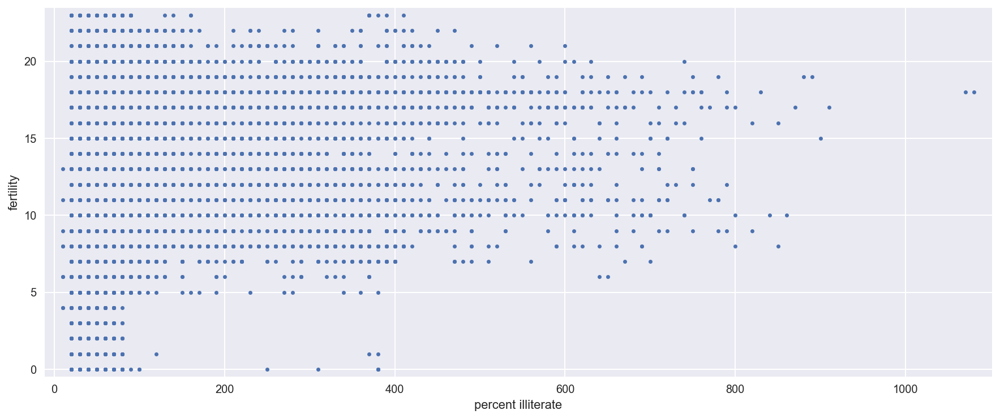

0.21679158849


In [181]:
# Plot the illiteracy rate versus fertility
_ = plt.plot(phase1['Appliances'],phase1['hour'], marker='.', linestyle='none')

# Set the margins and label axes
plt.margins(0.02)
_ = plt.xlabel('percent illiterate')
_ = plt.ylabel('fertility')

# Show the plot
plt.show()

# Show the Pearson correlation coefficient
print(pearson_r(phase1['Appliances'],phase1['hour']))

slope = 0.000315858583409 children per woman / percent illiterate
intercept = 2.97593217596 children per woman


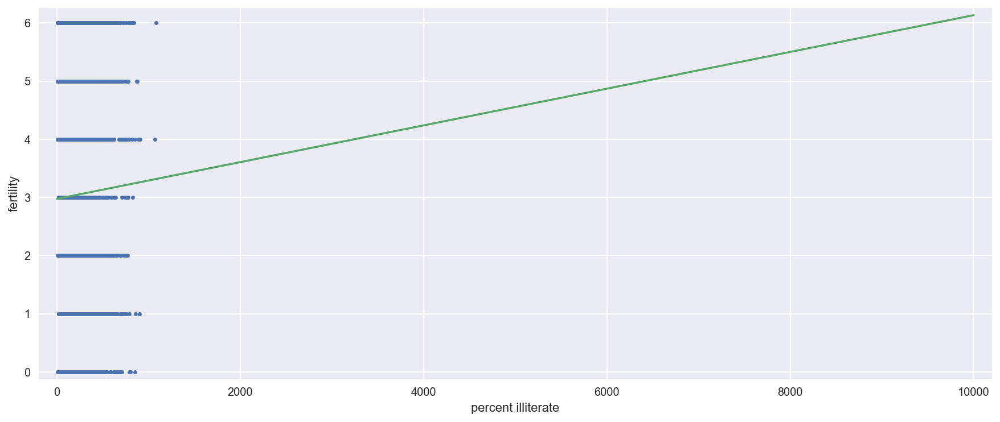

In [183]:
# Plot the illiteracy rate versus fertility
_ = plt.plot(phase1['Appliances'],phase1['day_of_week'], marker='.', linestyle='none')
plt.margins(0.02)
_ = plt.xlabel('percent illiterate')
_ = plt.ylabel('fertility')

# Perform a linear regression using np.polyfit(): a, b
a, b = np.polyfit(phase1['Appliances'],phase1['day_of_week'], 1)

# Print the results to the screen
print('slope =', a, 'children per woman / percent illiterate')
print('intercept =', b, 'children per woman')

# Make theoretical line to plot
x = np.array([0, 10000])
y = a * x + b

# Add regression line to your plot
_ = plt.plot(x, y)

# Draw the plot
plt.show()

In [184]:
from sklearn.preprocessing import StandardScaler
X_std = StandardScaler().fit_transform(phase1)

In [188]:
import numpy as np
mean_vec = np.mean(X_std, axis=0)
cov_mat = (X_std - mean_vec).T.dot((X_std - mean_vec)) / (X_std.shape[0]-1)
print('Covariance matrix \n%s' %cov_mat)

Covariance matrix 
[[  1.00005067e+00  -7.97448325e-03  -7.39665371e-03  -2.04545748e-01
   -1.16064281e-02   7.06340768e-01  -9.40529850e-02   5.33505981e-01
   -9.79185356e-02   7.90404594e-01  -4.14379771e-01   7.89207494e-01
   -2.58180528e-01   7.85905049e-01  -2.27523768e-01   6.04898183e-01
   -8.14403997e-01   8.33047274e-01  -1.67750958e-01   7.89405939e-01
   -2.75284035e-01   8.90649991e-01  -2.27047591e-01   5.95780910e-01
   -6.21813139e-02  -3.40498270e-01  -2.60350611e-01  -9.53941991e-02
    4.70656755e-01   9.77434542e-01]
 [ -7.97448325e-03   1.00005067e+00  -4.98466284e-03   4.37981632e-02
    1.63419269e-02  -4.26881373e-02  -4.77549597e-02  -2.84056011e-02
   -3.91035918e-02  -1.94949334e-02  -6.75255713e-02  -6.27733266e-02
   -3.48334080e-02  -5.26188134e-02  -4.08843094e-02   1.54149624e-02
   -3.64705639e-03  -4.80829197e-02  -3.94659752e-02  -8.80262970e-02
    8.01677538e-05  -3.31919166e-02  -4.96309251e-02   4.02910257e-03
   -1.77440038e-02  -6.61817788e-0

In [189]:
print('NumPy covariance matrix: \n%s' %np.cov(X_std.T))


NumPy covariance matrix: 
[[  1.00005067e+00  -7.97448325e-03  -7.39665371e-03  -2.04545748e-01
   -1.16064281e-02   7.06340768e-01  -9.40529850e-02   5.33505981e-01
   -9.79185356e-02   7.90404594e-01  -4.14379771e-01   7.89207494e-01
   -2.58180528e-01   7.85905049e-01  -2.27523768e-01   6.04898183e-01
   -8.14403997e-01   8.33047274e-01  -1.67750958e-01   7.89405939e-01
   -2.75284035e-01   8.90649991e-01  -2.27047591e-01   5.95780910e-01
   -6.21813139e-02  -3.40498270e-01  -2.60350611e-01  -9.53941991e-02
    4.70656755e-01   9.77434542e-01]
 [ -7.97448325e-03   1.00005067e+00  -4.98466284e-03   4.37981632e-02
    1.63419269e-02  -4.26881373e-02  -4.77549597e-02  -2.84056011e-02
   -3.91035918e-02  -1.94949334e-02  -6.75255713e-02  -6.27733266e-02
   -3.48334080e-02  -5.26188134e-02  -4.08843094e-02   1.54149624e-02
   -3.64705639e-03  -4.80829197e-02  -3.94659752e-02  -8.80262970e-02
    8.01677538e-05  -3.31919166e-02  -4.96309251e-02   4.02910257e-03
   -1.77440038e-02  -6.6181

In [190]:
cov_mat = np.cov(X_std.T)

eig_vals, eig_vecs = np.linalg.eig(cov_mat)

print('Eigenvectors \n%s' %eig_vecs)
print('\nEigenvalues \n%s' %eig_vals)

Eigenvectors 
[[  2.70175609e-01  -7.51118281e-02   1.70861956e-01  -3.91739890e-02
   -1.01560223e-01   2.90013501e-02  -4.94464742e-02  -1.04112720e-02
    6.90908507e-02   1.07481232e-01   2.67625759e-01   1.06851387e-02
    1.07657638e-01   1.54063564e-01  -2.38850176e-01   1.04017713e-01
    4.74360474e-02  -1.43795246e-01   4.95344996e-02  -1.40142218e-02
    7.11991549e-01  -1.08038817e-02  -1.80609080e-01   4.09705305e-02
    3.32442483e-01   6.29301497e-03   6.31285438e-02   1.57910823e-02
   -5.48313840e-02   3.07381012e-02]
 [ -9.52811070e-03  -1.69545081e-02  -2.04301434e-02  -2.47348506e-01
   -3.83483426e-02   6.92327631e-01  -2.83137273e-01   5.37279717e-01
   -1.79517437e-01  -9.24719556e-02  -4.10176440e-02  -1.93332212e-01
   -5.55675945e-02  -7.94290194e-03   8.62571210e-03  -1.85627006e-02
   -1.18168397e-02  -3.93405618e-02   1.75239095e-02  -8.04968291e-03
   -8.33894559e-03  -8.69638714e-04  -1.00011567e-02   2.96338947e-02
    1.32918201e-02  -1.69075748e-03   7

In [191]:
cor_mat1 = np.corrcoef(X_std.T)

eig_vals, eig_vecs = np.linalg.eig(cor_mat1)

print('Eigenvectors \n%s' %eig_vecs)
print('\nEigenvalues \n%s' %eig_vals)

Eigenvectors 
[[  2.70175609e-01  -7.51118281e-02   1.70861956e-01  -3.91739890e-02
   -1.01560223e-01   2.90013501e-02  -4.94464742e-02  -1.04112720e-02
    6.90908507e-02   1.07481232e-01   2.67625759e-01   1.06851387e-02
    1.07657638e-01   1.54063564e-01  -2.38850176e-01   1.04017713e-01
    4.74360474e-02  -1.43795246e-01   4.95344996e-02  -1.40142218e-02
    7.11991549e-01  -1.08038817e-02  -1.80609080e-01   4.09705305e-02
    3.32442483e-01   6.29301497e-03   6.31285438e-02   1.57910823e-02
   -5.48313840e-02   3.07381012e-02]
 [ -9.52811070e-03  -1.69545081e-02  -2.04301434e-02  -2.47348506e-01
   -3.83483426e-02   6.92327631e-01  -2.83137273e-01   5.37279717e-01
   -1.79517437e-01  -9.24719556e-02  -4.10176440e-02  -1.93332212e-01
   -5.55675945e-02  -7.94290194e-03   8.62571210e-03  -1.85627006e-02
   -1.18168397e-02  -3.93405618e-02   1.75239095e-02  -8.04968291e-03
   -8.33894559e-03  -8.69638714e-04  -1.00011567e-02   2.96338947e-02
    1.32918201e-02  -1.69075748e-03   7

In [192]:

cor_mat2 = np.corrcoef(X.T)

eig_vals, eig_vecs = np.linalg.eig(cor_mat2)

print('Eigenvectors \n%s' %eig_vecs)
print('\nEigenvalues \n%s' %eig_vals)

Eigenvectors 
[[  2.70397155e-01  -7.52439764e-02  -1.70765021e-01  -3.98204730e-02
    1.23925703e-01   2.82410020e-02   1.45548100e-02  -2.14479699e-02
   -1.04305698e-01   2.73739447e-01  -8.43971928e-03  -1.01235311e-01
   -1.52023868e-01   2.17557603e-01  -1.47338972e-01   4.83367121e-02
    1.43824514e-01  -4.77972238e-02  -1.20634675e-02   1.66620241e-01
   -8.11541995e-02   3.29937607e-01  -7.12096297e-01  -1.02082796e-02
    4.82093786e-03   6.48210529e-02  -1.90792652e-02  -5.29487132e-02
   -4.61426502e-02]
 [ -9.57288377e-03  -1.69390246e-02   1.98408355e-02  -2.82342439e-01
    2.46260001e-01  -6.09318692e-01   6.50622984e-01   1.65257141e-02
    1.27390977e-01  -4.70940105e-02   1.93610921e-01   5.04808371e-02
    1.08551840e-02  -3.40848939e-03   2.09653332e-02  -1.15211350e-02
    3.93775526e-02  -1.72570203e-02  -7.53544492e-03   8.07928795e-03
   -3.10474896e-02   9.84919726e-03   8.37017215e-03  -9.38121695e-04
   -1.16950056e-03   2.55191852e-04   3.45300424e-04  -6

In [193]:
u,s,v = np.linalg.svd(X_std.T)
u

array([[ -2.70175609e-01,  -7.51118281e-02,  -1.70861956e-01,
          3.91739890e-02,  -1.01560223e-01,   2.90013501e-02,
         -4.94464742e-02,  -1.04112720e-02,   6.90908507e-02,
         -1.07481232e-01,   2.67625759e-01,  -1.06851387e-02,
          1.07657638e-01,   1.54063564e-01,  -2.38850176e-01,
         -1.04017713e-01,   4.74360474e-02,   1.43795246e-01,
          4.95344996e-02,   1.40142218e-02,   1.80609080e-01,
          4.09705305e-02,  -3.32442483e-01,  -5.48313840e-02,
         -3.07381012e-02,   1.57910823e-02,   6.31285438e-02,
          6.29301497e-03,   1.08038817e-02,   7.11991549e-01],
       [  9.52811070e-03,  -1.69545081e-02,   2.04301434e-02,
          2.47348506e-01,  -3.83483426e-02,   6.92327631e-01,
         -2.83137273e-01,   5.37279717e-01,  -1.79517437e-01,
          9.24719556e-02,  -4.10176440e-02,   1.93332212e-01,
         -5.55675945e-02,  -7.94290194e-03,   8.62571210e-03,
          1.85627006e-02,  -1.18168397e-02,   3.93405618e-02,
       

In [194]:
for ev in eig_vecs:
    np.testing.assert_array_almost_equal(1.0, np.linalg.norm(ev))
print('Everything ok!')

Everything ok!


In [195]:
# Make a list of (eigenvalue, eigenvector) tuples
eig_pairs = [(np.abs(eig_vals[i]), eig_vecs[:,i]) for i in range(len(eig_vals))]

# Sort the (eigenvalue, eigenvector) tuples from high to low
eig_pairs.sort()
eig_pairs.reverse()

# Visually confirm that the list is correctly sorted by decreasing eigenvalues
print('Eigenvalues in descending order:')
for i in eig_pairs:
    print(i[0])

Eigenvalues in descending order:
10.804722893
7.21574232136
2.1046704352
1.23367925095
1.09778740622
1.03553626109
0.975176301956
0.933702413281
0.764646383982
0.616770631242
0.49177261956
0.380222945929
0.211679205936
0.163196712443
0.154851219655
0.135630604879
0.123162211349
0.113470420406
0.0887496698247
0.0740215500231
0.066428801146
0.0606193579437
0.0434077519276
0.0425906077354
0.0273750196297
0.0214541963566
0.0143636910218
0.00353279210625
0.00103632386284


In [200]:
import plotly
plotly.offline.init_notebook_mode(connected=True)
import plotly.offline as py
from plotly.graph_objs import *
import plotly.tools as tls
tot = sum(eig_vals)
var_exp = [(i / tot)*100 for i in sorted(eig_vals, reverse=True)]
cum_var_exp = np.cumsum(var_exp)

trace1 = Bar(
        x=['PC %s' %i for i in range(1,5)],
        y=var_exp,
        showlegend=False)
trace2 = Scatter(
        x=['PC %s' %i for i in range(1,5)], 
        y=cum_var_exp,
        name='cumulative explained variance')

data = Data([trace1, trace2])

layout=Layout(
        yaxis=YAxis(title='Explained variance in percent'),
        title='Explained variance by different principal components')

fig = Figure(data=data, layout=layout)
py.iplot(fig)

In [207]:
matrix_w = np.hstack((eig_pairs[0][1].reshape(29,1), 
                      eig_pairs[1][1].reshape(29,1)))

print('Matrix W:\n', matrix_w)

Matrix W:
 [[ 0.27039716 -0.07524398]
 [-0.00957288 -0.01693902]
 [ 0.04402735 -0.0480123 ]
 [-0.03940738 -0.01480092]
 [ 0.27423568  0.04687611]
 [ 0.03170569  0.33774007]
 [ 0.24513561  0.07799719]
 [-0.020226    0.29502295]
 [ 0.27855089  0.06750334]
 [-0.05831736  0.34007883]
 [ 0.27936417  0.00478002]
 [-0.0099947   0.35730976]
 [ 0.27606307  0.05305118]
 [-0.04050652  0.14365371]
 [ 0.24425457  0.09100629]
 [-0.25132937  0.1503755 ]
 [ 0.28196117 -0.02868596]
 [ 0.00678259  0.3499799 ]
 [ 0.25991934 -0.04364136]
 [-0.04338064  0.33817595]
 [ 0.28915276  0.00676374]
 [-0.01358146  0.33757711]
 [ 0.24554502  0.10601474]
 [-0.04004353 -0.12136018]
 [-0.15015292  0.15269051]
 [-0.03381769  0.10279932]
 [-0.03454788  0.00154506]
 [ 0.18805985  0.24534431]
 [ 0.26804853 -0.07914554]]


In [205]:
Y = X_std.dot(matrix_w)

ValueError: shapes (19735,30) and (29,2) not aligned: 30 (dim 1) != 29 (dim 0)

In [208]:
from sklearn.decomposition import PCA as sklearnPCA
sklearn_pca = sklearnPCA(n_components=2)
Y_sklearn = sklearn_pca.fit_transform(X_std)

In [211]:

traces = []

for name in phase1['month']:

    trace = Scatter(
        x=Y_sklearn[y==name,1],
        y=Y_sklearn[y==name,2],
        mode='markers',
        name=name,
        marker=Marker(
            size=12,
            line=Line(
                color='rgba(217, 217, 217, 0.14)',
                width=0.5),
            opacity=0.8))
    traces.append(trace)


data = Data(traces)
layout = Layout(xaxis=XAxis(title='PC1', showline=False),
                yaxis=YAxis(title='PC2', showline=False))
fig = Figure(data=data, layout=layout)
py.iplot(fig)

IndexError: boolean index did not match indexed array along dimension 0; dimension is 19735 but corresponding boolean dimension is 2

In [82]:
phase1[['Appliances']]

NameError: name 'phase1' is not defined

In [99]:
import numpy as np
phase[['Appliances']]
print('mean',np.mean(phase[['Appliances']]))
print('median',np.median(phase[['Appliances']]))



mean Appliances    97.694958
dtype: float64
median 60.0


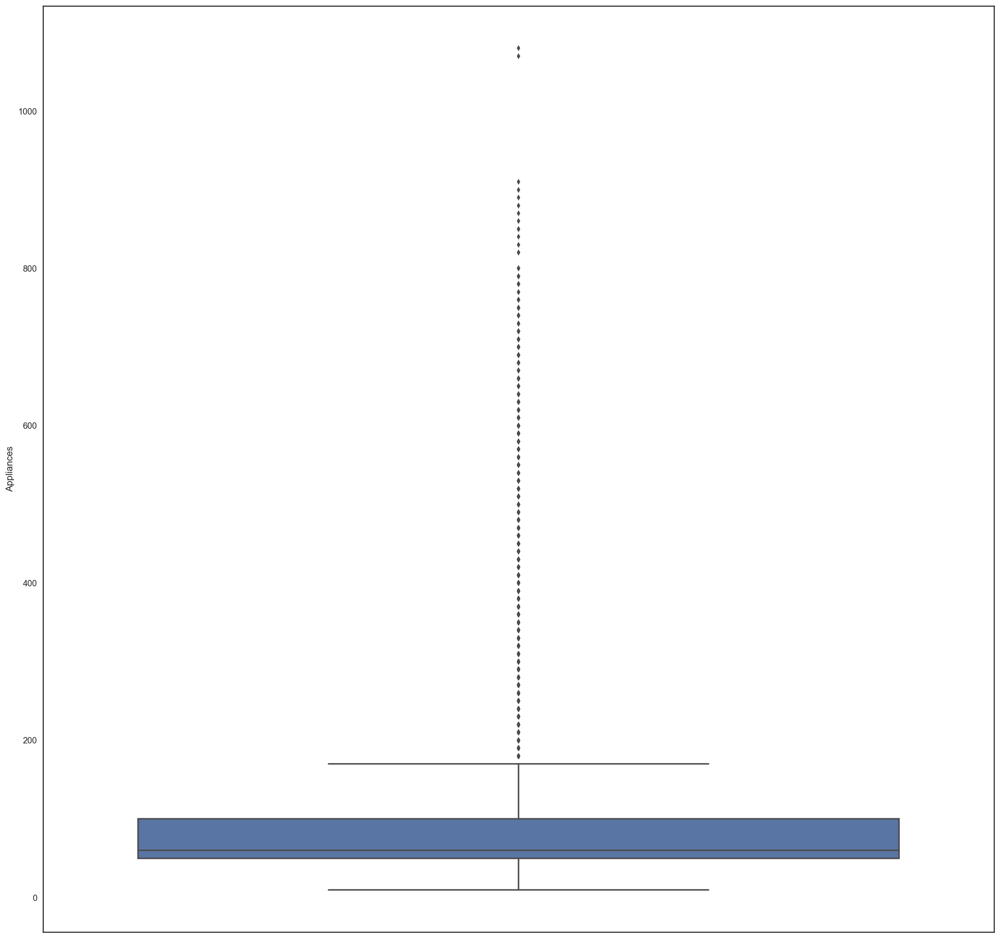

In [100]:
fig = plt.figure(1, figsize=(20, 20))
sns.set_style('white')
ax1 = sns.boxplot( y="Appliances", data=phase)